In [1]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

# Self-Driving Car Engineer Nanodegree


## Project: **Finding Lane Lines on the Road** 
***
In this project, you will use the tools you learned about in the lesson to identify lane lines on the road.  You can develop your pipeline on a series of individual images, and later apply the result to a video stream (really just a series of images). Check out the video clip "raw-lines-example.mp4" (also contained in this repository) to see what the output should look like after using the helper functions below. 

Once you have a result that looks roughly like "raw-lines-example.mp4", you'll need to get creative and try to average and/or extrapolate the line segments you've detected to map out the full extent of the lane lines.  You can see an example of the result you're going for in the video "P1_example.mp4".  Ultimately, you would like to draw just one line for the left side of the lane, and one for the right.

In addition to implementing code, there is a brief writeup to complete. The writeup should be completed in a separate file, which can be either a markdown file or a pdf document. There is a [write up template](https://github.com/udacity/CarND-LaneLines-P1/blob/master/writeup_template.md) that can be used to guide the writing process. Completing both the code in the Ipython notebook and the writeup template will cover all of the [rubric points](https://review.udacity.com/#!/rubrics/322/view) for this project.

---
Let's have a look at our first image called 'test_images/solidWhiteRight.jpg'.  Run the 2 cells below (hit Shift-Enter or the "play" button above) to display the image.

**Note: If, at any point, you encounter frozen display windows or other confounding issues, you can always start again with a clean slate by going to the "Kernel" menu above and selecting "Restart & Clear Output".**

---

**The tools you have are color selection, region of interest selection, grayscaling, Gaussian smoothing, Canny Edge Detection and Hough Tranform line detection.  You  are also free to explore and try other techniques that were not presented in the lesson.  Your goal is piece together a pipeline to detect the line segments in the image, then average/extrapolate them and draw them onto the image for display (as below).  Once you have a working pipeline, try it out on the video stream below.**

---

<figure>
 <img src="examples/line-segments-example.jpg" width="380" alt="Combined Image" />
 <figcaption>
 <p></p> 
 <p style="text-align: center;"> Your output should look something like this (above) after detecting line segments using the helper functions below </p> 
 </figcaption>
</figure>
 <p></p> 
<figure>
 <img src="examples/laneLines_thirdPass.jpg" width="380" alt="Combined Image" />
 <figcaption>
 <p></p> 
 <p style="text-align: center;"> Your goal is to connect/average/extrapolate line segments to get output like this</p> 
 </figcaption>
</figure>

**Run the cell below to import some packages.  If you get an `import error` for a package you've already installed, try changing your kernel (select the Kernel menu above --> Change Kernel).  Still have problems?  Try relaunching Jupyter Notebook from the terminal prompt.  Also, consult the forums for more troubleshooting tips.**  

## Import Packages

In [2]:
#importing some useful packages
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import cv2
%matplotlib inline

## Read in an Image

This image is: <class 'numpy.ndarray'> with dimensions: (540, 960, 3)


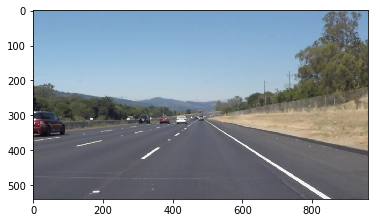

In [3]:
#reading in an image
image = mpimg.imread('test_images/solidWhiteRight.jpg')

#printing out some stats and plotting
print('This image is:', type(image), 'with dimensions:', image.shape)
plt.imshow(image)  # if you wanted to show a single color channel image called 'gray', for example, call as plt.imshow(gray, cmap='gray')

## Ideas for Lane Detection Pipeline

**Some OpenCV functions (beyond those introduced in the lesson) that might be useful for this project are:**

`cv2.inRange()` for color selection  
`cv2.fillPoly()` for regions selection  
`cv2.line()` to draw lines on an image given endpoints  
`cv2.addWeighted()` to coadd / overlay two images
`cv2.cvtColor()` to grayscale or change color
`cv2.imwrite()` to output images to file  
`cv2.bitwise_and()` to apply a mask to an image

**Check out the OpenCV documentation to learn about these and discover even more awesome functionality!**

## Helper Functions

Below are some helper functions to help get you started. They should look familiar from the lesson!

In [4]:
import math

def grayscale(img):
    """Applies the Grayscale transform
    This will return an image with only one color channel
    but NOTE: to see the returned image as grayscale
    (assuming your grayscaled image is called 'gray')
    you should call plt.imshow(gray, cmap='gray')"""
    return cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Or use BGR2GRAY if you read an image with cv2.imread()
    # return cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
def canny(img, low_threshold, high_threshold):
    """Applies the Canny transform"""
    return cv2.Canny(img, low_threshold, high_threshold)

def gaussian_blur(img, kernel_size):
    """Applies a Gaussian Noise kernel"""
    return cv2.GaussianBlur(img, (kernel_size, kernel_size), 0)

def region_of_interest(img, vertices):
    """
    Applies an image mask.
    
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    """
    #defining a blank mask to start with
    mask = np.zeros_like(img)
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image


def linestolanes(img, lines,color=[255,0,0],thickness=2):
    """
    NOTE: this is the function you might want to use as a starting point once you want to 
    average/extrapolate the line segments you detect to map out the full
    extent of the lane (going from the result shown in raw-lines-example.mp4
    to that shown in P1_example.mp4).  
    
    Think about things like separating line segments by their 
    slope ((y2-y1)/(x2-x1)) to decide which segments are part of the left
    line vs. the right line.  Then, you can average the position of each of 
    the lines and extrapolate to the top and bottom of the lane.
    
    This function draws `lines` with `color` and `thickness`.    
    Lines are drawn on the image inplace (mutates the image).
    If you want to make the lines semi-transparent, think about combining
    this function with the weighted_img() function below
    """
    # dy dx slope
    left = [] 
    left_dy = []
    right = []
    right_dy = []
    for line in lines:
        for x1,y1,x2,y2 in line:
            cv2.line(img, (x1,y1), (x2,y2), [0,255,0], 1)
            # y = (dy/dx)*x + b
            # dy indicates the weights of our lines since we are looking into lane direction
            dy = y2-y1
            dx = x2-x1
            if dx == 0 :
                continue # dx = 0 means div by 0 in slope
            m = dy/dx    
            b = y1 - m*x1
            # b = y1 - x1*lslope
            # Seperate the lines by the slope with a front camera looking into x axis
            #|-----------------------------------------> x
            #|        *              #
            #|
            #|    * LEFT Negative         # RIGHT Positive
            #|
            #|*                                # 
            #V
            #Y
            if m < 0:
                left.append((m,b))
                left_dy.append(dy)
            else: 
                right.append((m,b))
                right_dy.append(dy)
    
    llane = np.dot(left_dy, left) / np.sum(left_dy)
    rlane = np.dot(right_dy, right) / np.sum(right_dy)
    
    print(llane)
    print()
    print(rlane)
    print()
    ## Calcualte new Lane Lines
    y0 = img.shape[0] # Bottom
    y1 = int(y0*0.5) # Horizon
    x0l = int((y0 - llane[1])/llane[0])
    x1l = int((y1 - llane[1])/llane[0])
    x0r = int((y0 - rlane[1])/rlane[0])
    x1r = int((y1 - rlane[1])/rlane[0])
    cv2.line(img, (x0l,y0), (x1l,y1), color, 4)
    cv2.line(img, (x0r,y0), (x1r,y1), color, 4)
    return llane, rlane


def hough_lines(img, rho, theta, threshold, min_line_len, max_line_gap):
    """
    `img` should be the output of a Canny transform.
        
    Returns an image with hough lines drawn.
    """
    lines = cv2.HoughLinesP(img, rho, theta, threshold, np.array([]), minLineLength=min_line_len, maxLineGap=max_line_gap)
    line_img = np.zeros((img.shape[0], img.shape[1], 3), dtype=np.uint8)
    linestolanes(line_img, lines)
    return line_img

# Python 3 has support for cool math symbols.

def weighted_img(img, initial_img, α=0.8, β=1., λ=0.):
    """
    `img` is the output of the hough_lines(), An image with lines drawn on it.
    Should be a blank image (all black) with lines drawn on it.
    
    `initial_img` should be the image before any processing.
    
    The result image is computed as follows:
    
    initial_img * α + img * β + λ
    NOTE: initial_img and img must be the same shape!
    """
    return cv2.addWeighted(initial_img, α, img, β, λ)


## Test Images

Build your pipeline to work on the images in the directory "test_images"  
**You should make sure your pipeline works well on these images before you try the videos.**

In [5]:
import os
os.listdir("test_images/")

['whiteCarLaneSwitch.jpg',
 'solidWhiteCurve.jpg',
 'solidYellowLeft.jpg',
 'solidYellowCurve2.jpg',
 'solidWhiteRight.jpg',
 'solidYellowCurve.jpg']

## Build a Lane Finding Pipeline



Build the pipeline and run your solution on all test_images. Make copies into the `test_images_output` directory, and you can use the images in your writeup report.

Try tuning the various parameters, especially the low and high Canny thresholds as well as the Hough lines parameters.

[  -0.79659183  692.39213519]

[  0.57865935  33.65843095]

[  -0.78917329  687.29903026]

[  0.56452104  36.79250393]

[  -0.69321341  640.35747855]

[ 0.64925619 -7.70856545]

[  -0.74003989  663.46878297]

[  0.5842213   32.06024536]

[  -0.70485595  646.6086783 ]

[ 0.64359616 -2.36657722]

[  -0.70863819  651.18084562]

[  0.58403971  34.6359608 ]



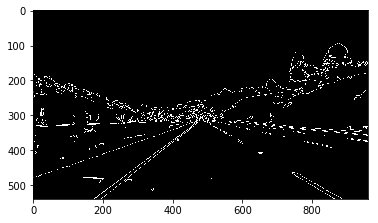

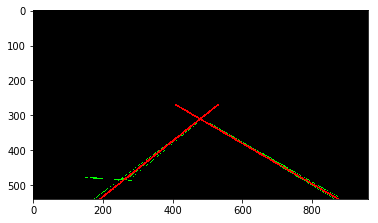

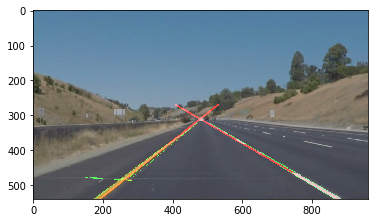

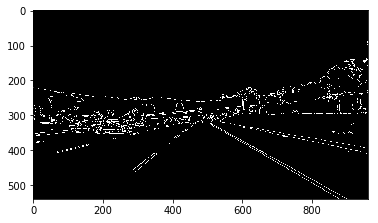

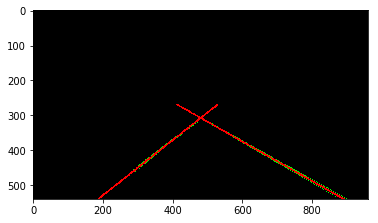

...

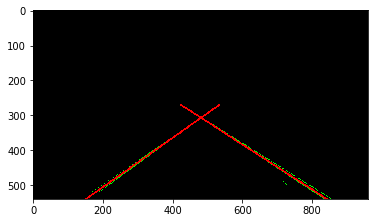

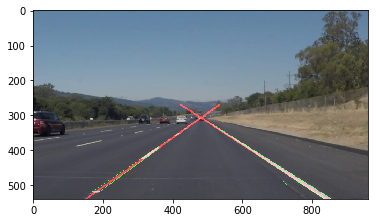

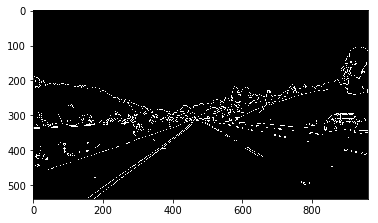

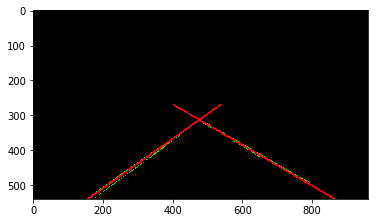

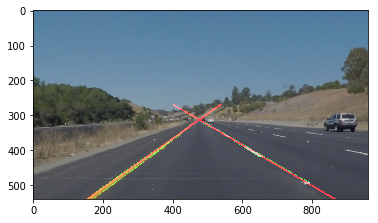

In [10]:
# TODO: Build your pipeline that will draw lane lines on the test_images
# then save them to the test_images_output directory.
left_bottom = [0, 9]
right_bottom = [1, 1]
apex = [40, 0]

tri = np.array([left_bottom,right_bottom,apex], np.int32)

for img in os.listdir("test_images/"):
    image = mpimg.imread("test_images/"+img)
    imshape = image.shape
    vertices = np.array([[(0,imshape[0]),(470, 320), (530, 320), (imshape[1],imshape[0])]], dtype=np.int32)
    gray = grayscale(image)
    kernel_size = 1
    blur_grey = gaussian_blur(gray,kernel_size)
    low_threshold = 50
    high_threshold = 150
    edges = canny(img=blur_grey,high_threshold=high_threshold,low_threshold=low_threshold)
    plt.imshow(edges, cmap='Greys_r')
    plt.figure()
    plt.imshow(edges, cmap='Greys_r')
    cut_image = region_of_interest(img=edges,vertices=vertices)
    plt.imshow(cut_image, cmap='Greys_r')
    hline = hough_lines(img=cut_image,max_line_gap=200,min_line_len=20,rho=1,theta=np.pi/180,threshold=20)
    plt.imshow(hline, cmap='Greys_r')
    plt.figure()
    imgw = weighted_img(hline,image)
    plt.imshow(imgw, cmap='Greys_r')
    plt.figure()

## Test on Videos

You know what's cooler than drawing lanes over images? Drawing lanes over video!

We can test our solution on two provided videos:

`solidWhiteRight.mp4`

`solidYellowLeft.mp4`

**Note: if you get an import error when you run the next cell, try changing your kernel (select the Kernel menu above --> Change Kernel). Still have problems? Try relaunching Jupyter Notebook from the terminal prompt. Also, consult the forums for more troubleshooting tips.**

**If you get an error that looks like this:**
```
NeedDownloadError: Need ffmpeg exe. 
You can download it by calling: 
imageio.plugins.ffmpeg.download()
```
**Follow the instructions in the error message and check out [this forum post](https://discussions.udacity.com/t/project-error-of-test-on-videos/274082) for more troubleshooting tips across operating systems.**

In [12]:
def process_image(image):
    # NOTE: The output you return should be a color image (3 channel) for processing video below
    # TODO: put your pipeline here,
    # you should return the final output (image where lines are drawn on lanes)
    imshape = image.shape
    vertices = np.array([[(0,imshape[0]),(470, 300), (530, 300), (imshape[1],imshape[0])]], dtype=np.int32)
    gray = grayscale(image)
    kernel_size = 3
    blur_grey = gaussian_blur(gray,kernel_size)
    low_threshold = 50
    high_threshold = 150
    edges = canny(img=blur_grey,high_threshold=high_threshold,low_threshold=low_threshold)
    plt.imshow(edges, cmap='Greys_r')
    plt.figure()
    plt.imshow(edges, cmap='Greys_r')
    cut_image = region_of_interest(img=edges,vertices=vertices)
    plt.imshow(cut_image, cmap='Greys_r')
    hline = hough_lines(img=cut_image,max_line_gap=200,min_line_len=20,rho=1,theta=np.pi/180,threshold=20)
    plt.imshow(hline, cmap='Greys_r')
    plt.figure()
    imgw = weighted_img(hline,image)
    plt.imshow(imgw, cmap='Greys_r')
    plt.show()
    return imgw

Let's try the one with the solid white lane on the right first ...

[  -0.72768716  651.53469793]

[ 0.63084212 -1.75395857]



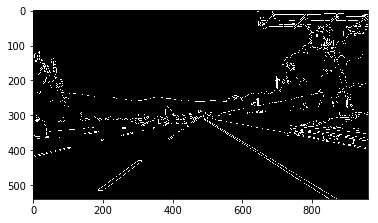

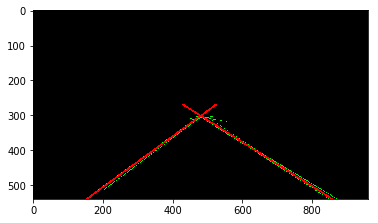

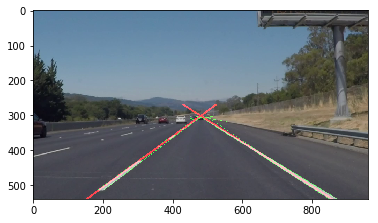

[MoviePy] >>>> Building video video_out/solidWhiteRight.mp4
[MoviePy] Writing video video_out/solidWhiteRight.mp4


  0%|          | 0/222 [00:00<?, ?it/s]

[  -0.72768716  651.53469793]

[ 0.63084212 -1.75395857]



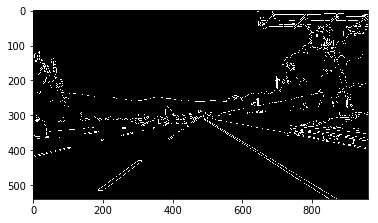

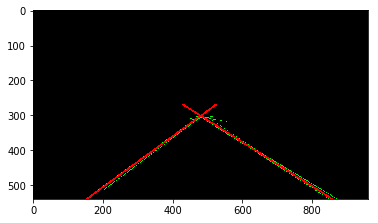

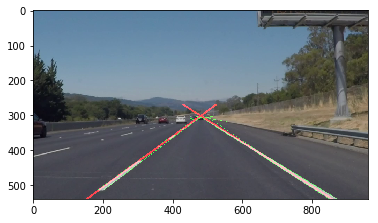

  0%|          | 1/222 [00:00<02:56,  1.25it/s]

[  -0.72921989  652.58271399]

[ 0.61621716  8.07164635]



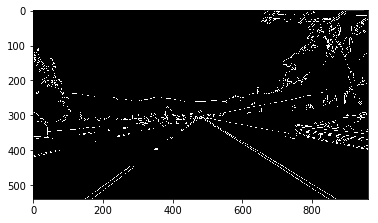

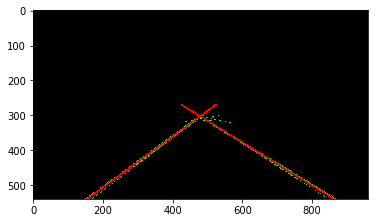

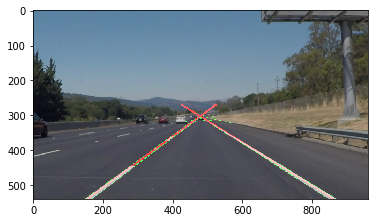

  1%|          | 2/222 [00:01<02:52,  1.27it/s]

[  -0.71819585  647.07654753]

[  0.6016694   17.23170657]



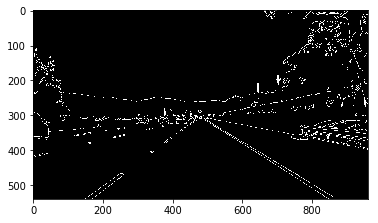

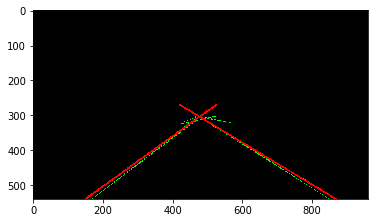

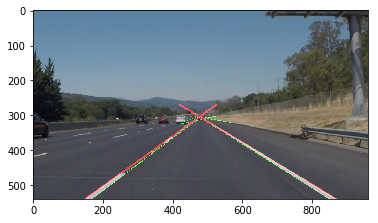

  1%|▏         | 3/222 [00:02<02:54,  1.26it/s]

[  -0.73197407  654.08221696]

[  0.59655223  20.85628536]



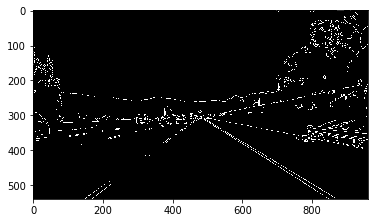

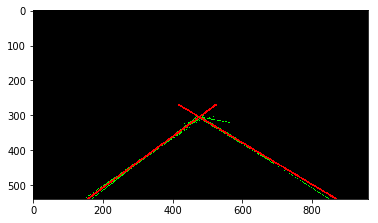

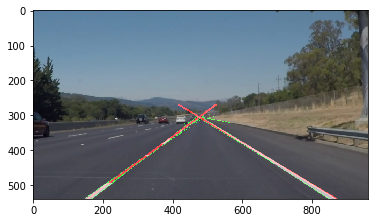

  2%|▏         | 4/222 [00:03<02:44,  1.32it/s]

[  -0.70174732  641.95510554]

[  0.59731895  19.0641542 ]



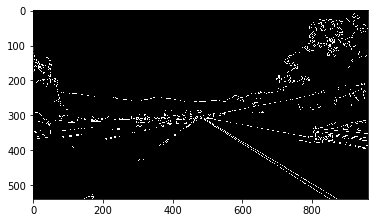

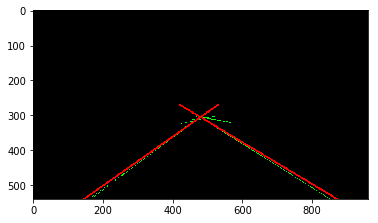

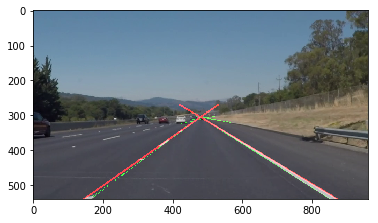

  2%|▏         | 5/222 [00:03<02:49,  1.28it/s]

[  -0.6868661   634.45826194]

[  0.60243473  16.29862743]



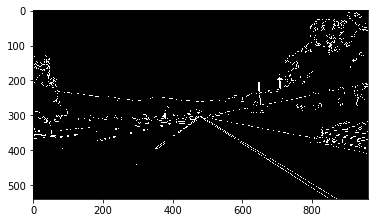

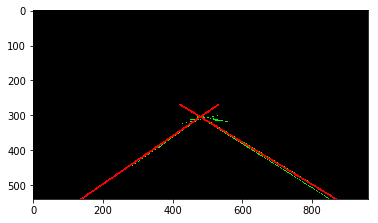

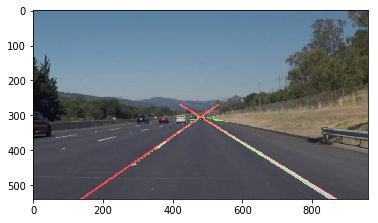

  3%|▎         | 6/222 [00:04<02:47,  1.29it/s]

[  -0.6794221  631.1248128]

[  0.6053135   15.11588374]



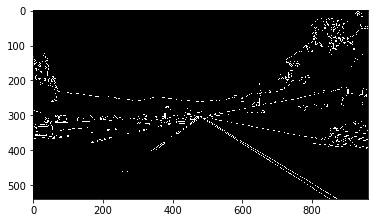

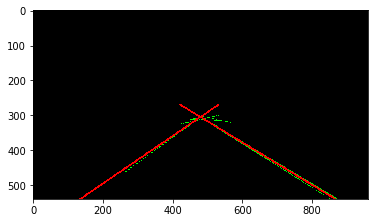

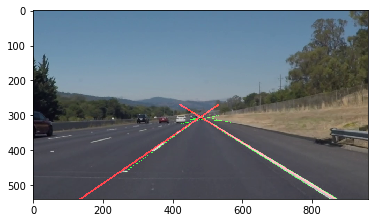

  3%|▎         | 7/222 [00:05<02:45,  1.30it/s]

[  -0.69330552  637.91588914]

[  0.60246734  15.66337335]



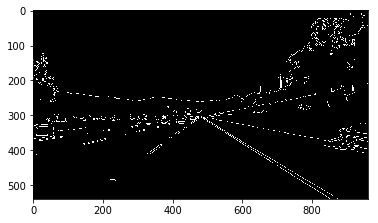

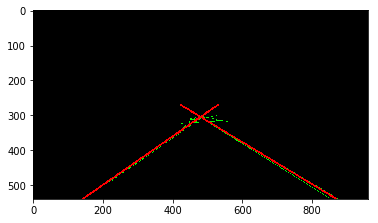

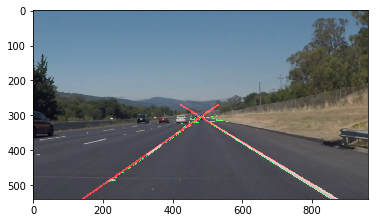

  4%|▎         | 8/222 [00:06<02:45,  1.29it/s]

[  -0.69684535  639.02740199]

[  0.60316942  16.10736987]



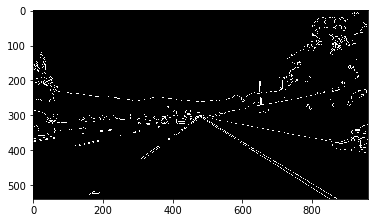

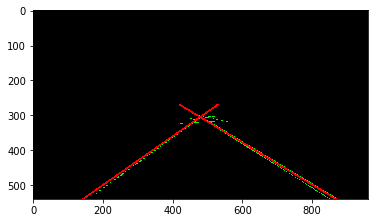

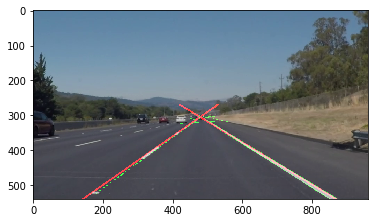

  4%|▍         | 9/222 [00:06<02:39,  1.33it/s]

[  -0.68234997  634.07162949]

[  0.59806285  20.86936486]



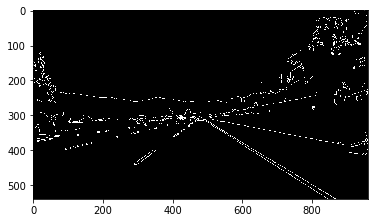

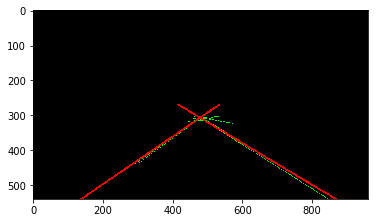

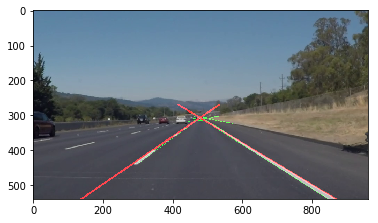

  5%|▍         | 10/222 [00:07<02:40,  1.32it/s]

[  -0.70589216  643.88876251]

[  0.60545346  20.65021411]



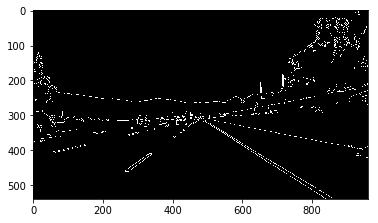

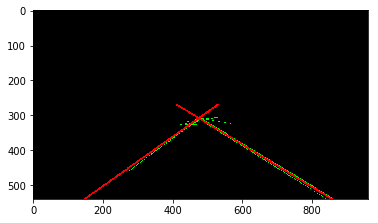

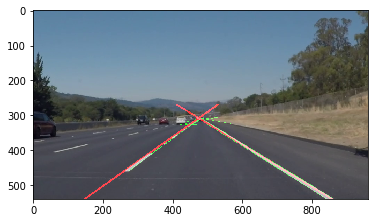

  5%|▍         | 11/222 [00:08<02:39,  1.33it/s]

[  -0.67715158  633.89329116]

[ 0.62704348  7.4516948 ]



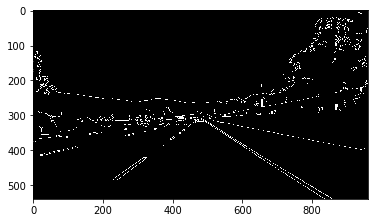

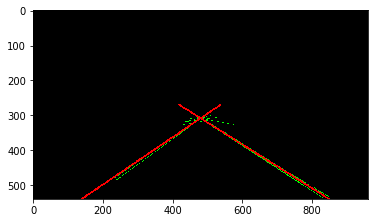

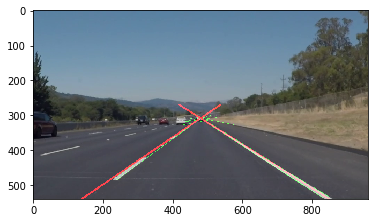

  5%|▌         | 12/222 [00:09<02:40,  1.31it/s]

[  -0.71085327  647.5082098 ]

[ 0.62748756  7.15363886]



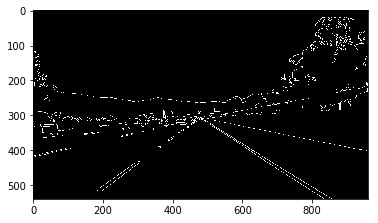

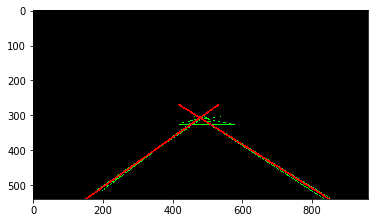

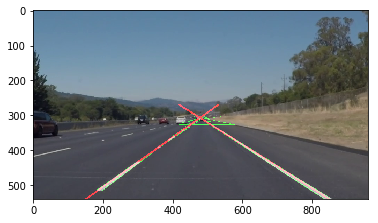

  6%|▌         | 13/222 [00:09<02:32,  1.37it/s]

[  -0.70248119  639.94528681]

[ 0.62132678  9.92125923]



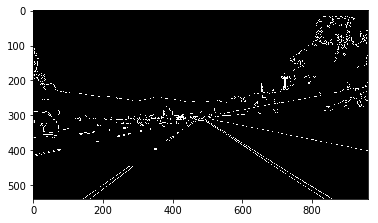

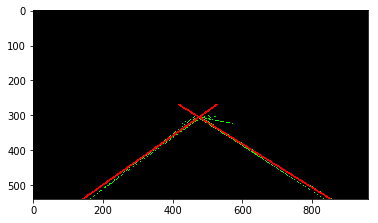

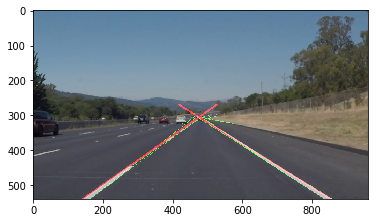

  6%|▋         | 14/222 [00:10<02:31,  1.37it/s]

[  -0.71091513  645.05535686]

[ 0.62888815  3.26699009]



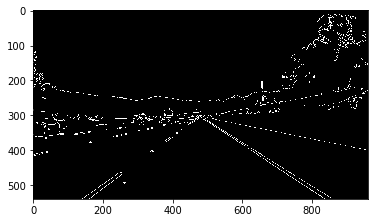

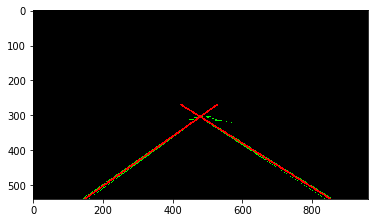

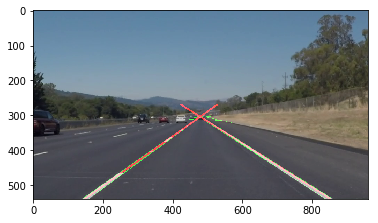

  7%|▋         | 15/222 [00:11<02:33,  1.35it/s]

[  -0.71643441  644.44649285]

[ 0.63645782 -3.91018178]



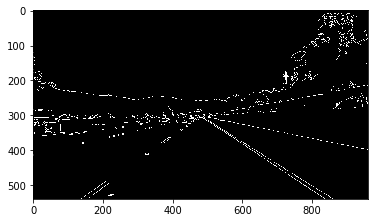

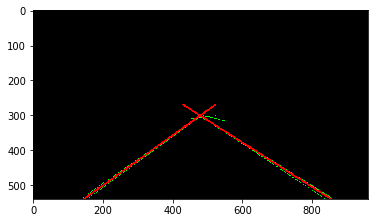

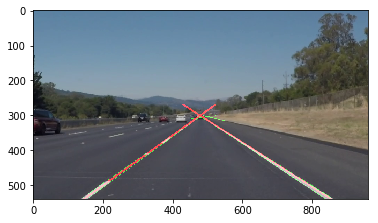

  7%|▋         | 16/222 [00:12<02:36,  1.31it/s]

[  -0.69626664  636.76840452]

[ 0.62641344  2.02742203]



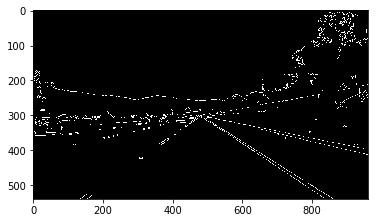

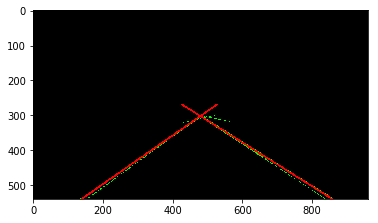

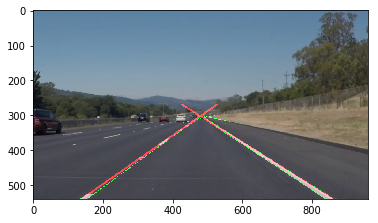

  8%|▊         | 17/222 [00:12<02:36,  1.31it/s]

[  -0.70608238  641.16241323]

[ 0.6214021   5.00029582]



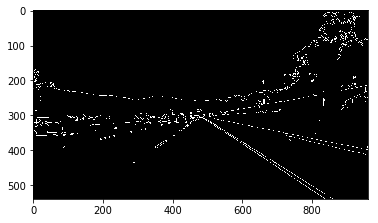

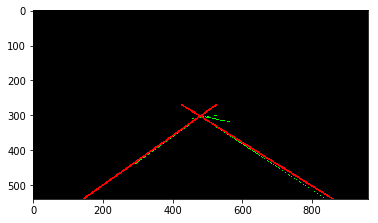

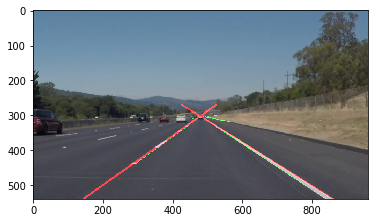

  8%|▊         | 18/222 [00:13<02:33,  1.33it/s]

[  -0.69649175  638.51587233]

[ 0.62550375  4.6163883 ]



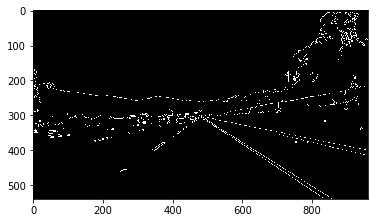

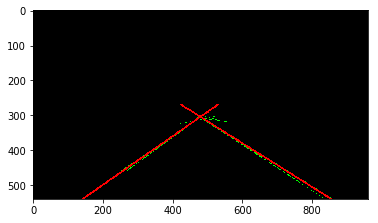

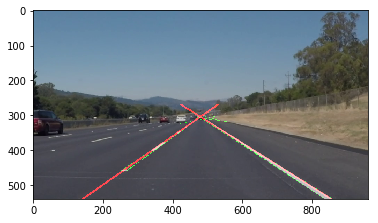

  9%|▊         | 19/222 [00:14<02:36,  1.29it/s]

[  -0.69553585  639.25761097]

[ 0.62908201  4.8309972 ]



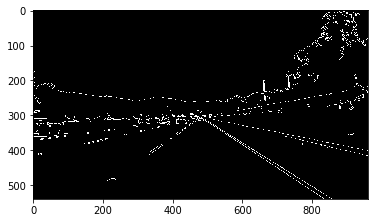

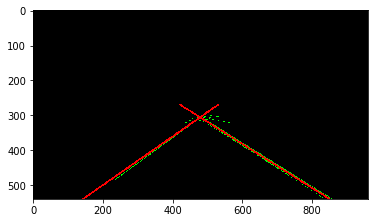

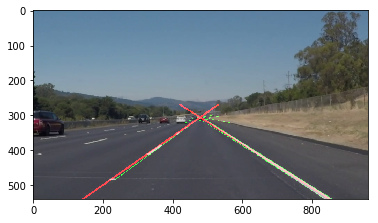

  9%|▉         | 20/222 [00:15<02:27,  1.37it/s]

[  -0.69431039  640.23143581]

[ 0.63192091  3.97994381]



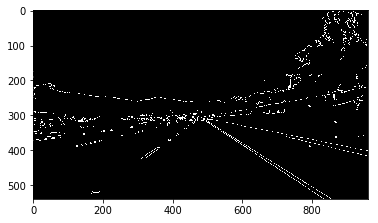

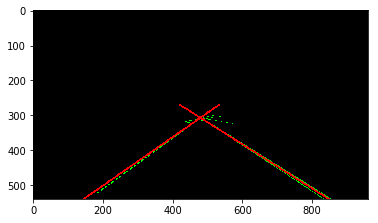

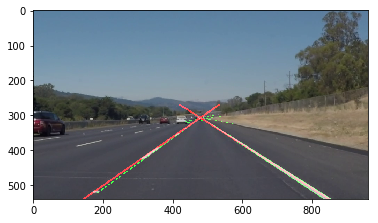

  9%|▉         | 21/222 [00:15<02:20,  1.43it/s]

[  -0.68380263  635.33335667]

[ 0.63277468  4.0198439 ]



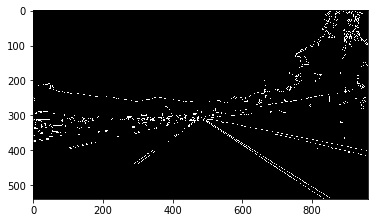

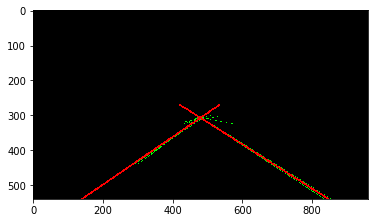

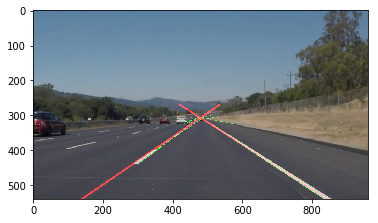

 10%|▉         | 22/222 [00:16<02:17,  1.45it/s]

[  -0.68464728  634.967459  ]

[ 0.62343491  7.385245  ]



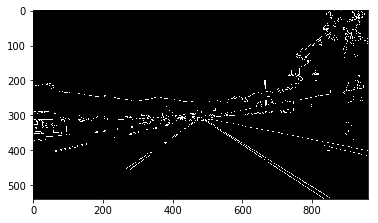

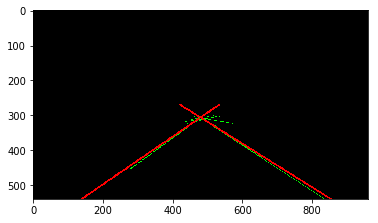

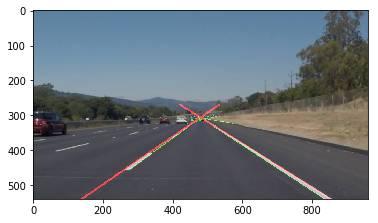

 10%|█         | 23/222 [00:17<02:16,  1.46it/s]

[  -0.6912254   637.37636009]

[ 0.63110178  3.57955653]



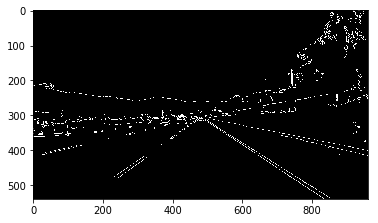

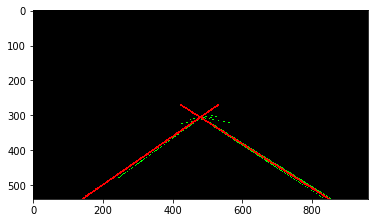

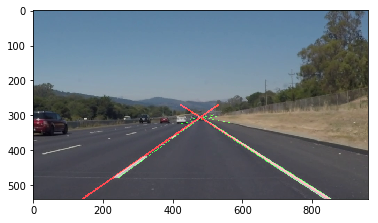

 11%|█         | 24/222 [00:17<02:12,  1.50it/s]

[  -0.69274168  638.15398387]

[ 0.62653206  4.84842504]



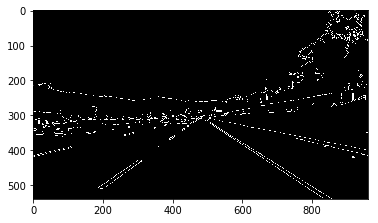

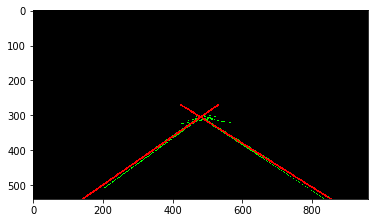

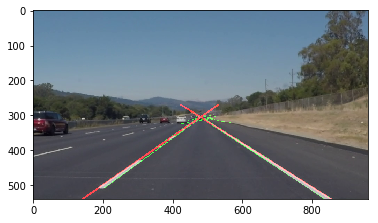

 11%|█▏        | 25/222 [00:18<02:14,  1.46it/s]

[  -0.70332036  643.39165599]

[ 0.64444653 -8.39178677]



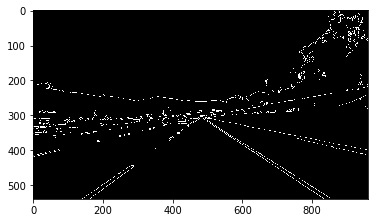

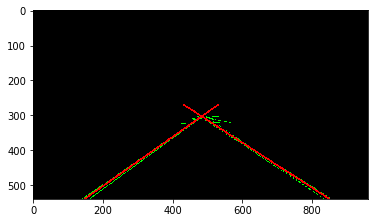

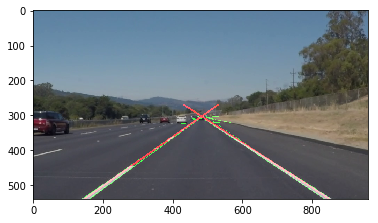

 12%|█▏        | 26/222 [00:19<02:17,  1.43it/s]

[  -0.69733559  641.68524715]

[ 0.62505264  5.68036172]



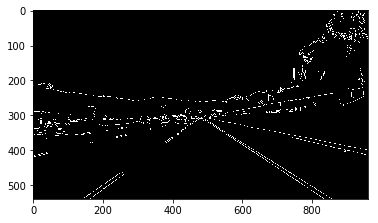

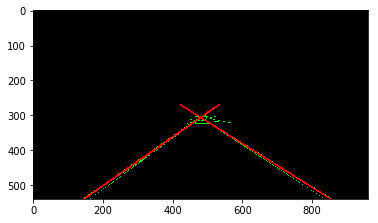

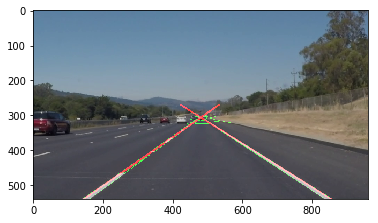

 12%|█▏        | 27/222 [00:19<02:21,  1.38it/s]

[  -0.68509759  635.40874137]

[ 0.63219507  2.56477222]



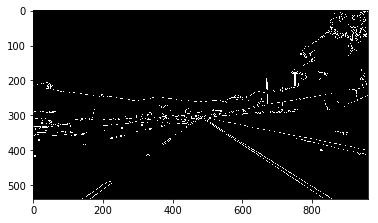

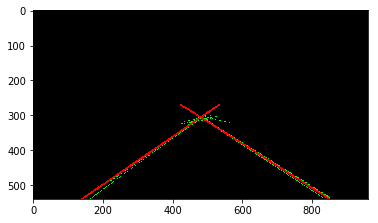

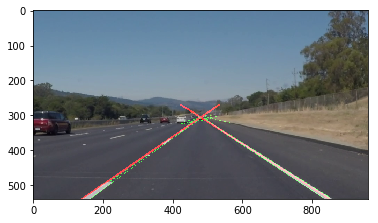

 13%|█▎        | 28/222 [00:20<02:21,  1.37it/s]

[  -0.68884315  638.1907378 ]

[ 0.62767346  4.68945918]



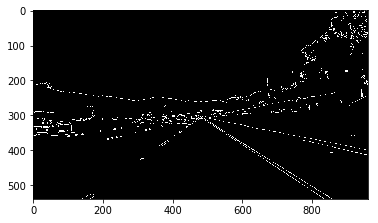

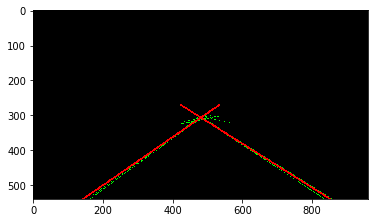

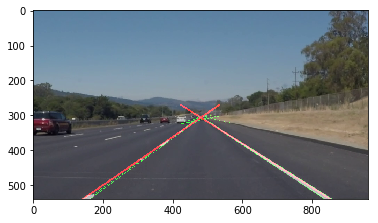

 13%|█▎        | 29/222 [00:21<02:22,  1.36it/s]

[  -0.70069049  641.78316979]

[ 0.63441893  0.83609228]



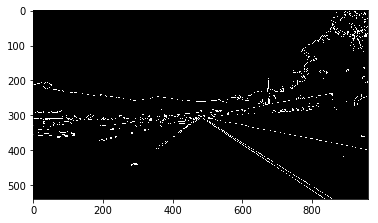

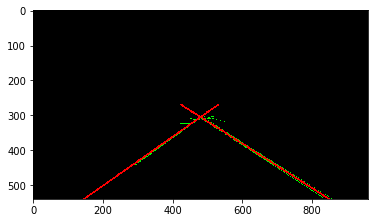

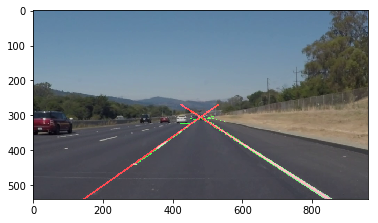

 14%|█▎        | 30/222 [00:22<02:25,  1.32it/s]

[  -0.70106383  640.98677401]

[ 0.6277418   3.77385403]



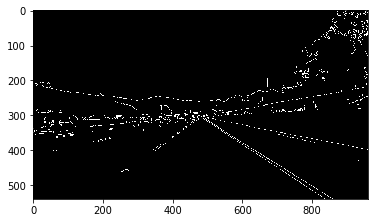

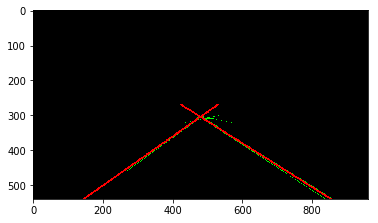

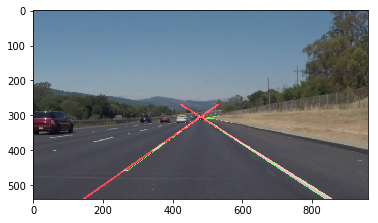

 14%|█▍        | 31/222 [00:22<02:20,  1.36it/s]

[  -0.70585881  641.30015731]

[ 0.63100075  1.85309746]



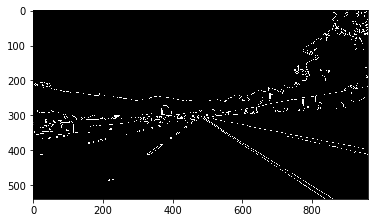

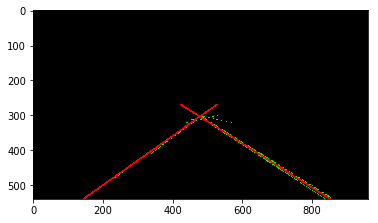

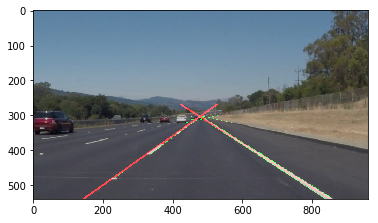

 14%|█▍        | 32/222 [00:23<02:21,  1.35it/s]

[  -0.69776742  638.50324663]

[ 0.62216187  5.54991308]



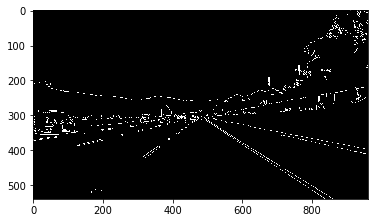

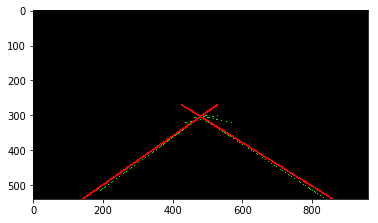

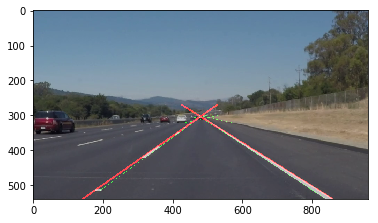

 15%|█▍        | 33/222 [00:24<02:16,  1.38it/s]

[  -0.72647328  651.22629123]

[ 0.62734889  4.14536529]



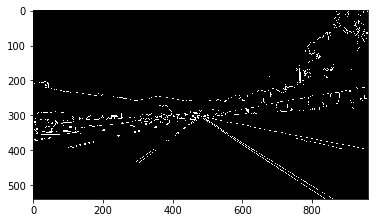

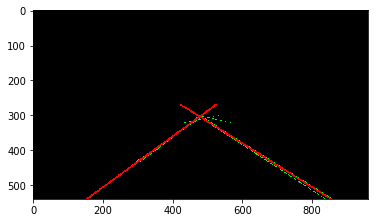

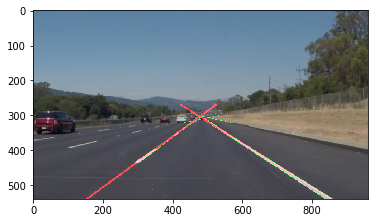

 15%|█▌        | 34/222 [00:25<02:19,  1.34it/s]

[  -0.72138005  650.4691844 ]

[ 0.62119649  7.91320001]



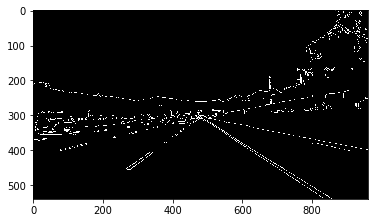

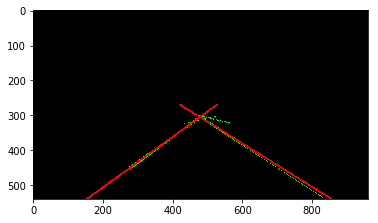

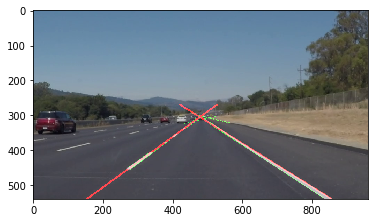

 16%|█▌        | 35/222 [00:25<02:19,  1.34it/s]

[  -0.69421984  639.94619361]

[  0.61410125  11.5915996 ]



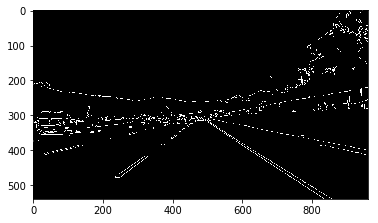

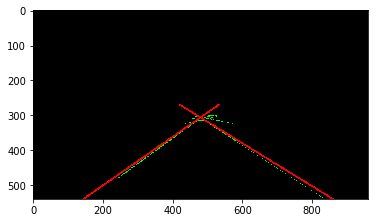

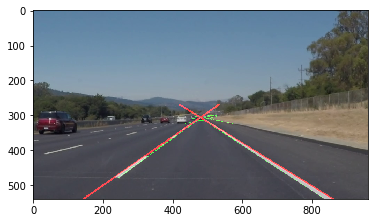

 16%|█▌        | 36/222 [00:26<02:18,  1.34it/s]

[  -0.70800773  647.74310482]

[ 0.62337142  7.38312571]



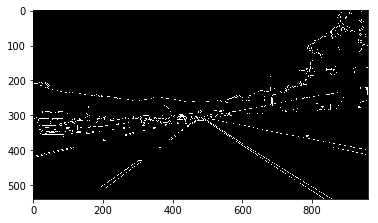

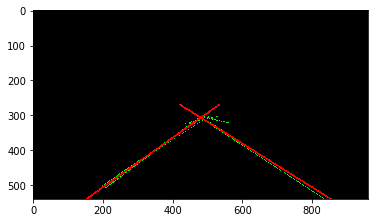

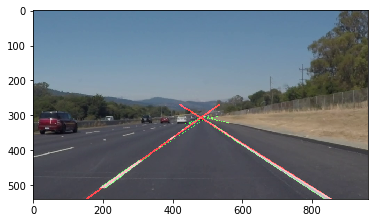

 17%|█▋        | 37/222 [00:27<02:24,  1.28it/s]

[  -0.69784044  642.09881827]

[ 0.62783229  6.82508434]



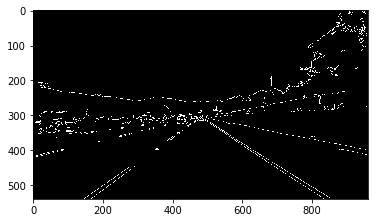

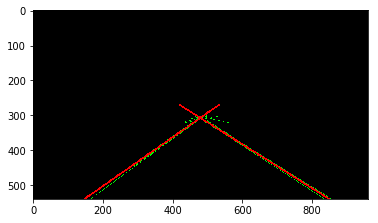

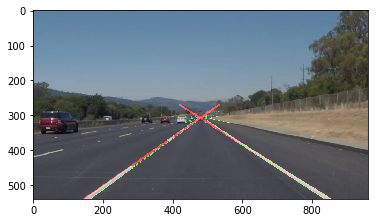

 17%|█▋        | 38/222 [00:28<02:29,  1.23it/s]

[  -0.73109194  654.63462024]

[ 0.62311751  7.46684724]



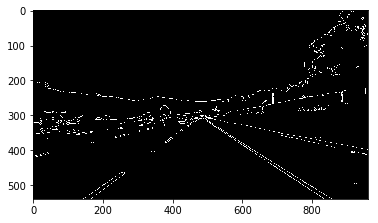

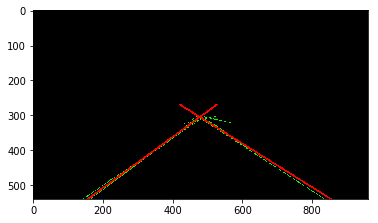

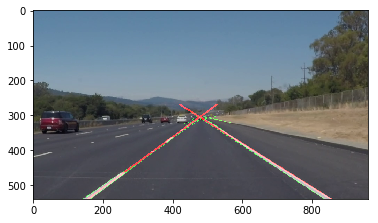

 18%|█▊        | 39/222 [00:28<02:17,  1.33it/s]

[  -0.71503746  648.4291506 ]

[ 0.62690257  5.10337679]



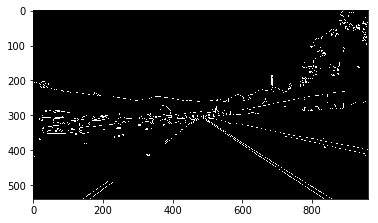

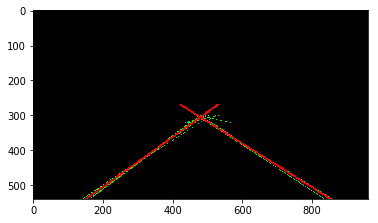

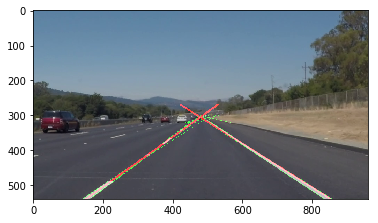

 18%|█▊        | 40/222 [00:29<02:08,  1.41it/s]

[  -0.72722698  651.11266928]

[ 0.63213245  2.18640087]



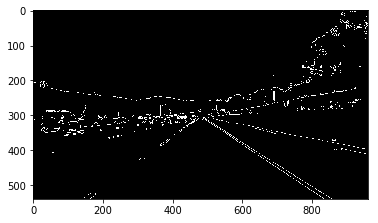

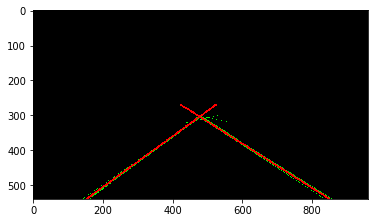

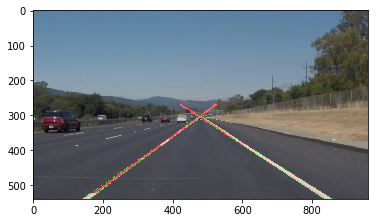

 18%|█▊        | 41/222 [00:30<02:05,  1.45it/s]

[  -0.70524854  642.04377078]

[ 0.64012164 -4.24298559]



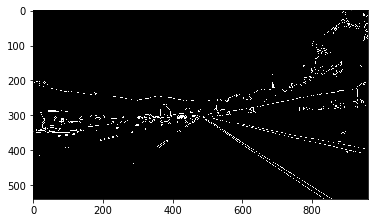

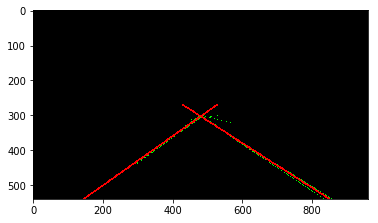

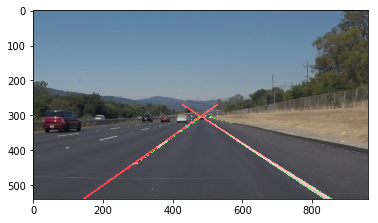

 19%|█▉        | 42/222 [00:30<02:04,  1.44it/s]

[  -0.72153492  648.27550199]

[ 0.62281494  6.8394873 ]



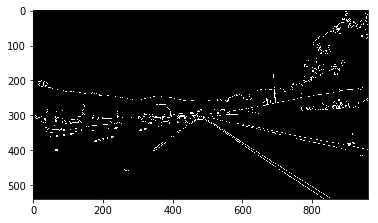

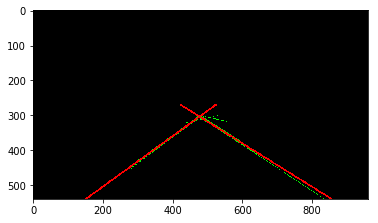

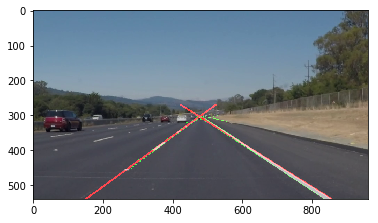

 19%|█▉        | 43/222 [00:31<02:06,  1.42it/s]

[  -0.73203432  651.4767205 ]

[ 0.6326523   1.40029968]



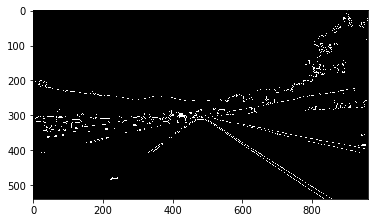

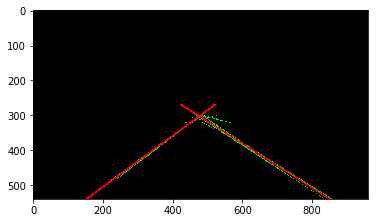

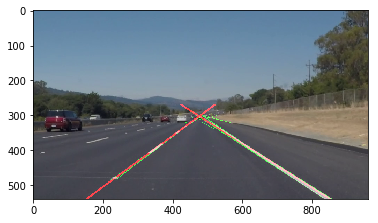

 20%|█▉        | 44/222 [00:32<02:08,  1.39it/s]

[  -0.70945005  642.41176969]

[  0.64905456 -11.02215202]



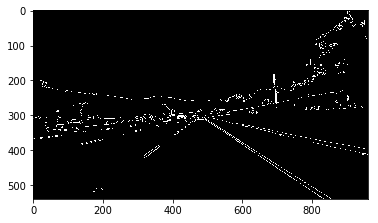

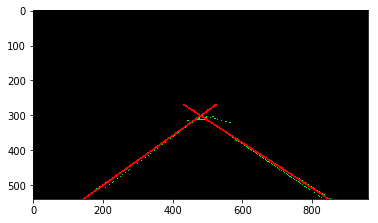

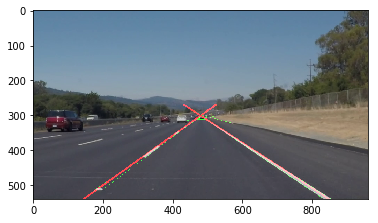

 20%|██        | 45/222 [00:33<02:12,  1.34it/s]

[  -0.71983808  645.97259318]

[ 0.63790803 -2.89911122]



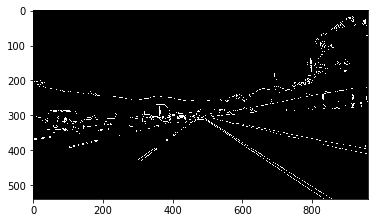

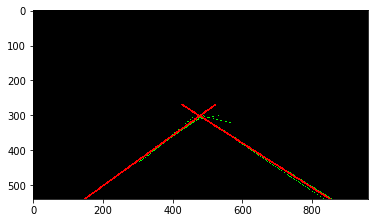

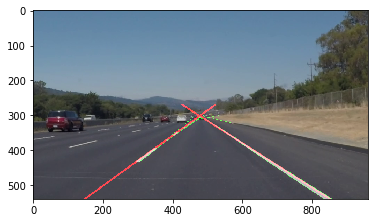

 21%|██        | 46/222 [00:33<02:07,  1.38it/s]

[  -0.72676104  648.42652727]

[ 0.64401239 -6.51650541]



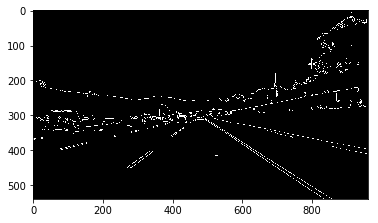

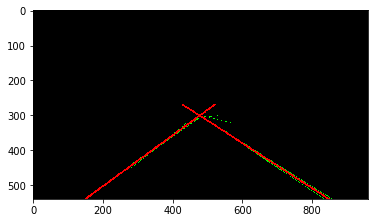

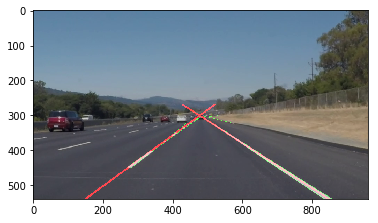

 21%|██        | 47/222 [00:34<02:04,  1.40it/s]

[  -0.7105858   643.18264407]

[  0.65421131 -12.98882258]



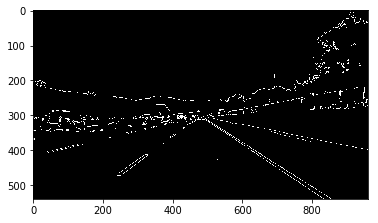

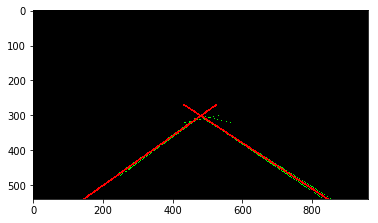

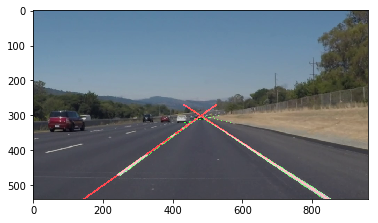

 22%|██▏       | 48/222 [00:35<02:00,  1.45it/s]

[  -0.69883063  636.99317622]

[ 0.63055115  1.06764468]



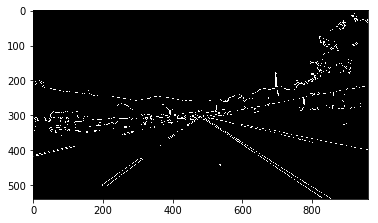

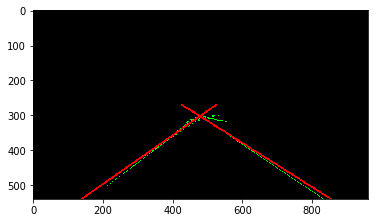

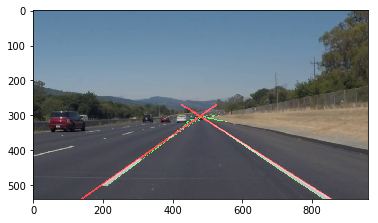

 22%|██▏       | 49/222 [00:35<02:01,  1.42it/s]

[  -0.69327947  635.39745772]

[  0.65789363 -14.21731013]



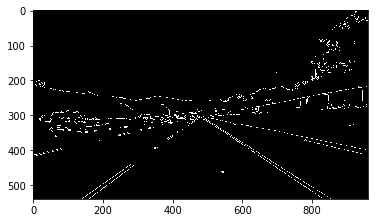

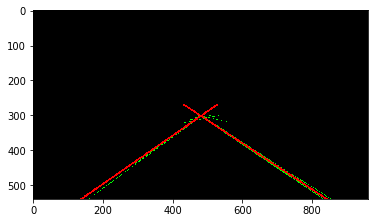

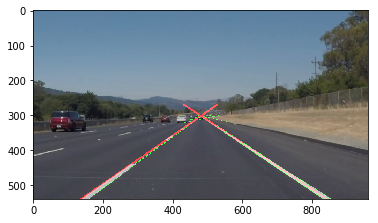

 23%|██▎       | 50/222 [00:36<02:04,  1.38it/s]

[  -0.72556327  646.50677275]

[  0.64927968 -10.07619919]



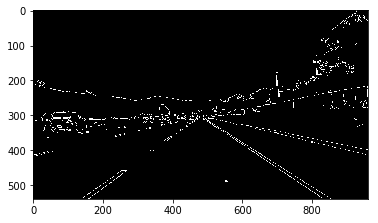

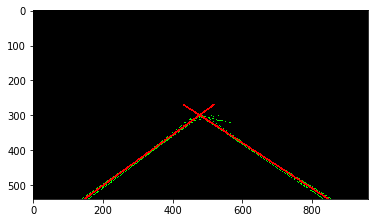

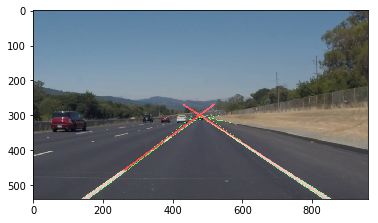

 23%|██▎       | 51/222 [00:37<02:05,  1.36it/s]

[  -0.70604057  638.92116356]

[  0.65650591 -15.75698578]



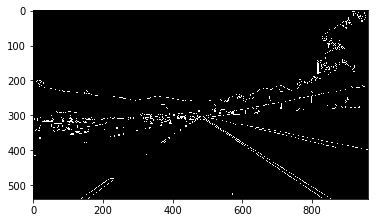

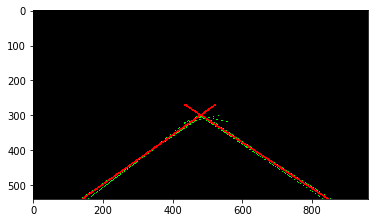

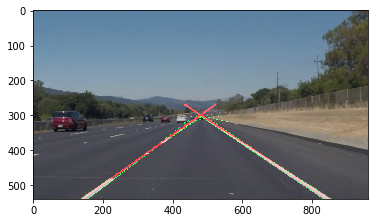

 23%|██▎       | 52/222 [00:38<02:03,  1.38it/s]

[  -0.69405257  634.9061219 ]

[ 0.63597788 -1.45692066]



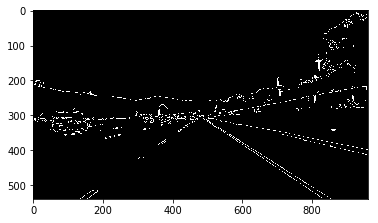

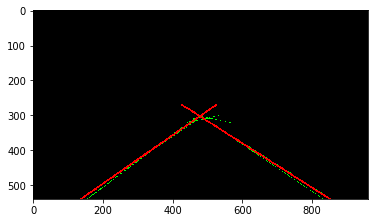

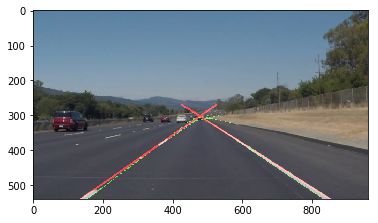

 24%|██▍       | 53/222 [00:38<01:58,  1.42it/s]

[  -0.68391834  631.89113269]

[ 0.63814119 -2.40071305]



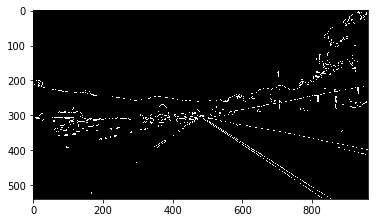

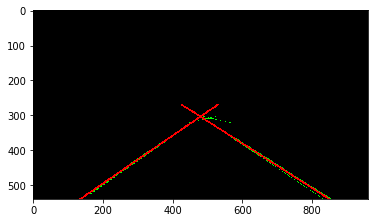

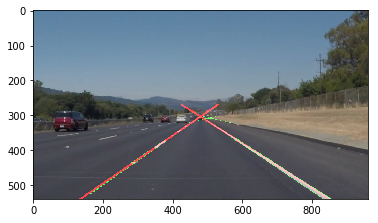

 24%|██▍       | 54/222 [00:39<02:01,  1.38it/s]

[  -0.66476508  623.03762864]

[ 0.63939063 -3.42780304]



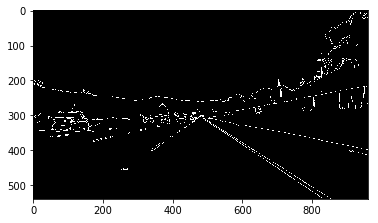

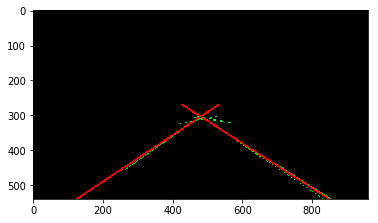

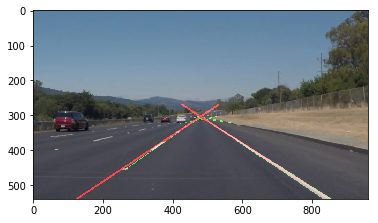

 25%|██▍       | 55/222 [00:40<02:03,  1.36it/s]

[  -0.6651663   623.87715311]

[ 0.62739805  5.56849251]



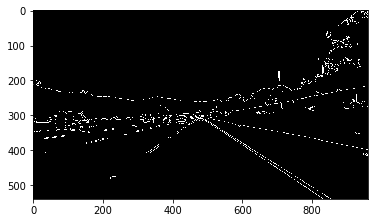

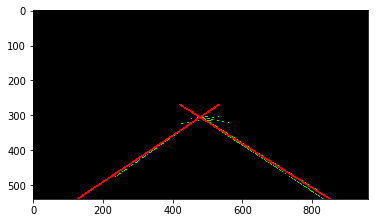

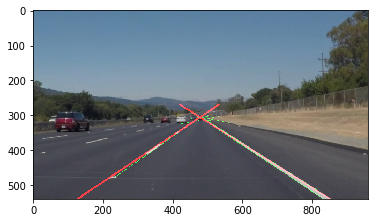

 25%|██▌       | 56/222 [00:41<02:06,  1.32it/s]

[  -0.66136733  623.02080751]

[ 0.62490308  7.79888742]



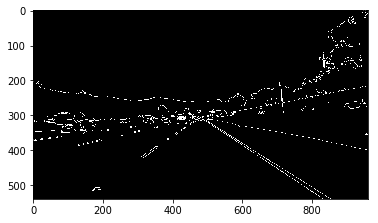

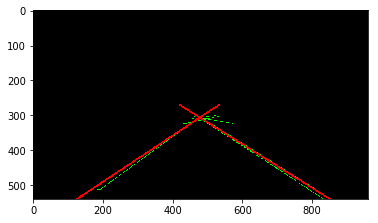

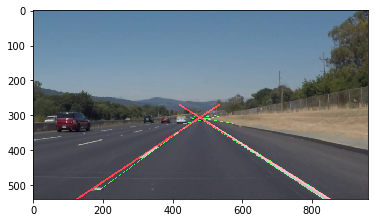

 26%|██▌       | 57/222 [00:42<02:08,  1.29it/s]

[  -0.66481392  625.72319577]

[ 0.62732555  8.10764836]



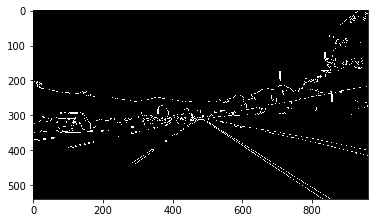

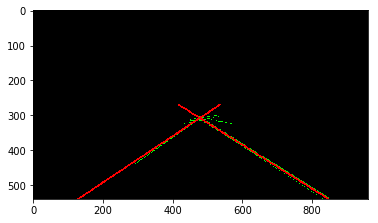

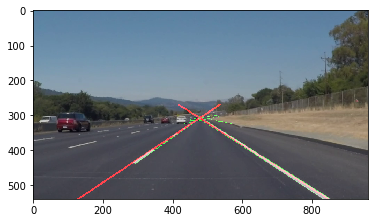

 26%|██▌       | 58/222 [00:42<02:09,  1.26it/s]

[  -0.6651306   625.10390374]

[ 0.63158634  3.79211243]



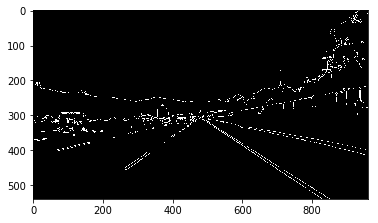

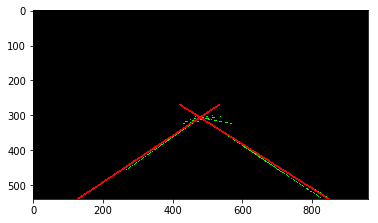

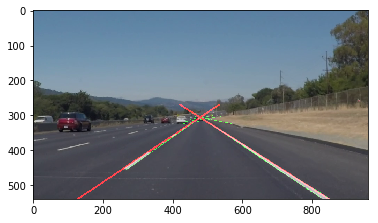

 27%|██▋       | 59/222 [00:43<02:07,  1.28it/s]

[  -0.66794465  624.79687418]

[ 0.64496169 -5.43316131]



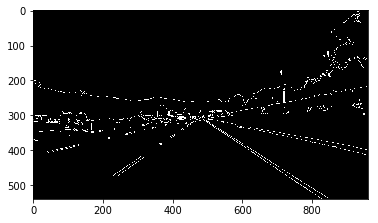

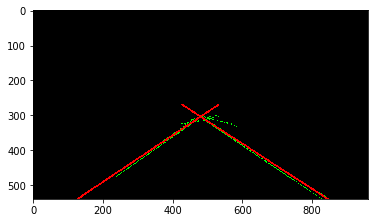

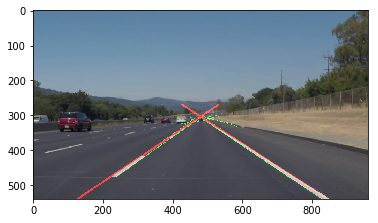

 27%|██▋       | 60/222 [00:44<02:16,  1.19it/s]

[  -0.67525123  630.1837724 ]

[ 0.63266004  1.091513  ]



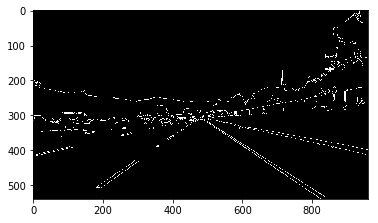

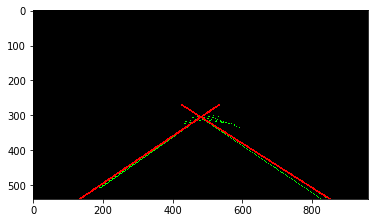

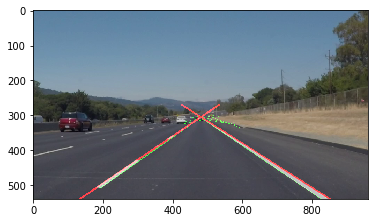

 27%|██▋       | 61/222 [00:45<02:15,  1.19it/s]

[  -0.67418796  629.32280292]

[ 0.63271285  4.17301804]



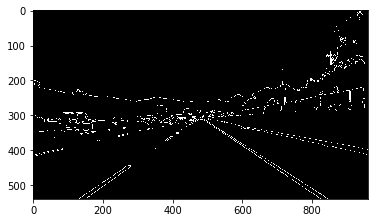

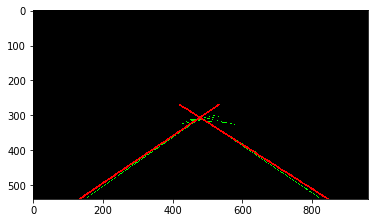

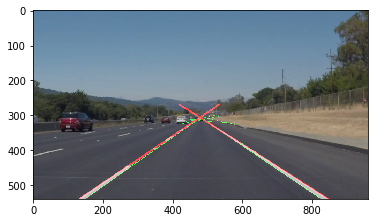

 28%|██▊       | 62/222 [00:46<02:10,  1.23it/s]

[  -0.6591988   622.35235577]

[ 0.64503678 -4.77019961]



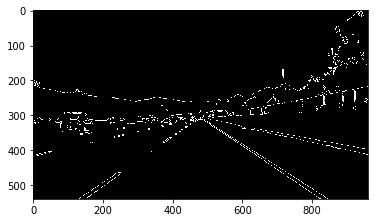

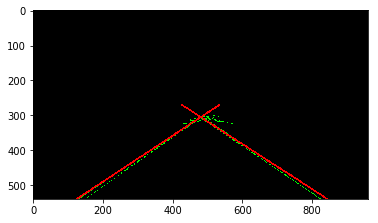

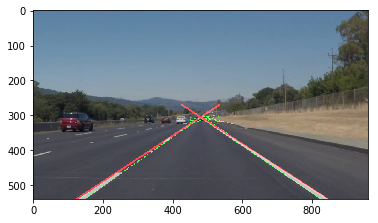

 28%|██▊       | 63/222 [00:47<02:13,  1.19it/s]

[  -0.66952348  626.50506249]

[ 0.63621463  0.08192103]



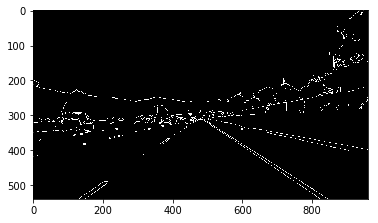

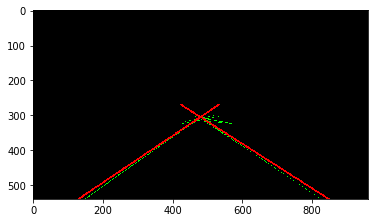

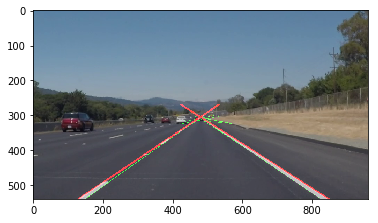

 29%|██▉       | 64/222 [00:47<02:15,  1.16it/s]

[  -0.67150281  627.21940552]

[ 0.6530151  -7.16281828]



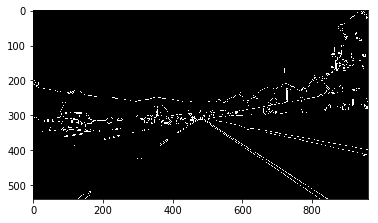

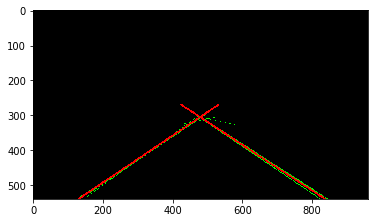

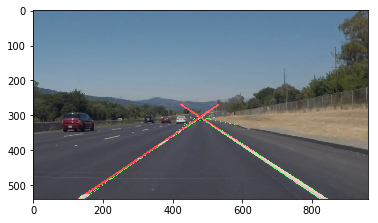

 29%|██▉       | 65/222 [00:48<02:15,  1.16it/s]

[  -0.67435134  626.43932217]

[ 0.65707222 -9.80938751]



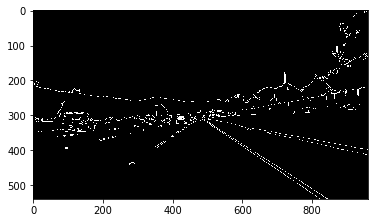

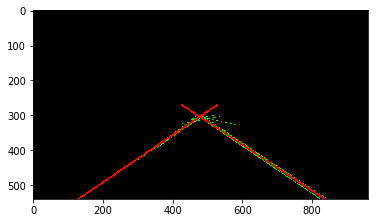

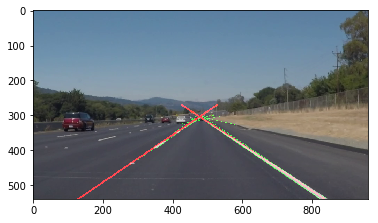

 30%|██▉       | 66/222 [00:49<02:16,  1.15it/s]

[  -0.65602492  618.68029082]

[ 0.65246101 -8.05358836]



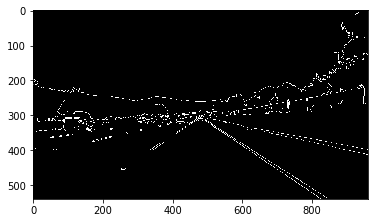

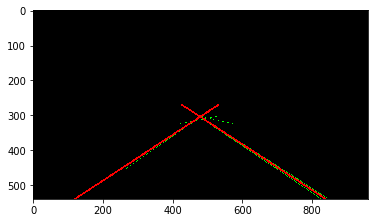

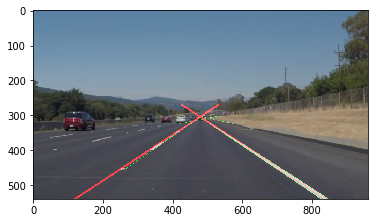

 30%|███       | 67/222 [00:50<02:19,  1.11it/s]

[  -0.65381974  617.24511061]

[  0.65479195 -10.6486284 ]



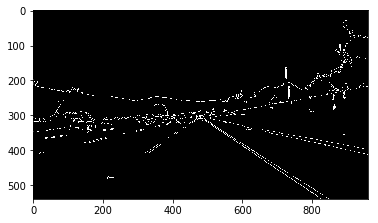

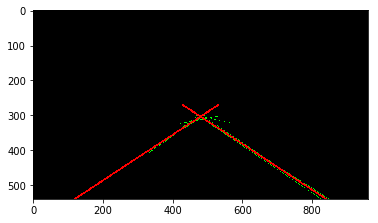

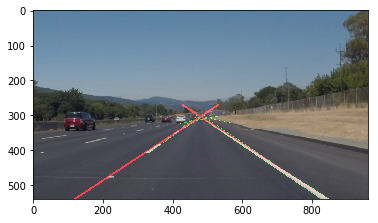

 31%|███       | 68/222 [00:51<02:18,  1.11it/s]

[  -0.65089908  618.88642897]

[ 0.65392427 -8.26797946]



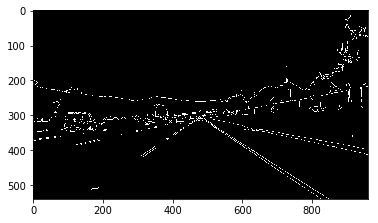

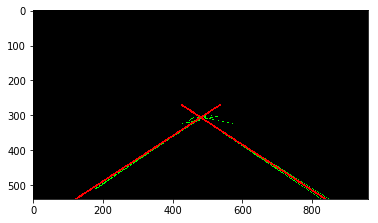

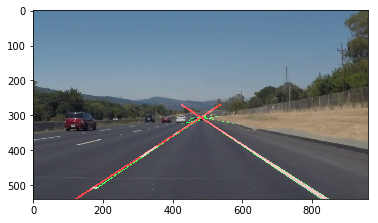

 31%|███       | 69/222 [00:52<02:14,  1.14it/s]

[  -0.65181399  616.97250154]

[ 0.64542567 -4.77931725]



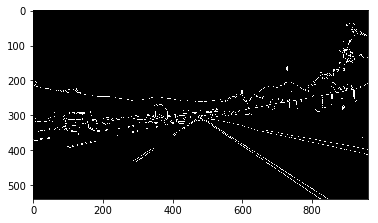

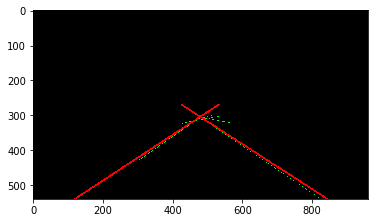

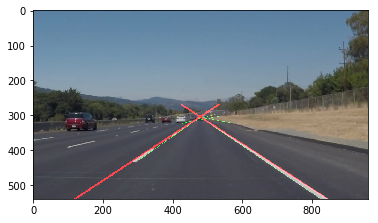

 32%|███▏      | 70/222 [00:53<02:16,  1.12it/s]

[  -0.64336936  613.61757145]

[ 0.64683907 -4.75047218]



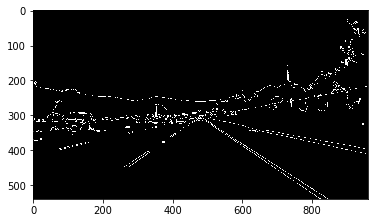

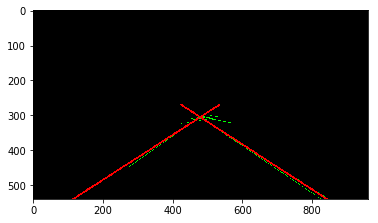

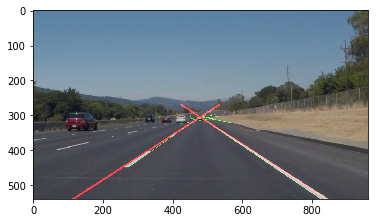

 32%|███▏      | 71/222 [00:54<02:23,  1.05it/s]

[  -0.68358527  629.59892043]

[  0.65791839 -10.86134508]



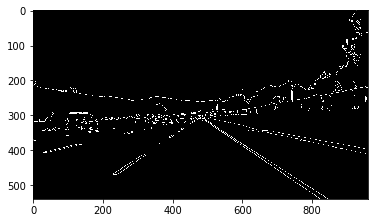

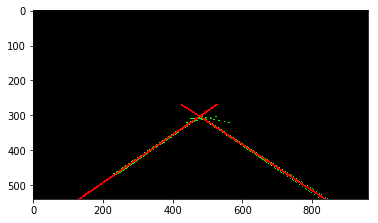

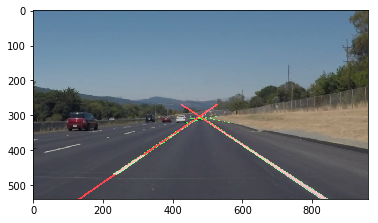

 32%|███▏      | 72/222 [00:55<02:24,  1.04it/s]

[  -0.65502124  619.38018917]

[ 0.64750855 -5.51093627]



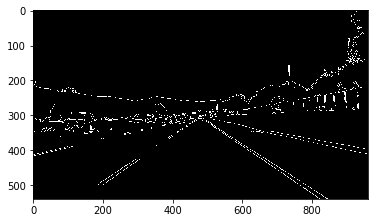

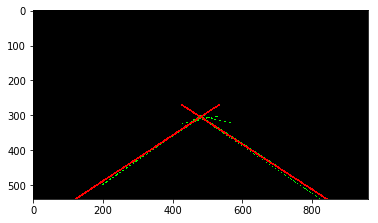

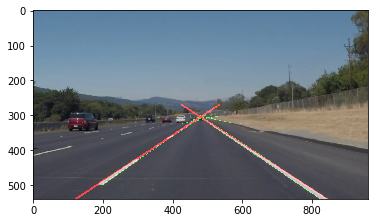

 33%|███▎      | 73/222 [00:56<02:13,  1.11it/s]

[  -0.66345611  624.70000015]

[ 0.64961897 -5.27285132]



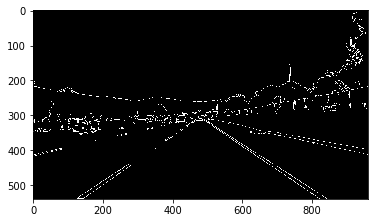

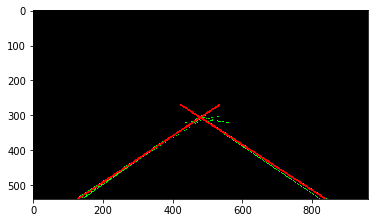

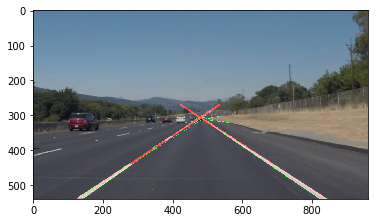

 33%|███▎      | 74/222 [00:56<02:02,  1.21it/s]

[  -0.66971551  625.47565639]

[ 0.65067625 -3.48418483]



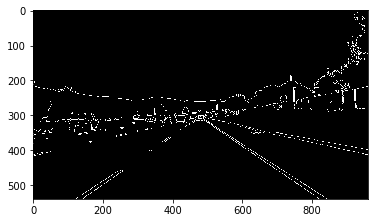

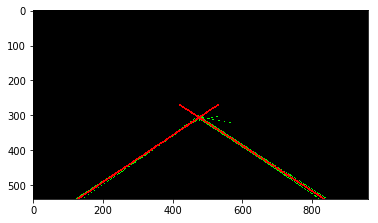

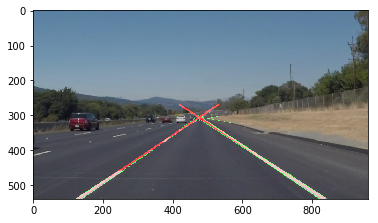

 34%|███▍      | 75/222 [00:57<01:58,  1.24it/s]

[  -0.6777821   626.42973519]

[ 0.65574085 -8.64211728]



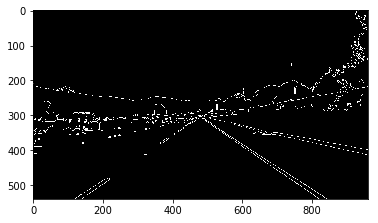

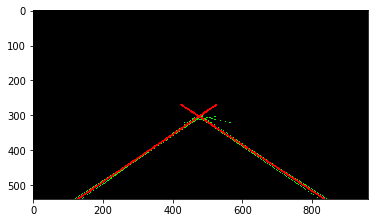

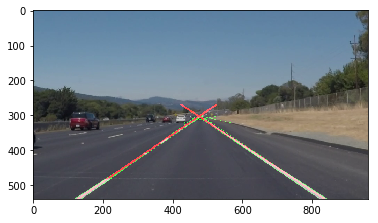

 34%|███▍      | 76/222 [00:58<01:57,  1.25it/s]

[  -0.6433865  613.9953133]

[ 0.65694313 -7.81298158]



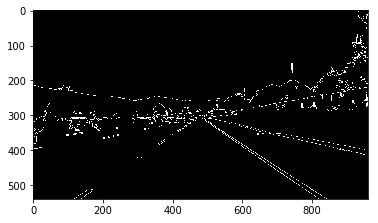

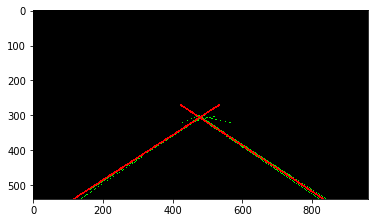

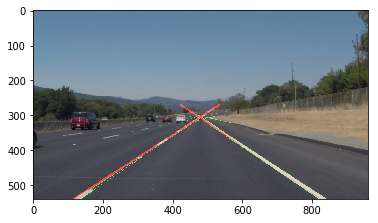

 35%|███▍      | 77/222 [00:59<01:57,  1.24it/s]

[  -0.63365415  607.8150595 ]

[ 0.65874601 -7.81383246]



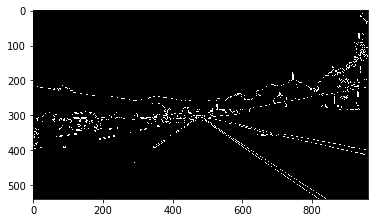

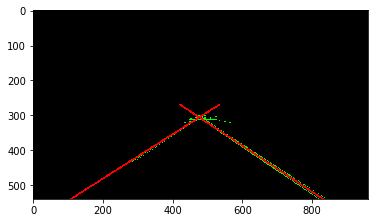

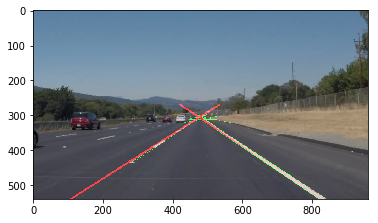

 35%|███▌      | 78/222 [01:00<01:59,  1.20it/s]

[  -0.64049859  611.25911761]

[  0.66137739 -10.57406916]



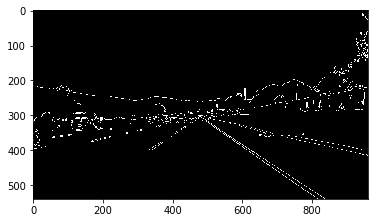

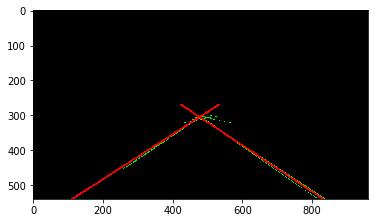

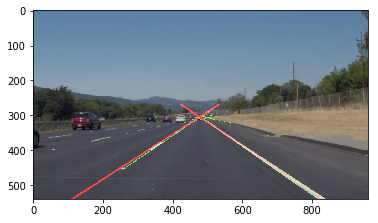

 36%|███▌      | 79/222 [01:00<01:58,  1.21it/s]

[  -0.64642488  614.20896556]

[ 0.64991787 -3.20500371]



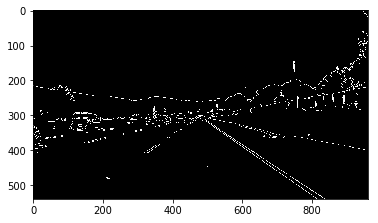

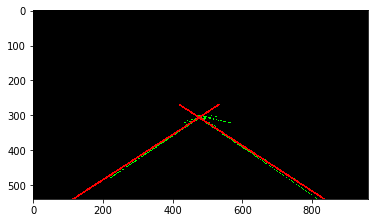

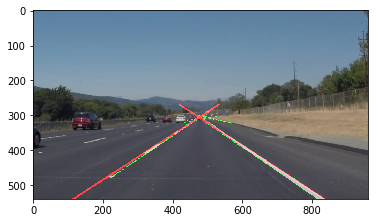

 36%|███▌      | 80/222 [01:01<01:55,  1.23it/s]

[  -0.6496934   615.84907512]

[ 0.65688205 -8.96146397]



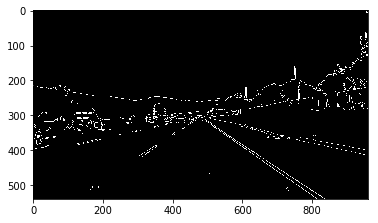

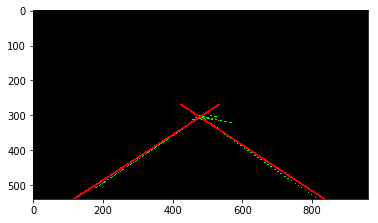

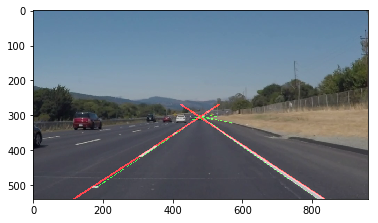

 36%|███▋      | 81/222 [01:02<01:53,  1.24it/s]

[  -0.66679669  621.64807437]

[  0.67044959 -17.49892109]



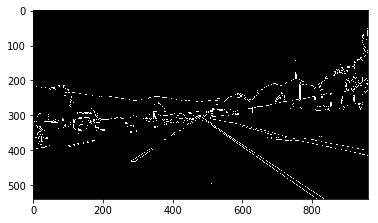

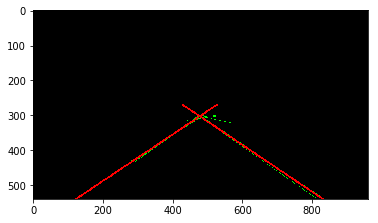

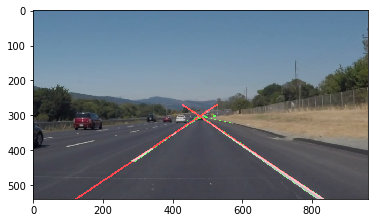

 37%|███▋      | 82/222 [01:03<01:51,  1.25it/s]

[  -0.65003927  615.75586593]

[  0.68229928 -24.38357537]



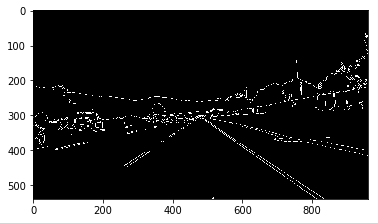

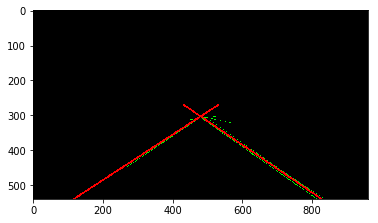

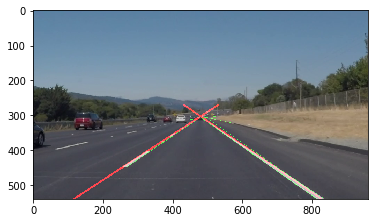

 37%|███▋      | 83/222 [01:04<01:50,  1.26it/s]

[  -0.63968243  611.3754523 ]

[  0.67653995 -19.95260069]



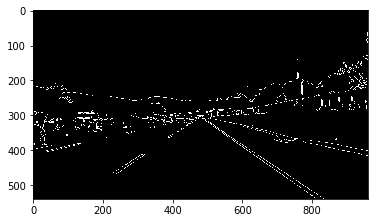

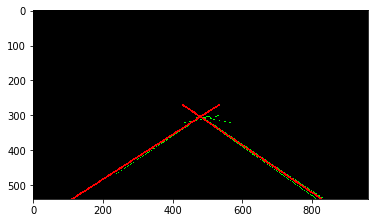

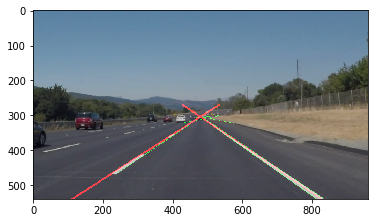

 38%|███▊      | 84/222 [01:04<01:48,  1.27it/s]

[  -0.64982422  616.07554918]

[  0.67274412 -16.13250913]



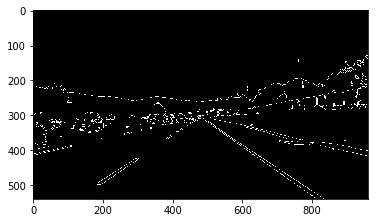

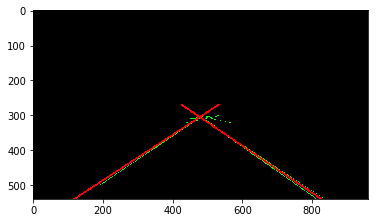

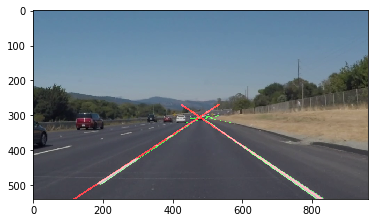

 38%|███▊      | 85/222 [01:05<01:45,  1.29it/s]

[  -0.65553409  618.40774751]

[  0.66817681 -15.99646171]



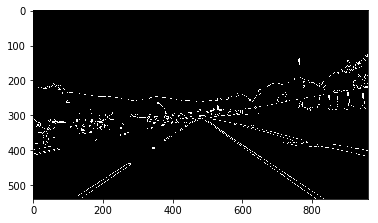

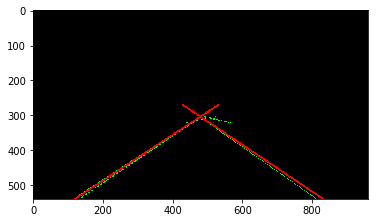

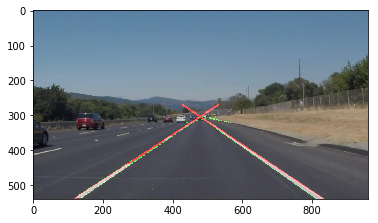

 39%|███▊      | 86/222 [01:06<01:39,  1.37it/s]

[  -0.65833601  620.22099477]

[  0.6670527  -15.32663947]



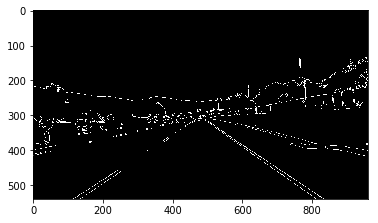

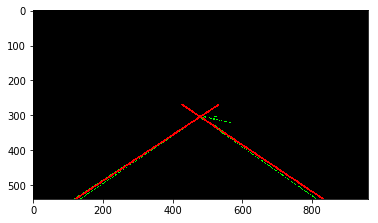

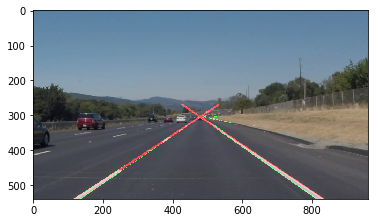

 39%|███▉      | 87/222 [01:07<01:40,  1.34it/s]

[  -0.65450381  619.38030814]

[  0.67768164 -20.23160454]



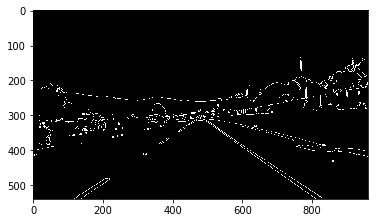

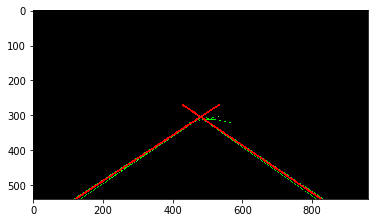

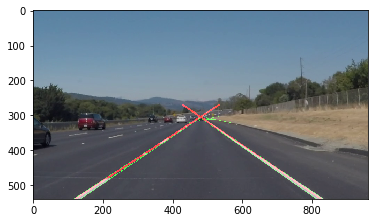

 40%|███▉      | 88/222 [01:07<01:41,  1.32it/s]

[  -0.65834019  620.70867408]

[  0.67876486 -18.28414442]



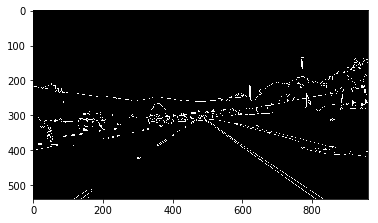

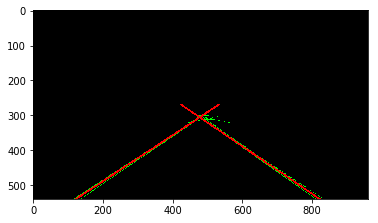

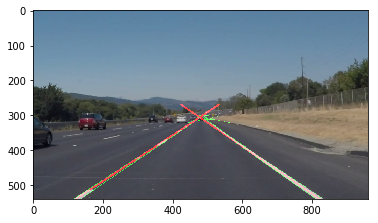

 40%|████      | 89/222 [01:08<01:38,  1.35it/s]

[  -0.62845473  607.23745846]

[  0.67087805 -15.69354507]



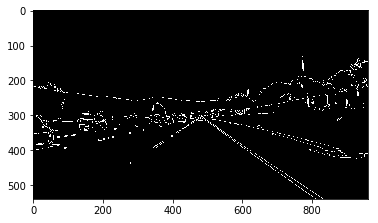

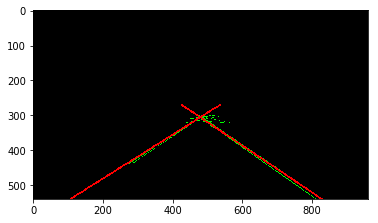

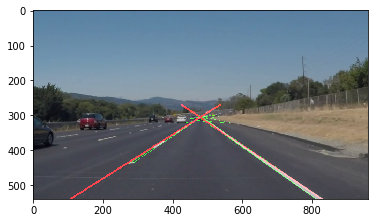

 41%|████      | 90/222 [01:09<01:34,  1.40it/s]

[  -0.62441912  607.41744825]

[  0.67181219 -16.10647426]



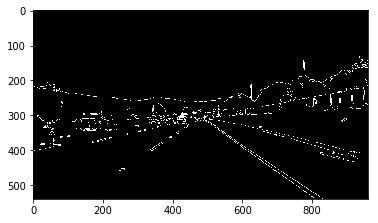

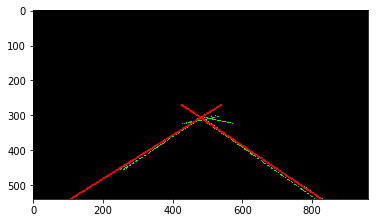

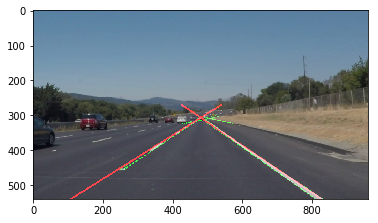

 41%|████      | 91/222 [01:09<01:32,  1.41it/s]

[  -0.64674947  617.20644468]

[  0.68202018 -21.32816035]



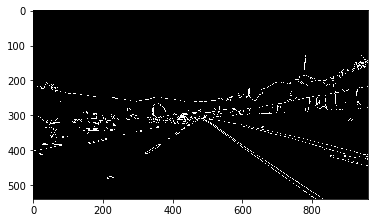

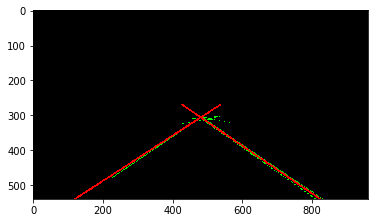

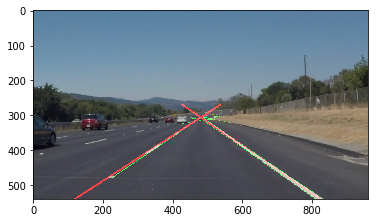

 41%|████▏     | 92/222 [01:10<01:30,  1.44it/s]

[  -0.63228258  611.77675878]

[  0.67337078 -17.80199503]



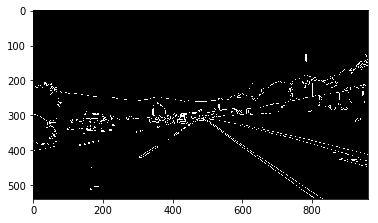

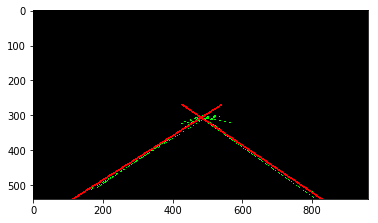

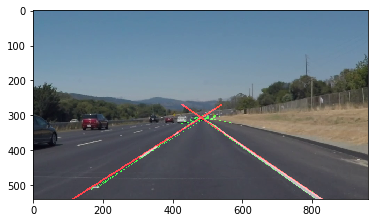

 42%|████▏     | 93/222 [01:11<01:34,  1.37it/s]

[  -0.63432215  611.97197441]

[  0.67900829 -20.58758286]



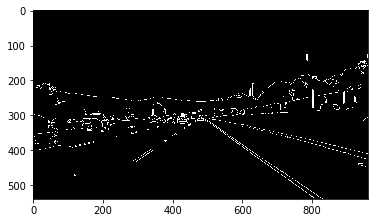

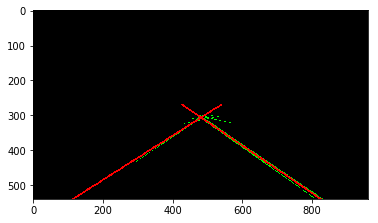

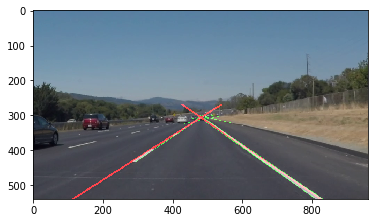

 42%|████▏     | 94/222 [01:12<01:34,  1.36it/s]

[  -0.65524223  620.76440932]

[  0.67865246 -21.23615465]



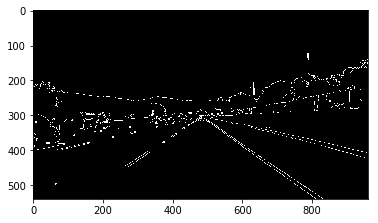

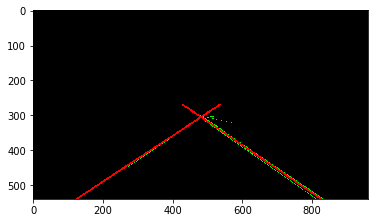

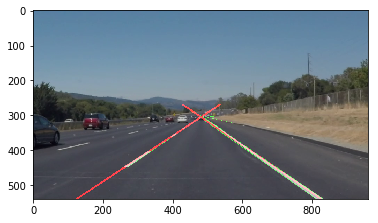

 43%|████▎     | 95/222 [01:12<01:30,  1.40it/s]

[  -0.64815482  617.47433908]

[  0.67982068 -22.96679212]



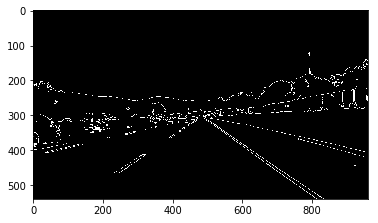

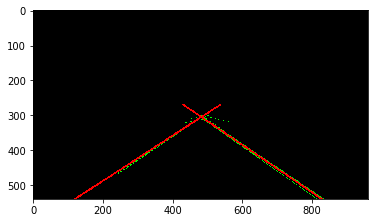

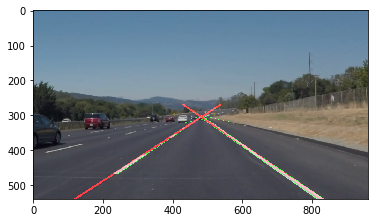

 43%|████▎     | 96/222 [01:13<01:30,  1.39it/s]

[  -0.64205189  614.40904397]

[  0.70481496 -42.3857906 ]



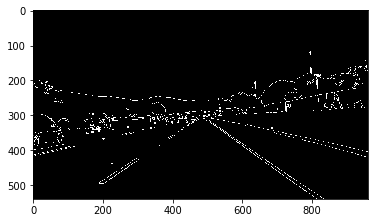

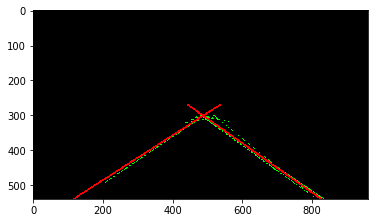

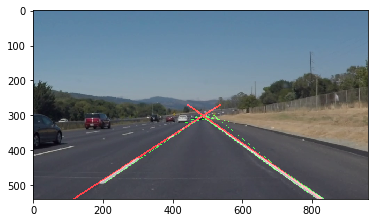

 44%|████▎     | 97/222 [01:14<01:33,  1.34it/s]

[  -0.65602849  621.03810982]

[  0.69723377 -33.76861444]



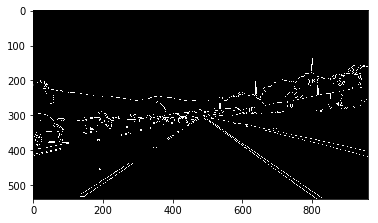

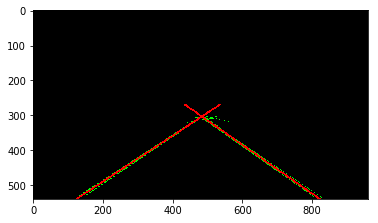

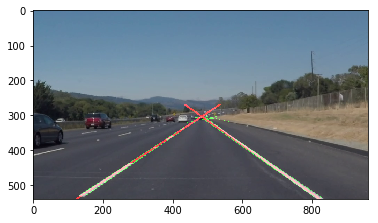

 44%|████▍     | 98/222 [01:15<01:36,  1.28it/s]

[  -0.6556502   619.58419043]

[  0.67751857 -22.4206595 ]



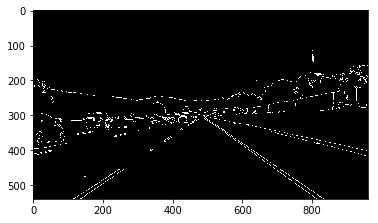

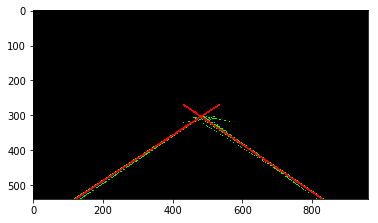

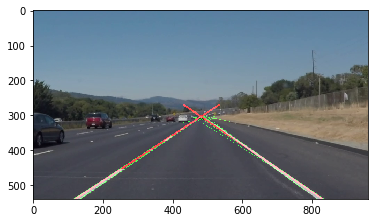

 45%|████▍     | 99/222 [01:16<01:42,  1.20it/s]

[  -0.65891089  619.4885838 ]

[  0.69028128 -32.27130937]



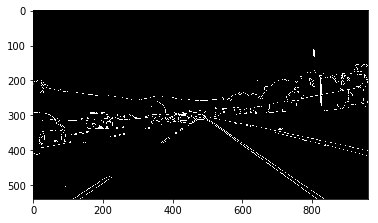

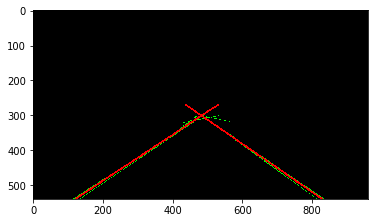

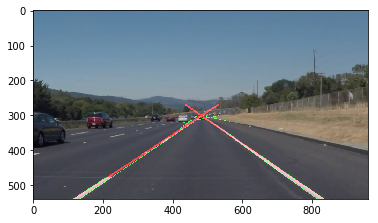

 45%|████▌     | 100/222 [01:17<01:47,  1.14it/s]

[  -0.62779633  608.56251666]

[  0.70513002 -40.77816066]



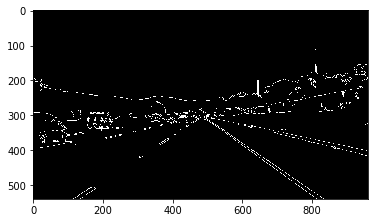

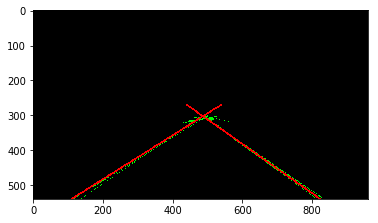

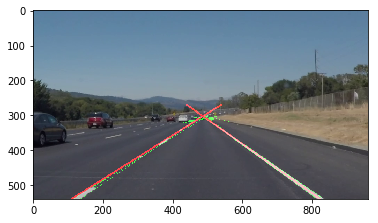

 45%|████▌     | 101/222 [01:17<01:41,  1.19it/s]

[  -0.67024034  627.23108263]

[  0.67890545 -23.86905225]



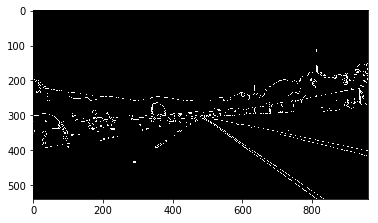

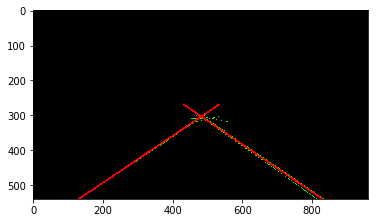

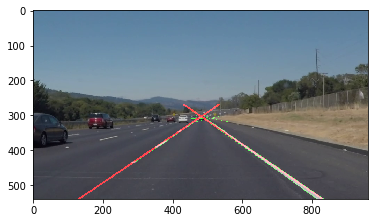

 46%|████▌     | 102/222 [01:18<01:39,  1.21it/s]

[  -0.61288064  604.05346337]

[  0.68629087 -26.82525409]



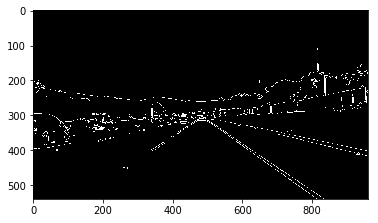

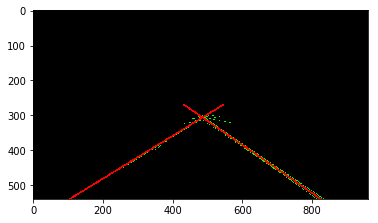

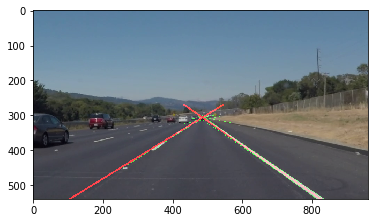

 46%|████▋     | 103/222 [01:19<01:35,  1.24it/s]

[  -0.65060053  620.73570606]

[  0.68005543 -23.72173978]



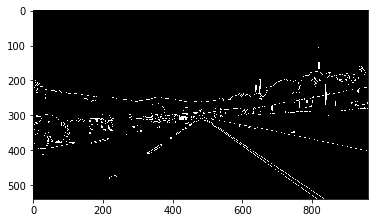

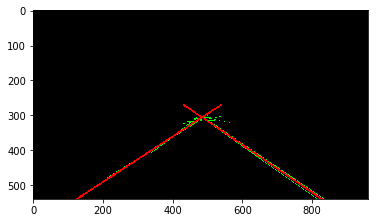

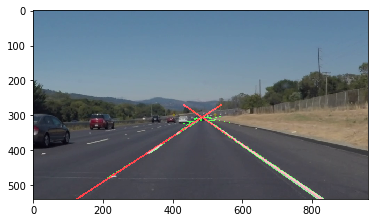

 47%|████▋     | 104/222 [01:20<01:31,  1.29it/s]

[  -0.66397282  625.87009597]

[  0.67826417 -24.048272  ]



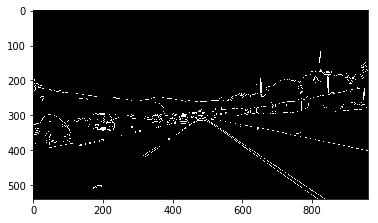

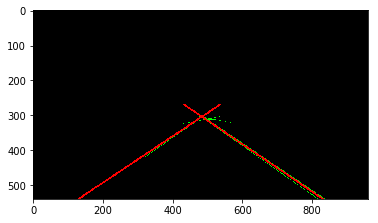

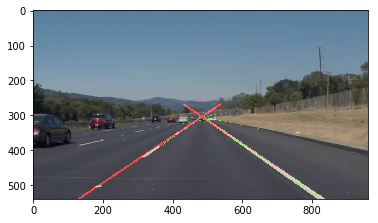

 47%|████▋     | 105/222 [01:20<01:29,  1.30it/s]

[  -0.64175016  616.61058537]

[  0.67617372 -23.97264241]



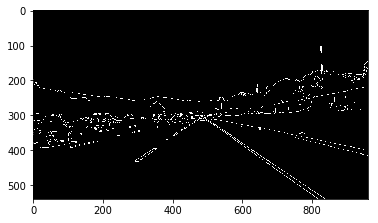

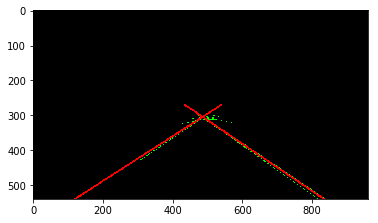

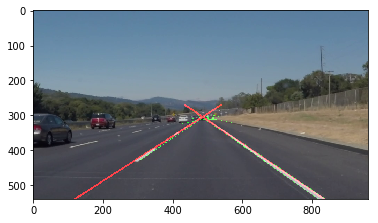

 48%|████▊     | 106/222 [01:21<01:27,  1.32it/s]

[  -0.65824737  620.99006217]

[  0.68339781 -27.65170007]



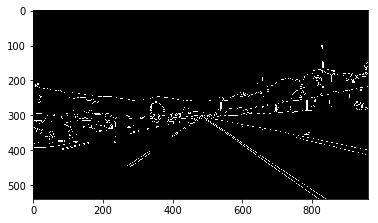

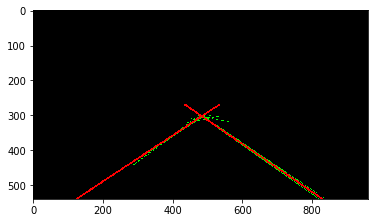

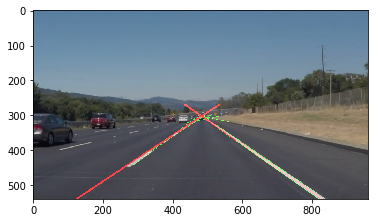

 48%|████▊     | 107/222 [01:22<01:24,  1.36it/s]

[  -0.64993603  619.9422431 ]

[  0.66761923 -17.67874253]



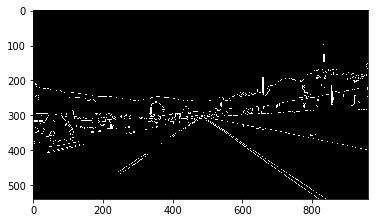

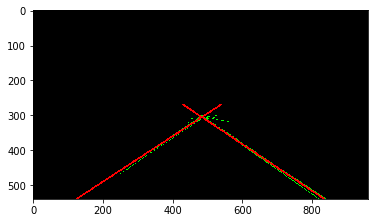

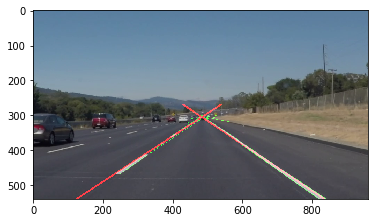

 49%|████▊     | 108/222 [01:22<01:20,  1.42it/s]

[  -0.67090597  628.10669674]

[  0.67783651 -25.51017408]



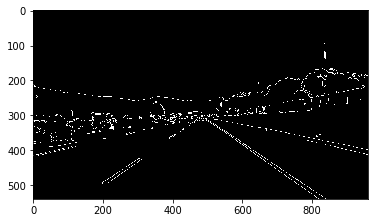

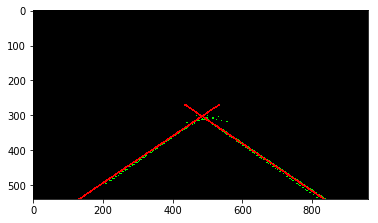

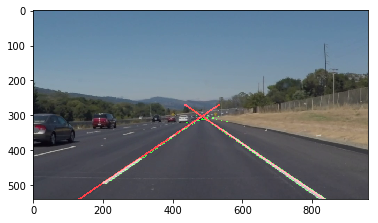

 49%|████▉     | 109/222 [01:23<01:20,  1.40it/s]

[  -0.67230357  629.31085964]

[  0.67502708 -22.96732416]



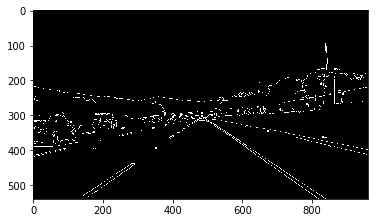

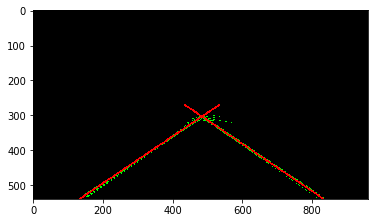

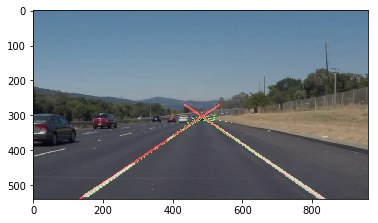

 50%|████▉     | 110/222 [01:24<01:21,  1.37it/s]

[  -0.67727545  631.5322648 ]

[  0.67458994 -23.36014598]



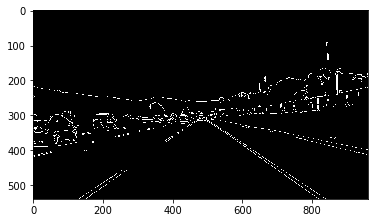

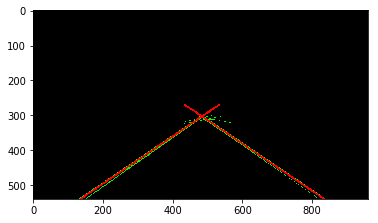

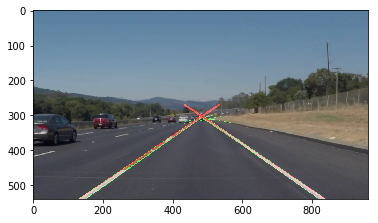

 50%|█████     | 111/222 [01:25<01:18,  1.41it/s]

[  -0.66660149  626.46207797]

[  0.68044811 -25.66928722]



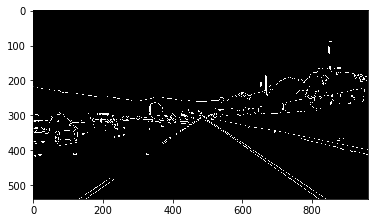

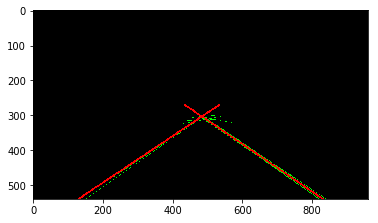

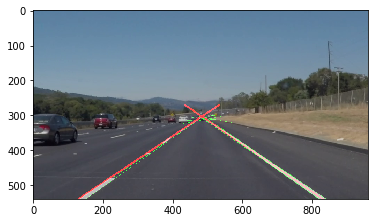

 50%|█████     | 112/222 [01:25<01:16,  1.44it/s]

[  -0.68312871  633.97850746]

[  0.6798273  -26.91046723]



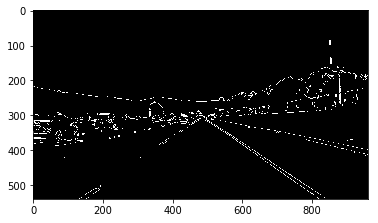

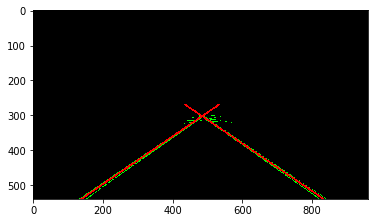

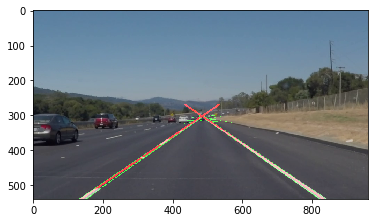

 51%|█████     | 113/222 [01:26<01:17,  1.41it/s]

[  -0.62023566  604.710716  ]

[  0.65448001 -11.62540144]



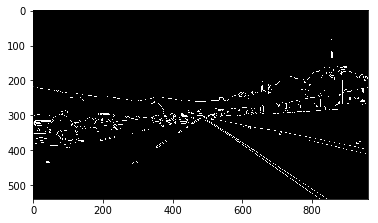

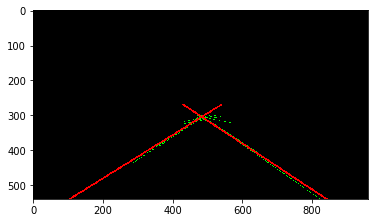

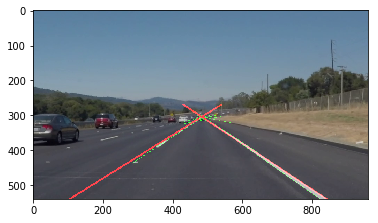

 51%|█████▏    | 114/222 [01:27<01:18,  1.37it/s]

[  -0.6590014   623.23760521]

[  0.65987192 -17.36730507]



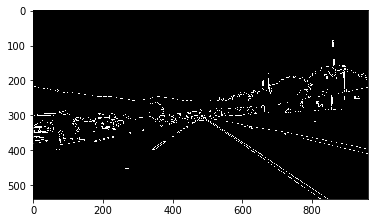

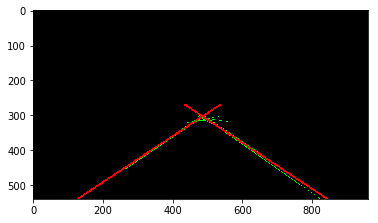

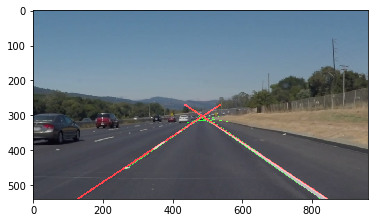

 52%|█████▏    | 115/222 [01:28<01:21,  1.31it/s]

[  -0.64607187  618.42409299]

[  0.65454653 -12.41829605]



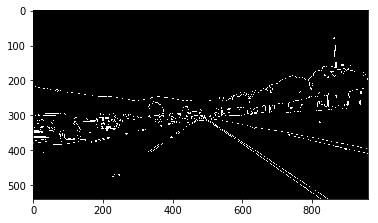

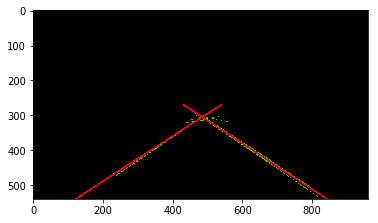

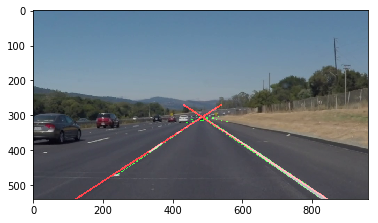

 52%|█████▏    | 116/222 [01:28<01:17,  1.37it/s]

[  -0.65556863  623.46917763]

[  0.66350403 -21.1232669 ]



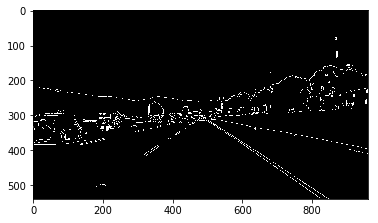

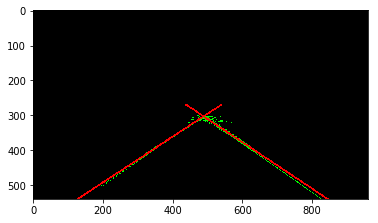

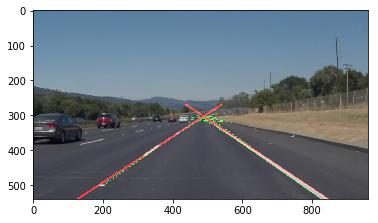

 53%|█████▎    | 117/222 [01:29<01:17,  1.35it/s]

[  -0.64238487  615.6498959 ]

[  0.65254958 -11.62863913]



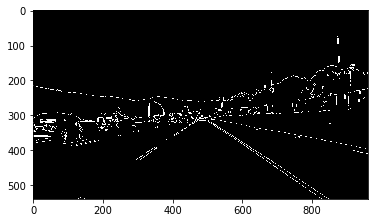

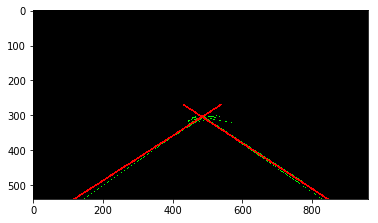

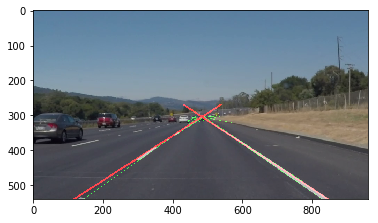

 53%|█████▎    | 118/222 [01:30<01:19,  1.30it/s]

[  -0.64996947  618.84195441]

[  0.65831939 -14.31067976]



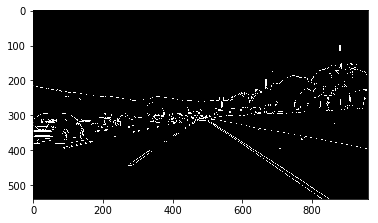

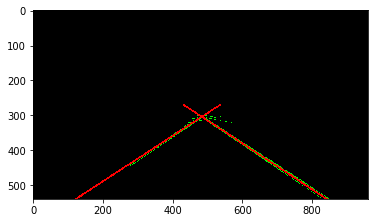

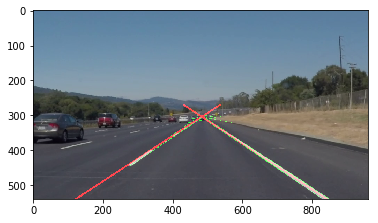

 54%|█████▎    | 119/222 [01:31<01:16,  1.34it/s]

[  -0.68259855  631.39004151]

[  0.65386217 -12.34318391]



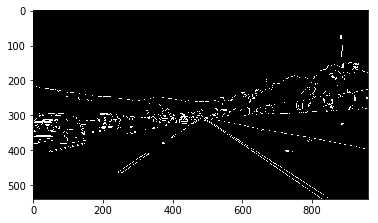

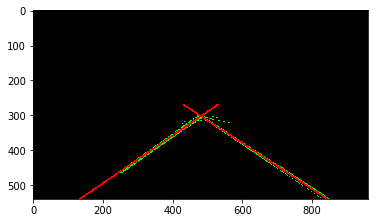

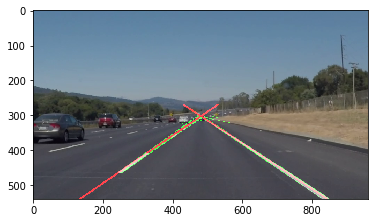

 54%|█████▍    | 120/222 [01:31<01:12,  1.41it/s]

[  -0.66899987  628.42017009]

[ 0.63868729 -2.67692159]



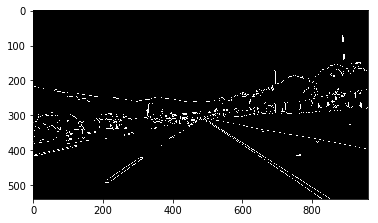

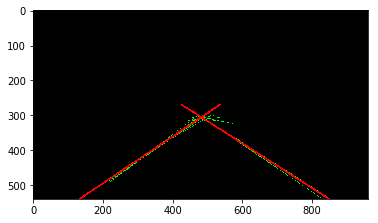

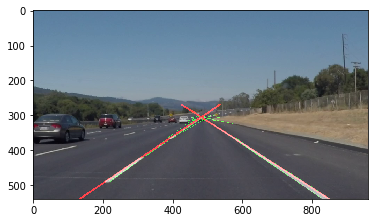

 55%|█████▍    | 121/222 [01:32<01:14,  1.36it/s]

[  -0.6595255   624.17777727]

[ 0.65019962 -9.71376401]



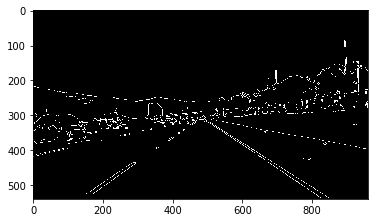

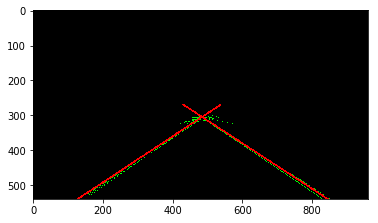

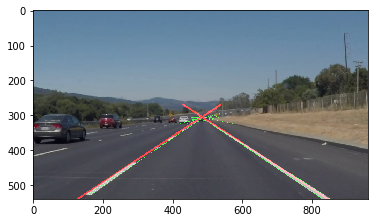

 55%|█████▍    | 122/222 [01:33<01:17,  1.29it/s]

[  -0.69189548  638.82299903]

[ 0.62886925  2.60292793]



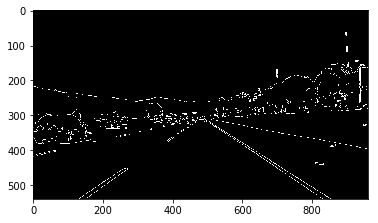

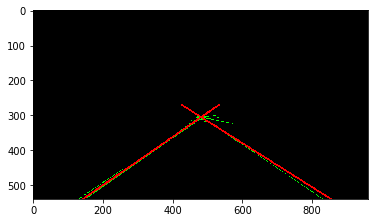

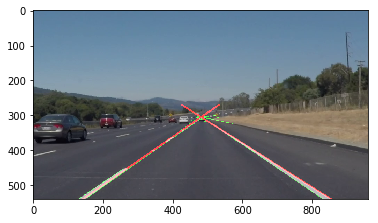

 55%|█████▌    | 123/222 [01:33<01:14,  1.33it/s]

[  -0.65361507  623.5900101 ]

[ 0.62298749  6.6090393 ]



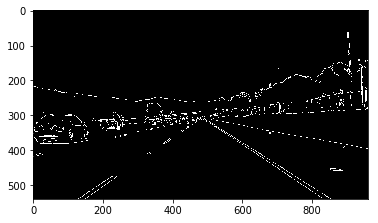

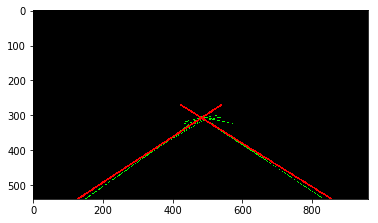

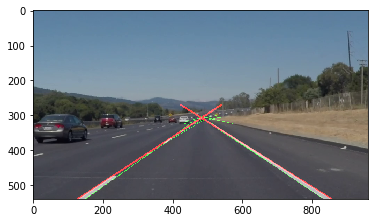

 56%|█████▌    | 124/222 [01:34<01:10,  1.38it/s]

[  -0.66327463  628.26057277]

[ 0.6277005   3.52906302]



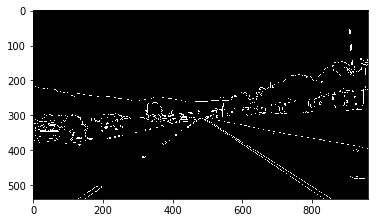

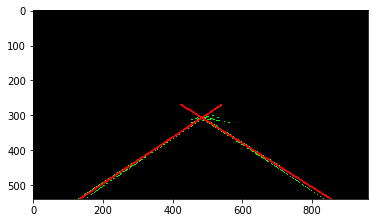

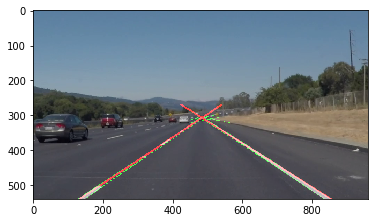

 56%|█████▋    | 125/222 [01:35<01:07,  1.44it/s]

[  -0.65122235  621.80618473]

[ 0.63944687 -4.56744687]



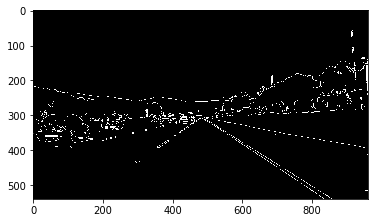

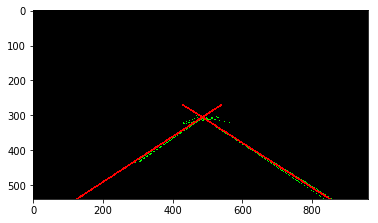

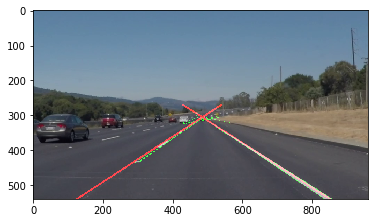

 57%|█████▋    | 126/222 [01:36<01:09,  1.38it/s]

[  -0.65590581  623.49923216]

[ 0.62652188  2.95930963]



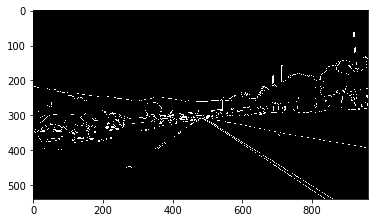

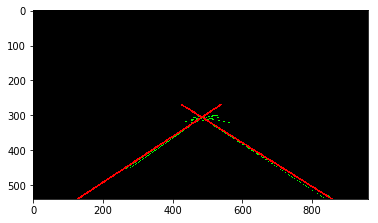

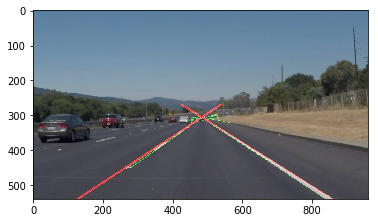

 57%|█████▋    | 127/222 [01:36<01:06,  1.43it/s]

[  -0.65699179  624.26606107]

[ 0.62392304  3.91254137]



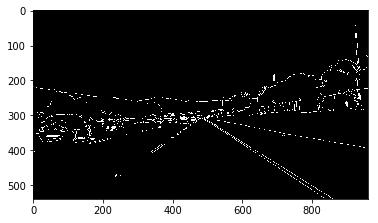

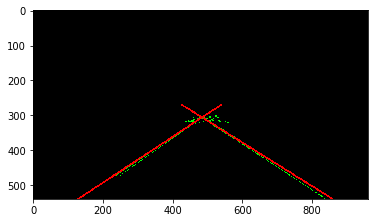

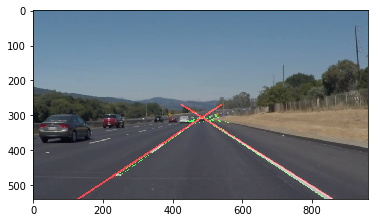

 58%|█████▊    | 128/222 [01:37<01:03,  1.48it/s]

[  -0.65506414  624.51921261]

[ 0.62563429  3.76652996]



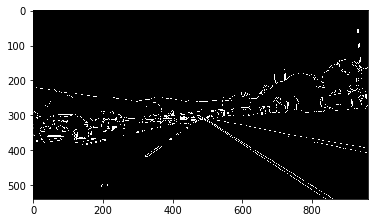

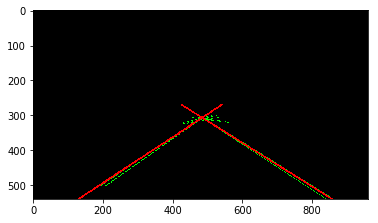

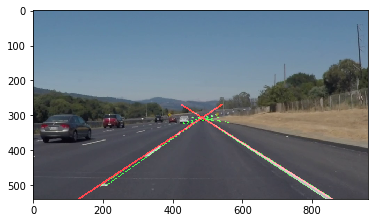

 58%|█████▊    | 129/222 [01:37<01:02,  1.49it/s]

[  -0.67622538  633.77253953]

[ 0.6304277   1.40757126]



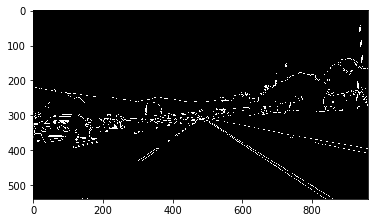

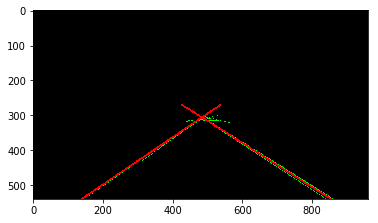

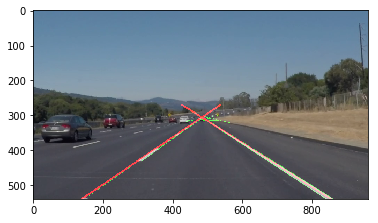

 59%|█████▊    | 130/222 [01:38<01:00,  1.51it/s]

[  -0.67025306  629.37563159]

[ 0.63299434  0.51406375]



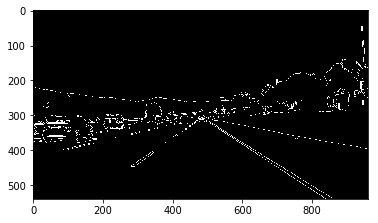

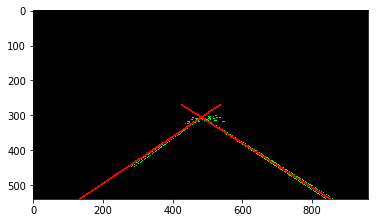

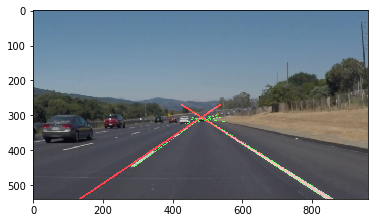

 59%|█████▉    | 131/222 [01:39<00:59,  1.53it/s]

[  -0.66401711  631.51020419]

[ 0.62636624  4.02489956]



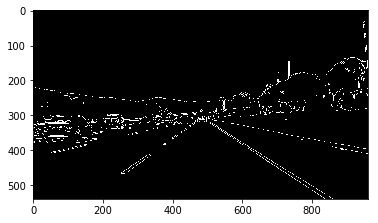

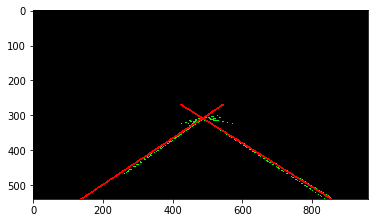

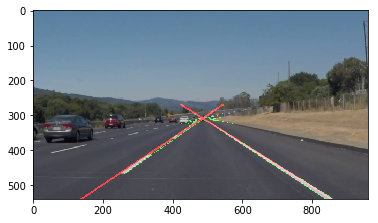

 59%|█████▉    | 132/222 [01:39<00:57,  1.56it/s]

[  -0.70058706  645.0859448 ]

[ 0.62906861  2.41823881]



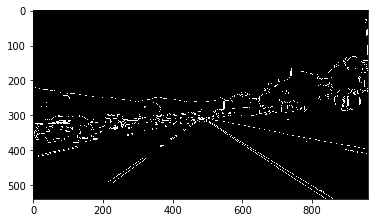

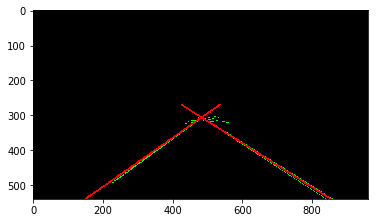

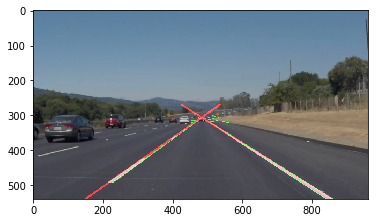

 60%|█████▉    | 133/222 [01:40<01:00,  1.46it/s]

[  -0.68433369  635.98959498]

[ 0.62544323  3.73525301]



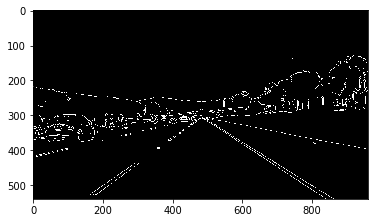

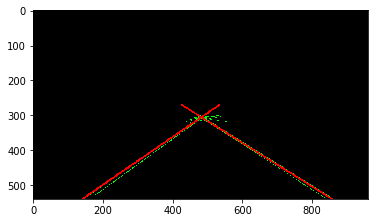

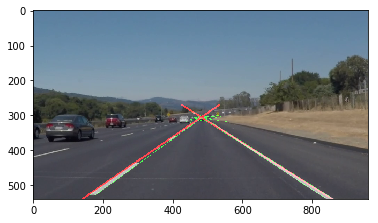

 60%|██████    | 134/222 [01:41<01:01,  1.42it/s]

[  -0.69822088  639.70177873]

[ 0.62826188  1.30214889]



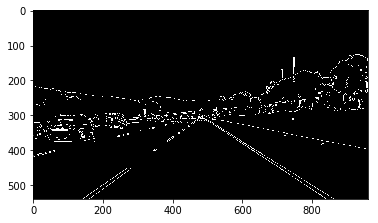

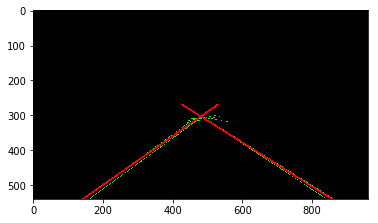

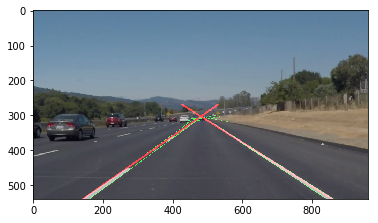

 61%|██████    | 135/222 [01:42<01:02,  1.39it/s]

[  -0.70154792  642.14491369]

[ 0.62633513  0.65747614]



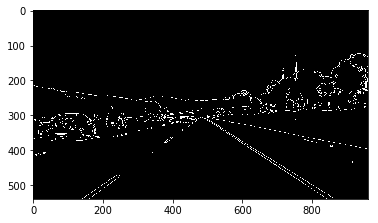

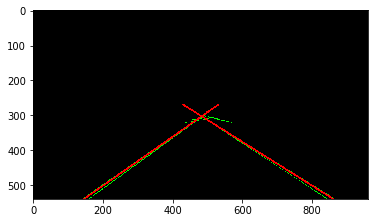

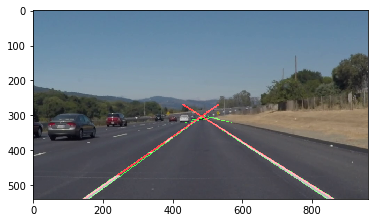

 61%|██████▏   | 136/222 [01:42<01:03,  1.36it/s]

[  -0.69615421  638.72188872]

[ 0.63056338 -2.07070937]



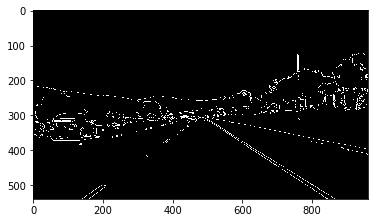

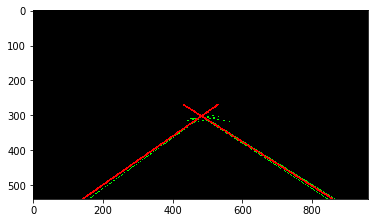

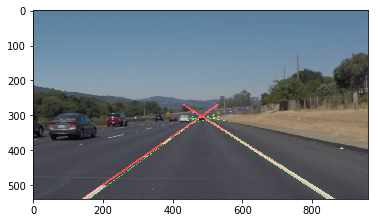

 62%|██████▏   | 137/222 [01:43<01:03,  1.33it/s]

[  -0.67174944  628.3159277 ]

[ 0.62900509 -1.19102671]



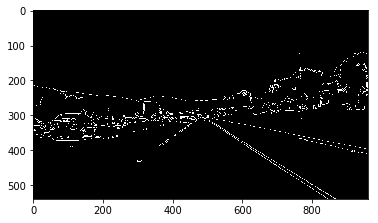

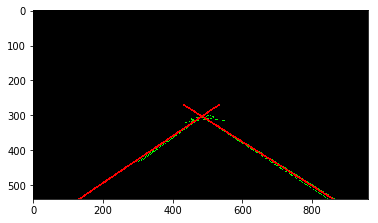

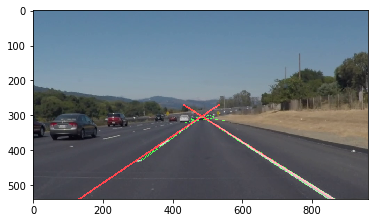

 62%|██████▏   | 138/222 [01:44<01:03,  1.33it/s]

[  -0.68210146  633.67262638]

[ 0.63411273 -2.50817928]



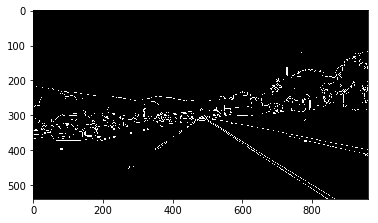

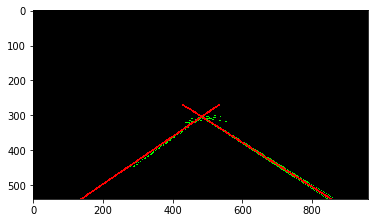

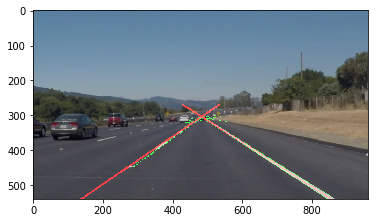

 63%|██████▎   | 139/222 [01:45<01:02,  1.33it/s]

[  -0.69634346  642.35686201]

[ 0.62467434  3.64877686]



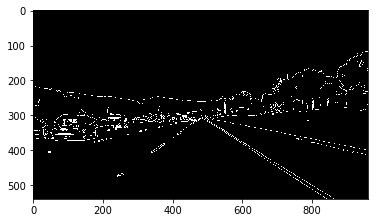

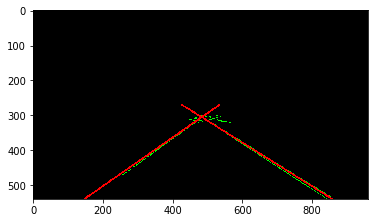

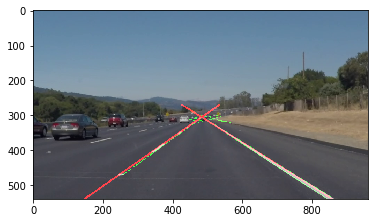

 63%|██████▎   | 140/222 [01:45<01:00,  1.35it/s]

[  -0.66359629  627.55399808]

[ 0.63318556  0.14611471]



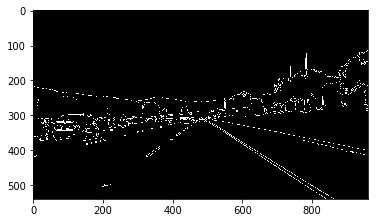

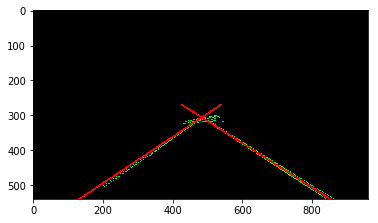

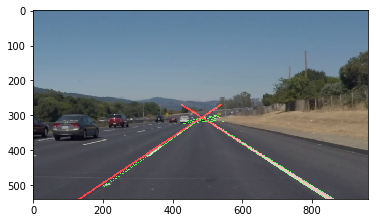

 64%|██████▎   | 141/222 [01:46<00:57,  1.41it/s]

[  -0.67747425  635.99632422]

[ 0.62499594  5.25484351]



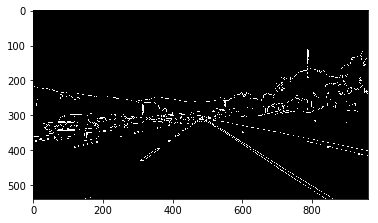

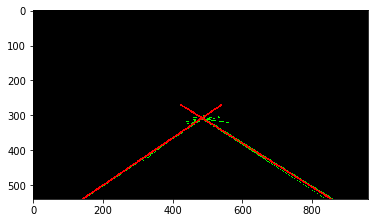

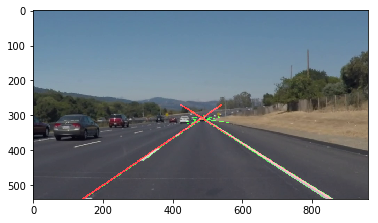

 64%|██████▍   | 142/222 [01:47<00:54,  1.46it/s]

[  -0.69871855  645.36642922]

[ 0.62234938  5.57350792]



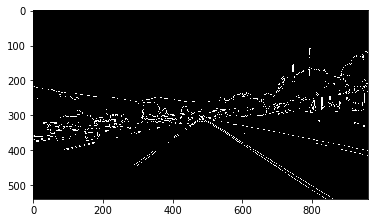

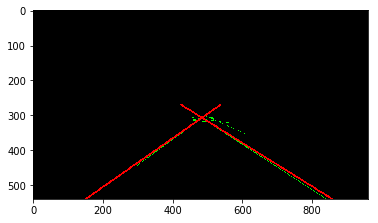

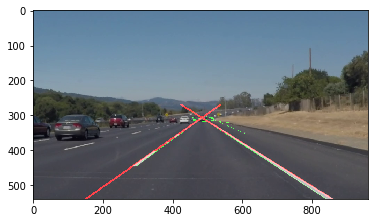

 64%|██████▍   | 143/222 [01:47<00:52,  1.50it/s]

[  -0.68377587  636.79545956]

[ 0.62872719  1.87604232]



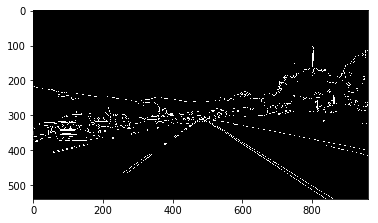

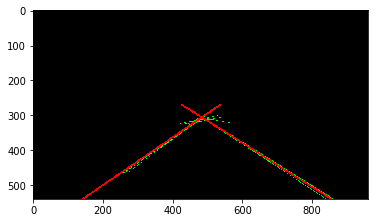

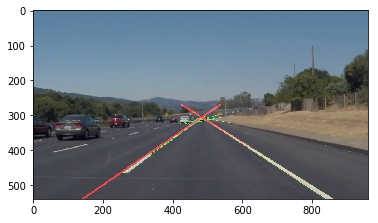

 65%|██████▍   | 144/222 [01:48<00:53,  1.46it/s]

[  -0.69526265  645.18411123]

[ 0.62535364  3.49156344]



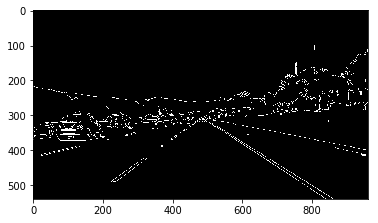

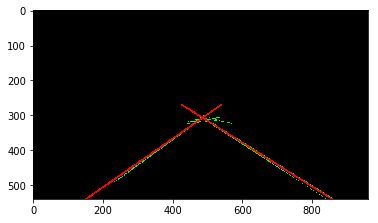

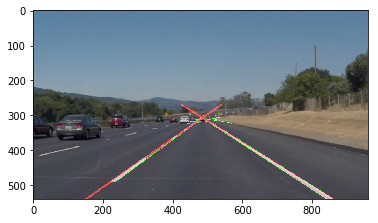

 65%|██████▌   | 145/222 [01:49<00:50,  1.51it/s]

[  -0.7110158   648.34581996]

[ 0.62840226  0.57787615]



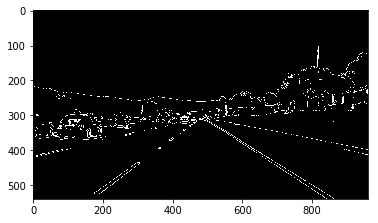

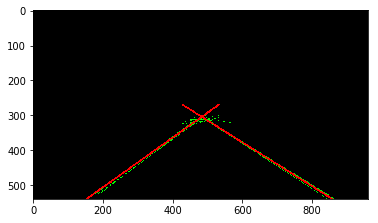

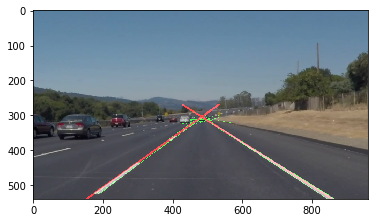

 66%|██████▌   | 146/222 [01:49<00:50,  1.51it/s]

[  -0.69373831  642.23106112]

[ 0.62470318  1.11240514]



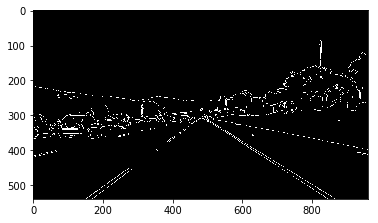

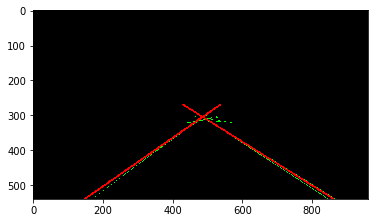

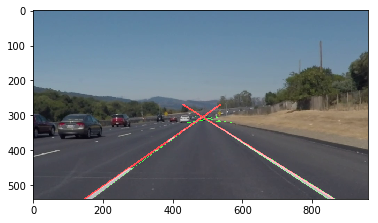

 66%|██████▌   | 147/222 [01:50<00:49,  1.50it/s]

[  -0.70466718  644.85082497]

[ 0.63038033 -2.68160866]



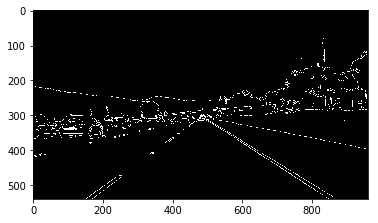

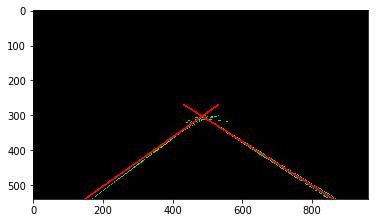

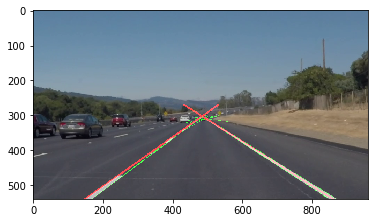

 67%|██████▋   | 148/222 [01:51<00:51,  1.43it/s]

[  -0.70051584  645.36809343]

[ 0.62560529 -0.38608713]



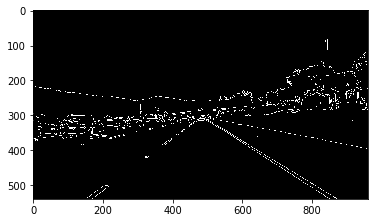

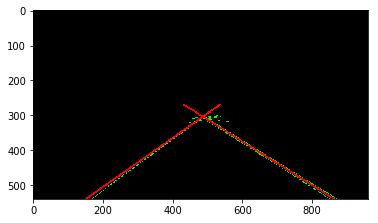

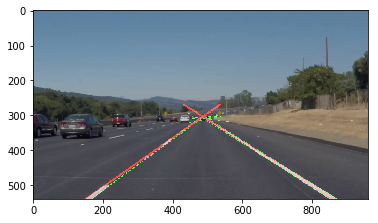

 67%|██████▋   | 149/222 [01:51<00:49,  1.48it/s]

[  -0.70622581  646.17936113]

[  0.61040559  10.52675463]



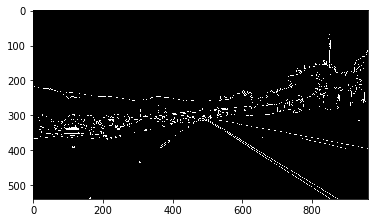

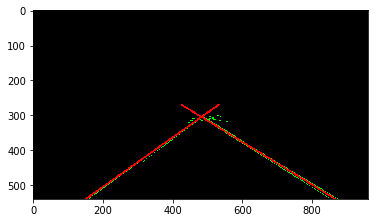

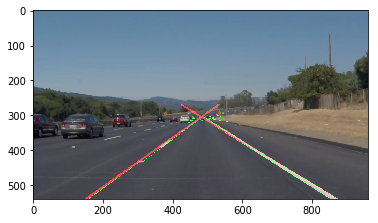

 68%|██████▊   | 150/222 [01:52<00:50,  1.44it/s]

[  -0.69309045  642.4510218 ]

[ 0.62183723  2.52614333]



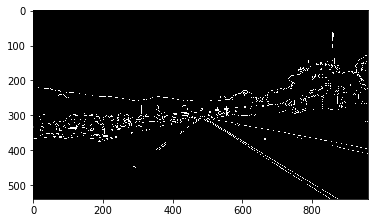

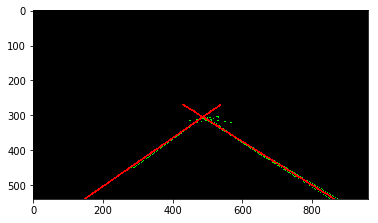

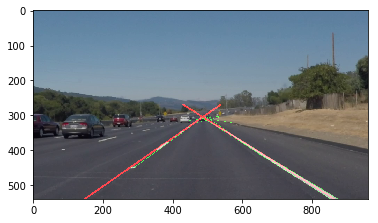

 68%|██████▊   | 151/222 [01:53<00:51,  1.37it/s]

[  -0.68504677  639.66492507]

[ 0.62620104  0.7155156 ]



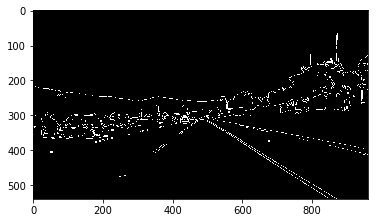

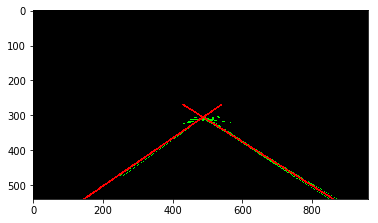

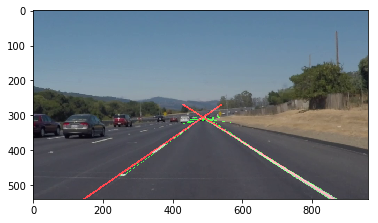

 68%|██████▊   | 152/222 [01:54<00:51,  1.36it/s]

[  -0.72165248  653.19936397]

[  0.60495454  15.70645231]



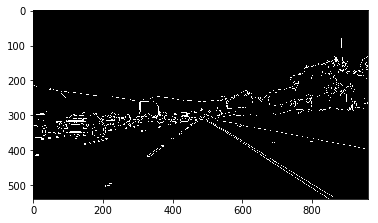

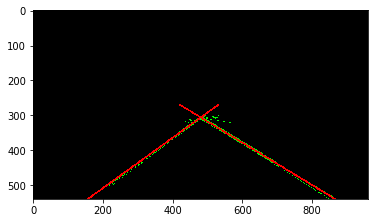

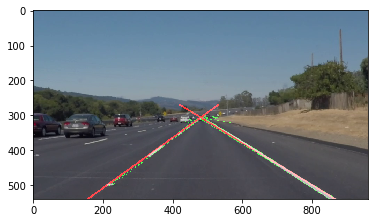

 69%|██████▉   | 153/222 [01:54<00:48,  1.41it/s]

[  -0.72786137  656.78823035]

[  0.59616414  19.91239819]



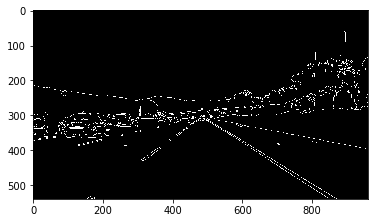

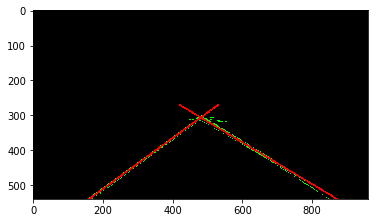

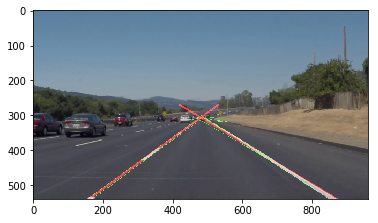

 69%|██████▉   | 154/222 [01:55<00:46,  1.47it/s]

[  -0.69680799  644.27312445]

[ 0.61000542  7.62054277]



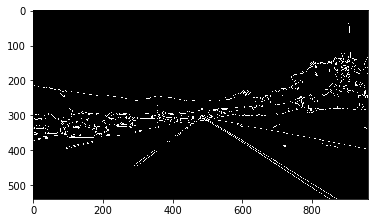

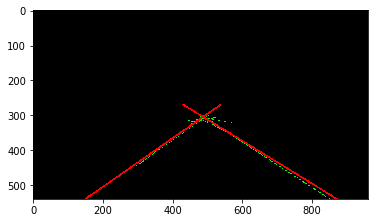

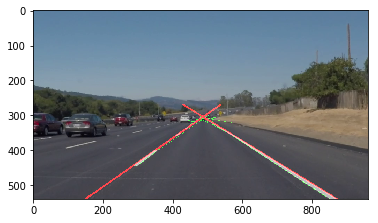

 70%|██████▉   | 155/222 [01:56<00:46,  1.45it/s]

[  -0.73110385  656.86245119]

[ 0.6258664  -2.56552017]



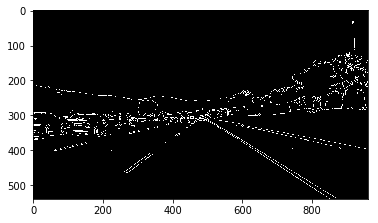

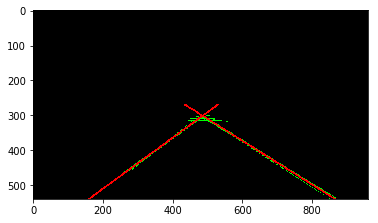

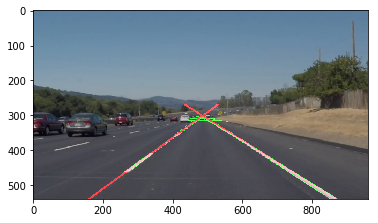

 70%|███████   | 156/222 [01:56<00:44,  1.47it/s]

[  -0.75145751  665.43323222]

[ 0.62158906 -1.04707941]



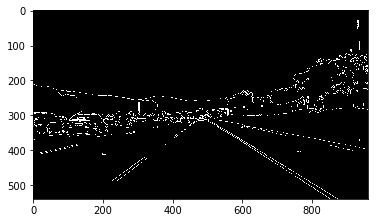

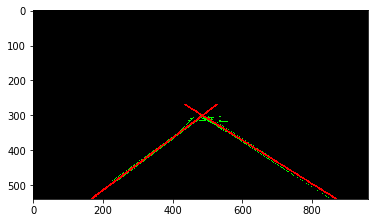

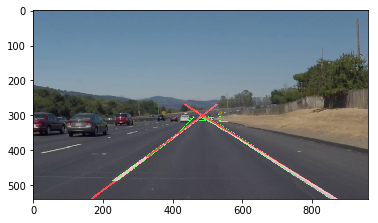

 71%|███████   | 157/222 [01:57<00:43,  1.48it/s]

[  -0.71427086  649.38019335]

[ 0.6084593   9.42489837]



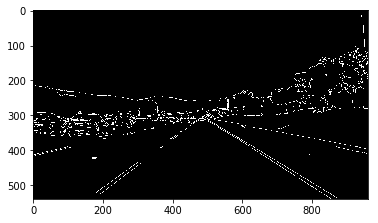

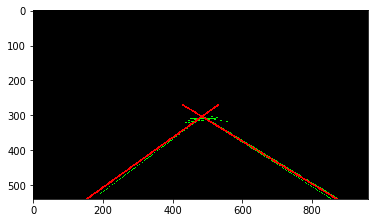

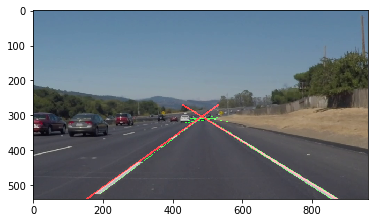

 71%|███████   | 158/222 [01:58<00:42,  1.52it/s]

[  -0.73907119  657.83412596]

[ 0.60947901  8.6985157 ]



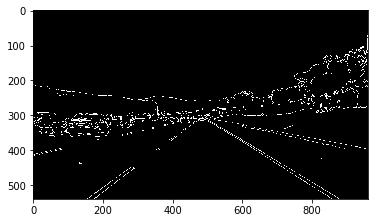

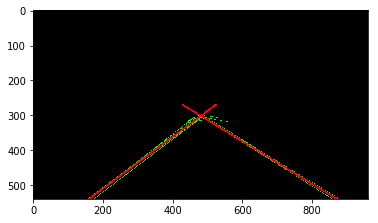

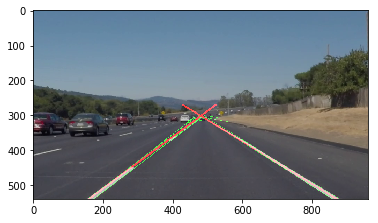

 72%|███████▏  | 159/222 [01:58<00:41,  1.50it/s]

[  -0.75111886  664.74038901]

[ 0.6077085   9.65881063]



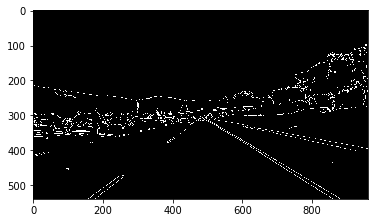

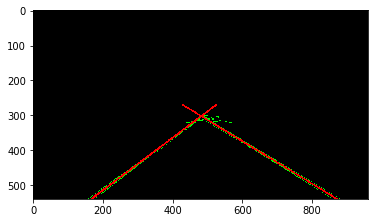

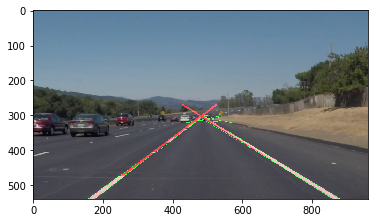

 72%|███████▏  | 160/222 [01:59<00:40,  1.52it/s]

[  -0.7112633   653.49675816]

[ 0.6077217   8.03759147]



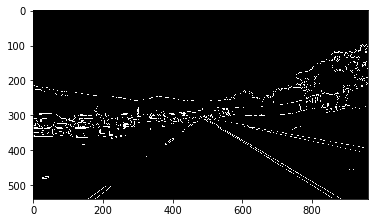

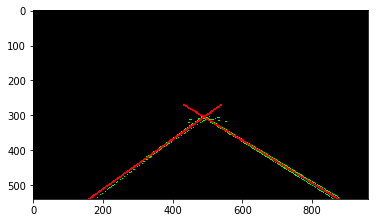

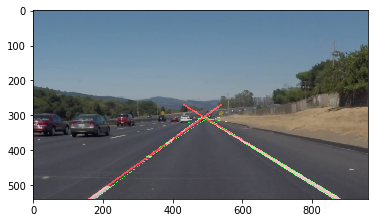

 73%|███████▎  | 161/222 [02:00<00:41,  1.47it/s]

[  -0.73112317  659.4290775 ]

[  0.60083636  11.31228008]



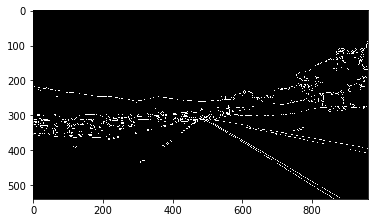

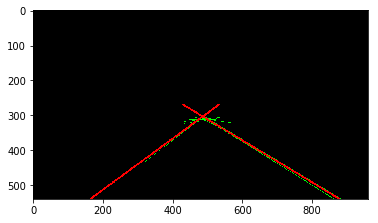

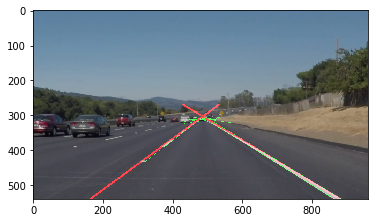

 73%|███████▎  | 162/222 [02:00<00:42,  1.43it/s]

[  -0.74228103  663.83132412]

[ 0.61034581  5.12640871]



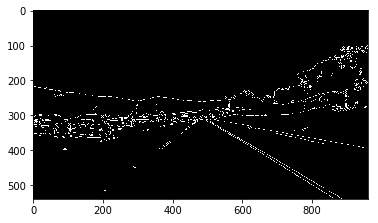

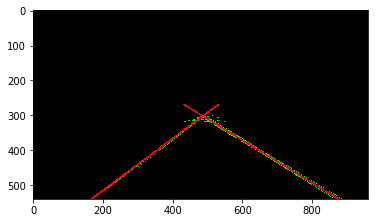

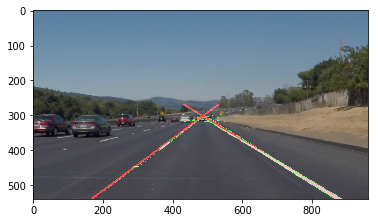

 73%|███████▎  | 163/222 [02:01<00:42,  1.38it/s]

[  -0.68714944  639.31588338]

[  0.58110085  24.59735744]



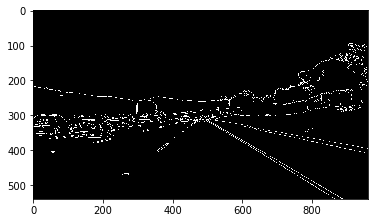

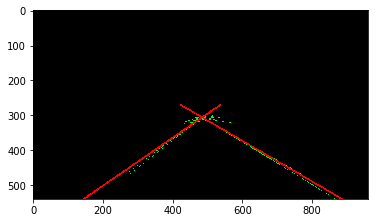

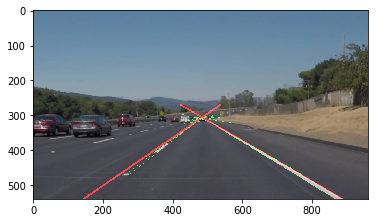

 74%|███████▍  | 164/222 [02:02<00:41,  1.39it/s]

[  -0.71953128  655.66815602]

[  0.57908115  26.51711783]



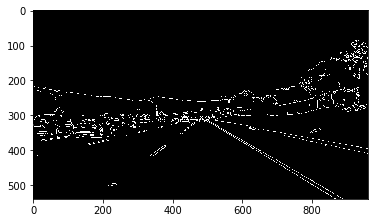

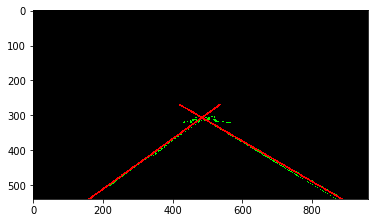

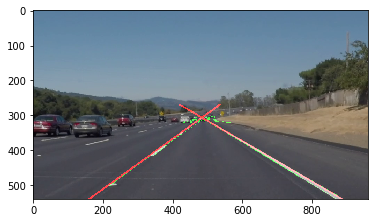

 74%|███████▍  | 165/222 [02:03<00:41,  1.37it/s]

[  -0.7453989   667.13588113]

[  0.57972544  26.51257532]



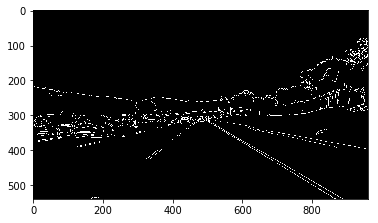

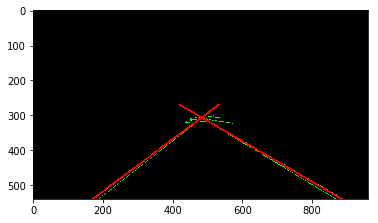

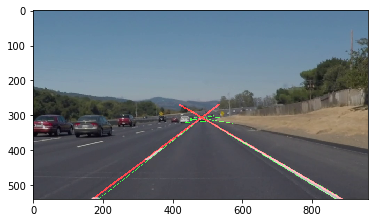

 75%|███████▍  | 166/222 [02:04<00:42,  1.31it/s]

[  -0.7445783   667.42775615]

[  0.58040718  27.46372091]



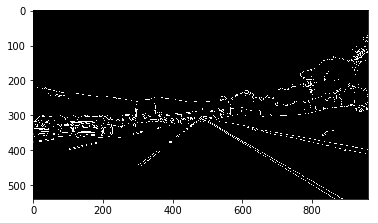

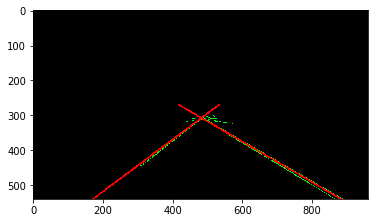

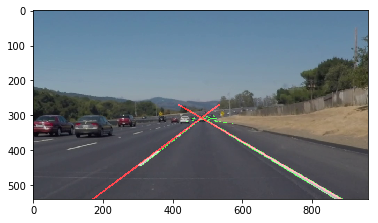

 75%|███████▌  | 167/222 [02:04<00:40,  1.36it/s]

[  -0.71806556  656.23785025]

[  0.58194254  26.19005918]



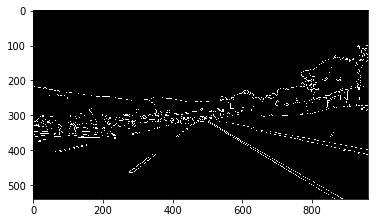

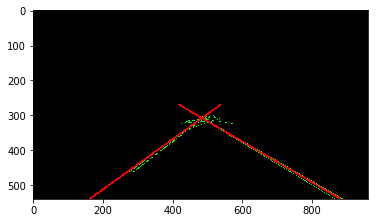

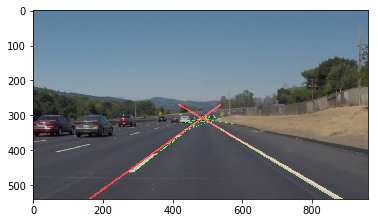

 76%|███████▌  | 168/222 [02:05<00:38,  1.41it/s]

[  -0.76378009  675.4901559 ]

[  0.58396237  26.41122245]



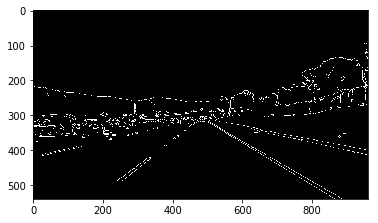

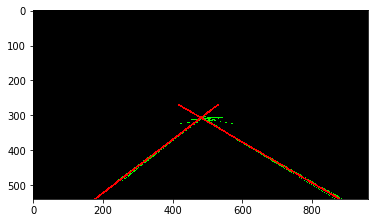

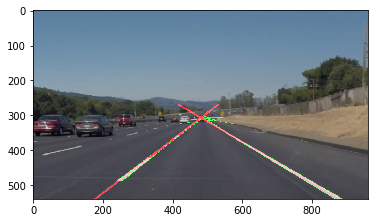

 76%|███████▌  | 169/222 [02:05<00:36,  1.46it/s]

[  -0.73474739  663.30441611]

[  0.58299744  25.86168   ]



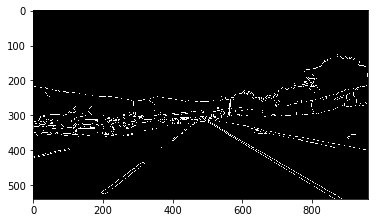

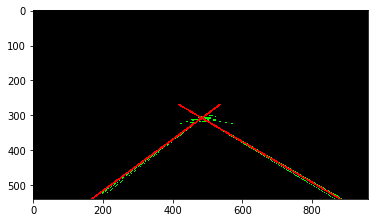

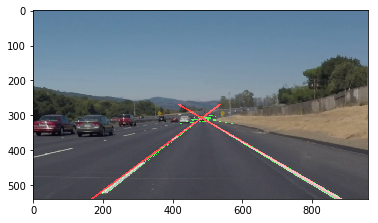

 77%|███████▋  | 170/222 [02:06<00:37,  1.38it/s]

[  -0.74562775  668.65976052]

[  0.5849707   25.53162054]



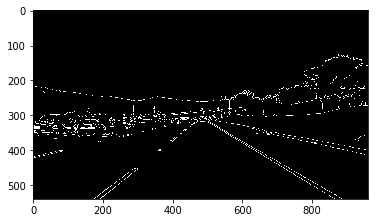

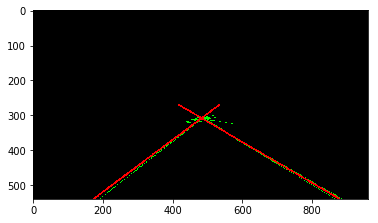

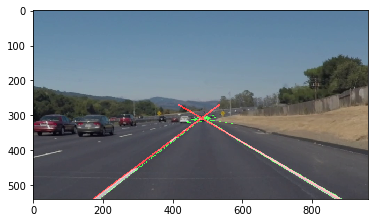

 77%|███████▋  | 171/222 [02:07<00:37,  1.36it/s]

[  -0.76031401  675.5508163 ]

[  0.57508598  30.15611446]



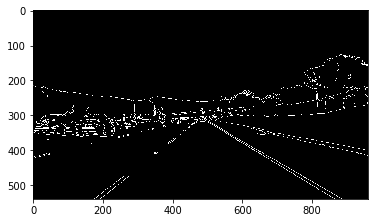

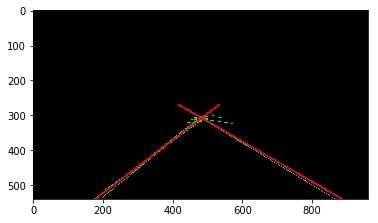

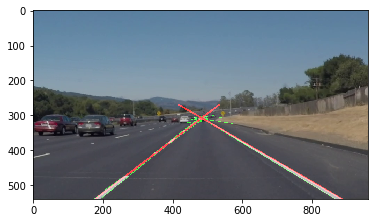

 77%|███████▋  | 172/222 [02:08<00:37,  1.35it/s]

[  -0.77026502  676.82259759]

[  0.5811886   27.37966555]



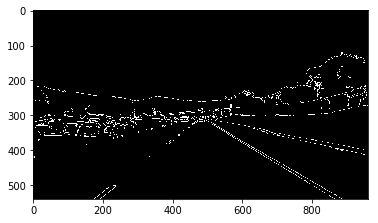

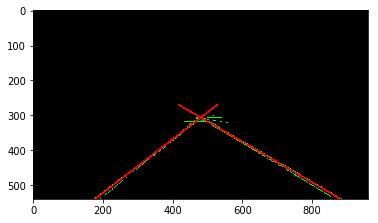

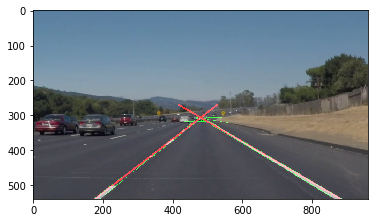

 78%|███████▊  | 173/222 [02:09<00:37,  1.32it/s]

[  -0.72474105  655.3504691 ]

[  0.57080949  31.79787651]



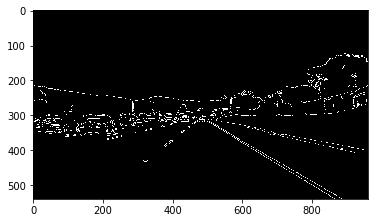

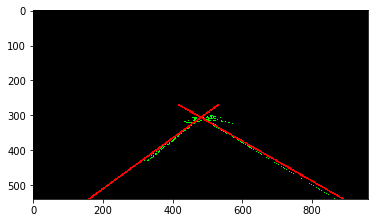

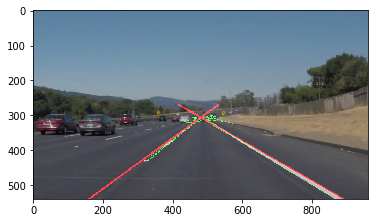

 78%|███████▊  | 174/222 [02:09<00:36,  1.33it/s]

[  -0.7264434   657.32263533]

[  0.57947127  27.55553684]



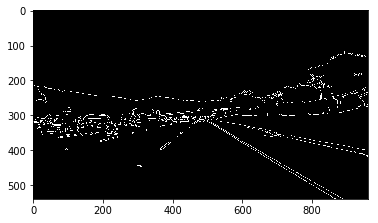

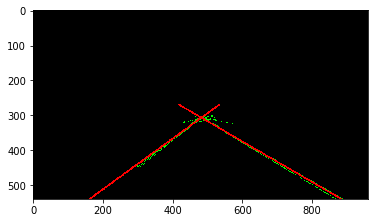

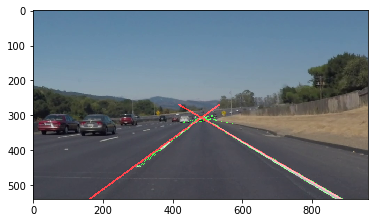

 79%|███████▉  | 175/222 [02:10<00:34,  1.38it/s]

[  -0.70056904  644.91358679]

[  0.58197187  26.96832892]



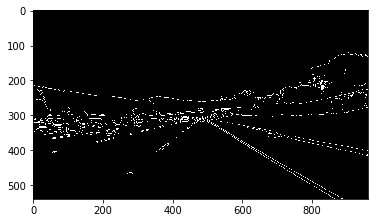

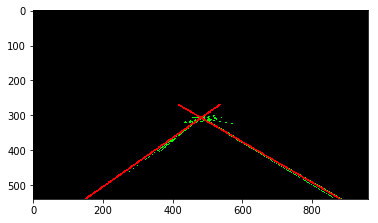

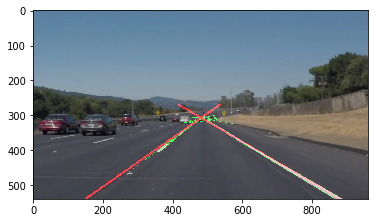

 79%|███████▉  | 176/222 [02:11<00:33,  1.38it/s]

[  -0.75037928  671.12732525]

[  0.58024746  28.30698491]



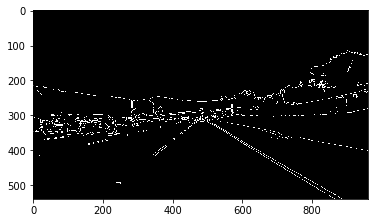

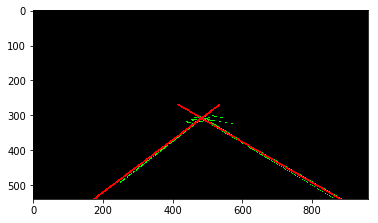

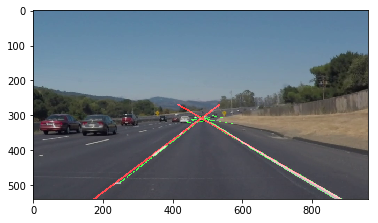

 80%|███████▉  | 177/222 [02:11<00:32,  1.40it/s]

[  -0.76582803  678.19217644]

[  0.57275018  31.13898782]



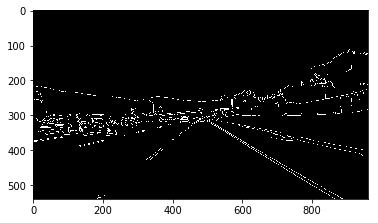

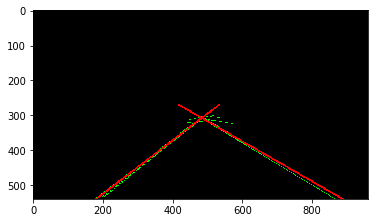

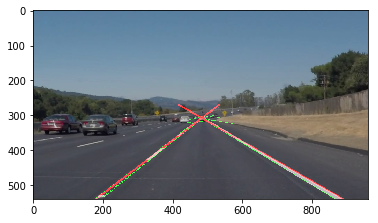

 80%|████████  | 178/222 [02:12<00:32,  1.37it/s]

[  -0.75596247  670.00525102]

[  0.58311527  25.35799884]



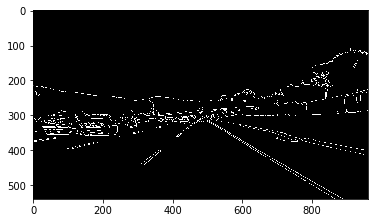

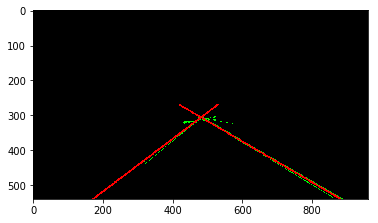

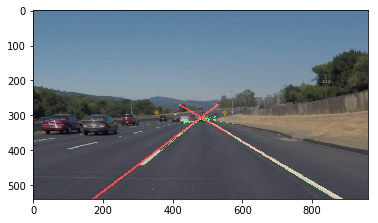

 81%|████████  | 179/222 [02:13<00:30,  1.41it/s]

[  -0.73175764  658.9652695 ]

[  0.58269859  24.47490641]



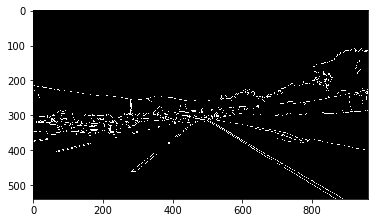

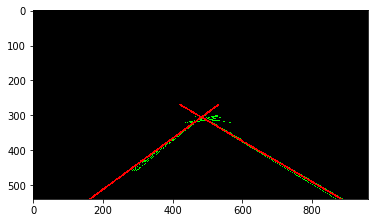

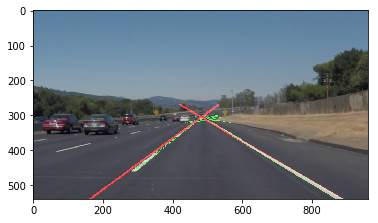

 81%|████████  | 180/222 [02:13<00:28,  1.46it/s]

[  -0.7719646   678.37155938]

[  0.58298264  24.25165566]



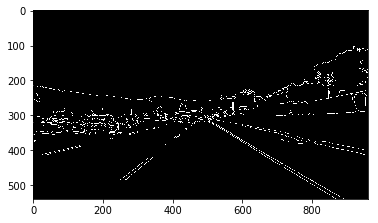

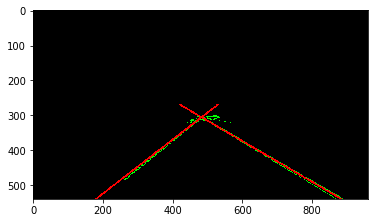

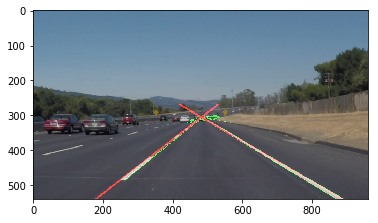

 82%|████████▏ | 181/222 [02:14<00:28,  1.43it/s]

[  -0.77838801  678.08325473]

[  0.57892412  25.66990759]



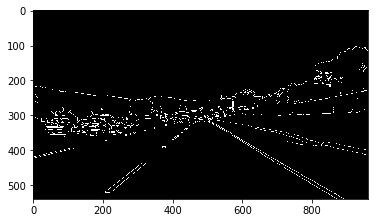

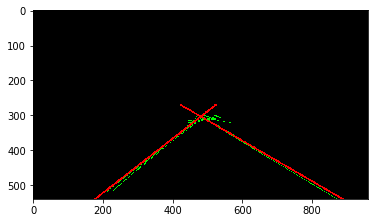

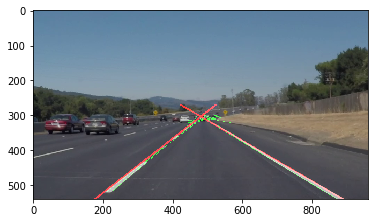

 82%|████████▏ | 182/222 [02:15<00:28,  1.40it/s]

[  -0.77377556  679.11141175]

[  0.58532369  23.67087674]



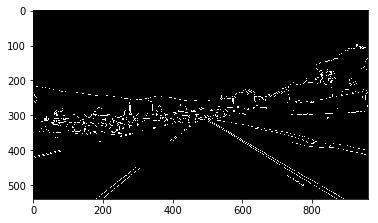

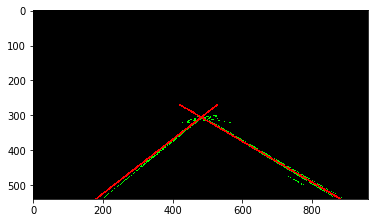

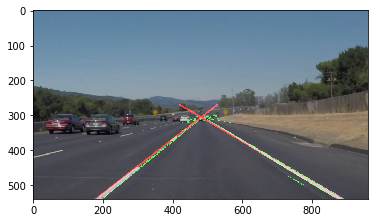

 82%|████████▏ | 183/222 [02:16<00:26,  1.46it/s]

[  -0.78297297  680.65823999]

[  0.59086125  19.00485897]



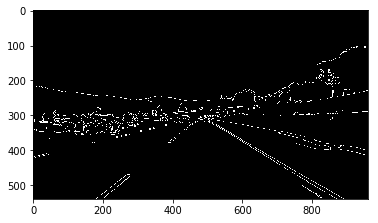

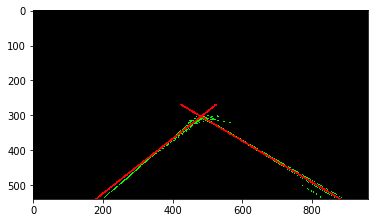

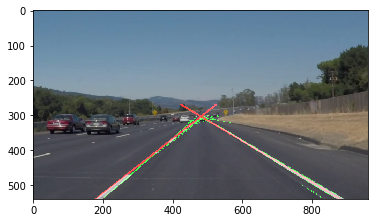

 83%|████████▎ | 184/222 [02:16<00:27,  1.38it/s]

[  -0.77564351  679.4776316 ]

[ 0.61812674 -1.31326833]



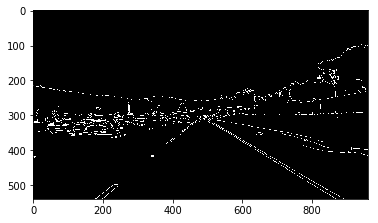

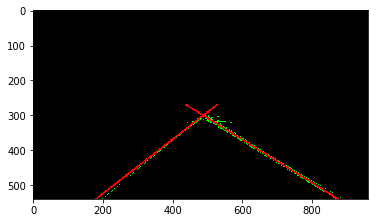

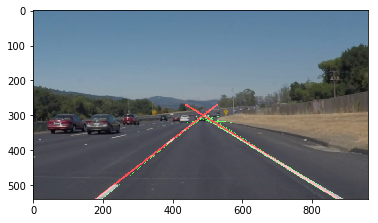

 83%|████████▎ | 185/222 [02:17<00:26,  1.37it/s]

[  -0.76396184  673.46373843]

[  0.59593744  14.45652952]



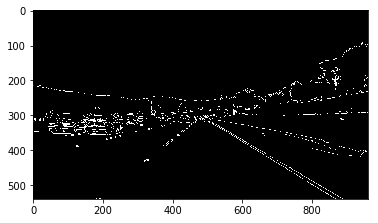

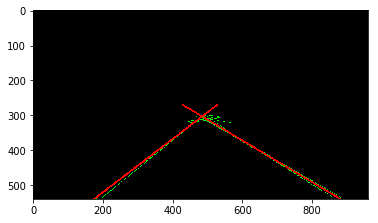

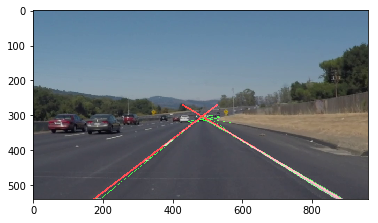

 84%|████████▍ | 186/222 [02:18<00:26,  1.36it/s]

[  -0.72820004  657.53966163]

[  0.58275185  24.15178215]



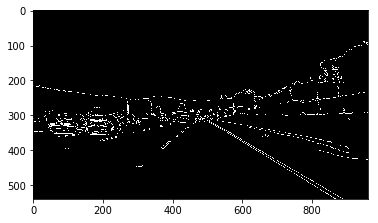

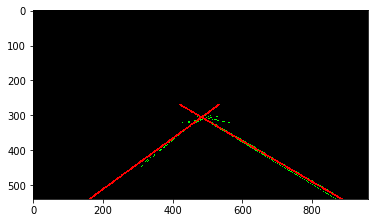

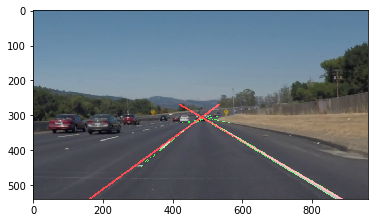

 84%|████████▍ | 187/222 [02:19<00:25,  1.35it/s]

[  -0.73180284  659.1896164 ]

[  0.5799891   24.13211061]



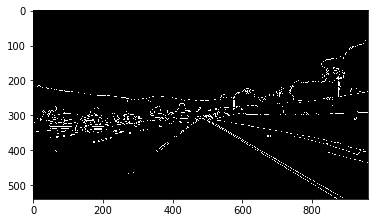

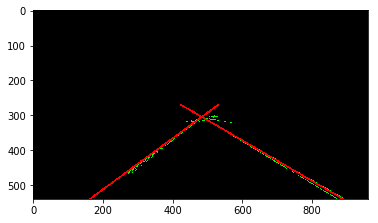

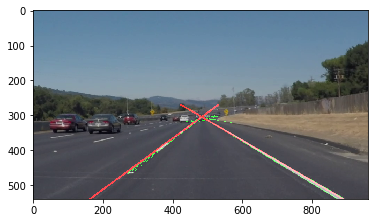

 85%|████████▍ | 188/222 [02:19<00:25,  1.31it/s]

[  -0.75252617  666.0605895 ]

[  0.57437254  24.31763794]



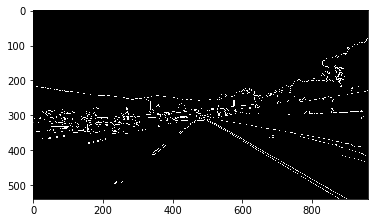

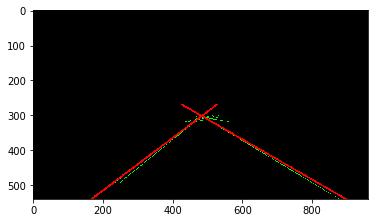

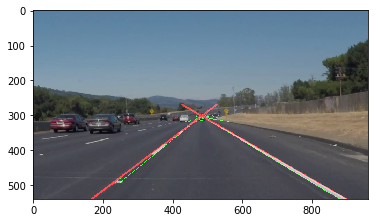

 85%|████████▌ | 189/222 [02:20<00:24,  1.36it/s]

[  -0.79270618  680.76891052]

[  0.58410826  16.69417929]



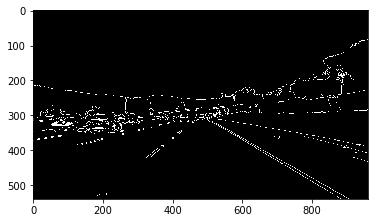

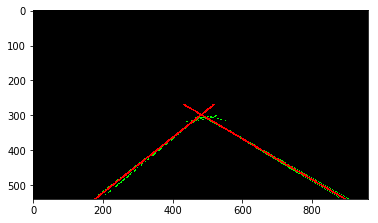

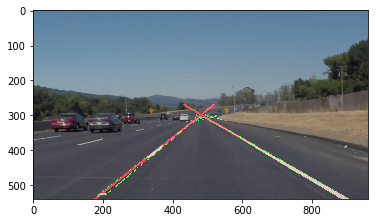

 86%|████████▌ | 190/222 [02:21<00:23,  1.36it/s]

[  -0.78321079  678.52085262]

[  0.55802158  35.47350139]



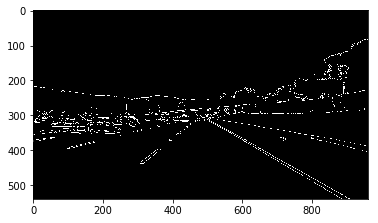

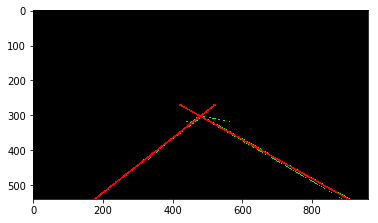

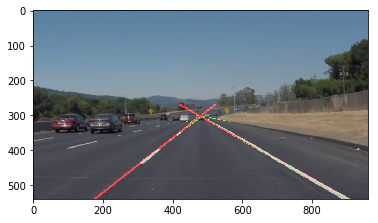

 86%|████████▌ | 191/222 [02:22<00:22,  1.35it/s]

[  -0.79820233  686.09494488]

[  0.55519763  37.31171743]



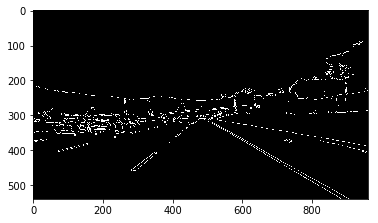

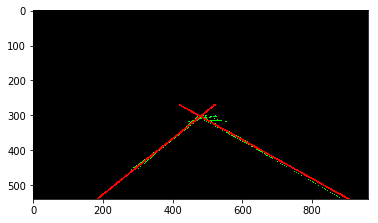

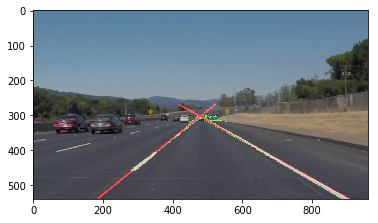

 86%|████████▋ | 192/222 [02:22<00:22,  1.32it/s]

[  -0.75925828  672.59331157]

[  0.58046608  22.36769532]



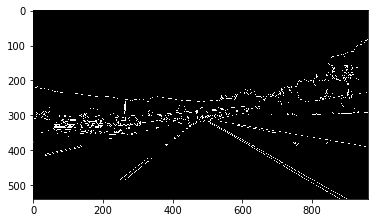

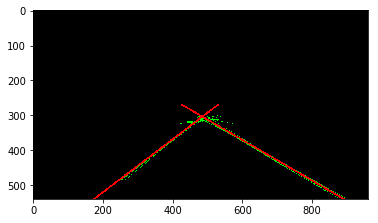

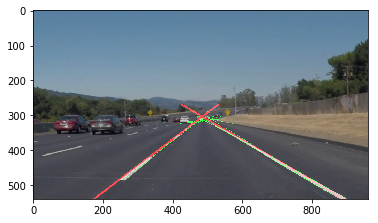

 87%|████████▋ | 193/222 [02:23<00:21,  1.33it/s]

[  -0.73594488  664.7262583 ]

[  0.57508035  27.5630492 ]



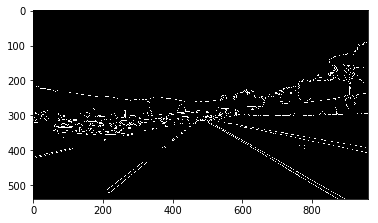

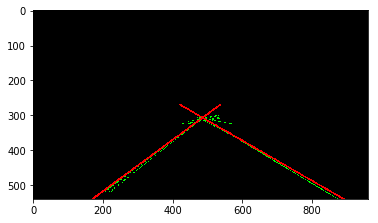

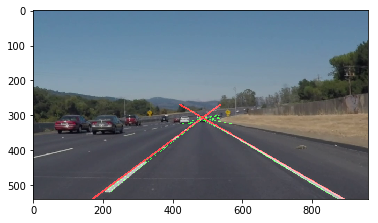

 87%|████████▋ | 194/222 [02:24<00:20,  1.38it/s]

[  -0.76883503  676.33425106]

[  0.58007512  25.68523949]



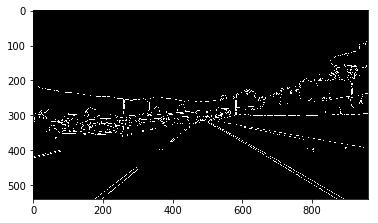

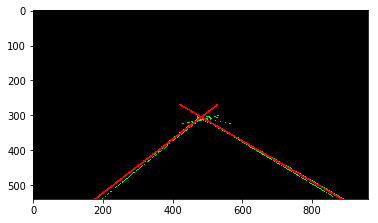

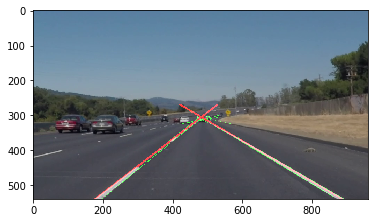

 88%|████████▊ | 195/222 [02:24<00:19,  1.40it/s]

[  -0.74643282  668.72261128]

[  0.58072694  26.30235579]



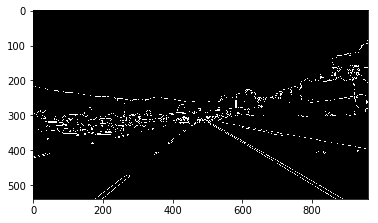

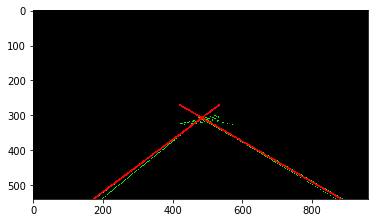

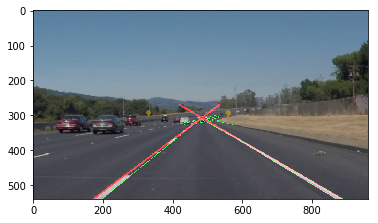

 88%|████████▊ | 196/222 [02:25<00:17,  1.46it/s]

[  -0.74461777  666.35228395]

[  0.58371619  24.43554972]



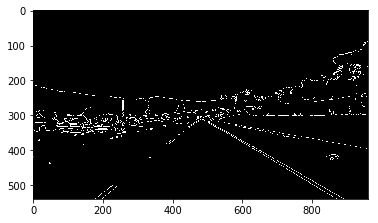

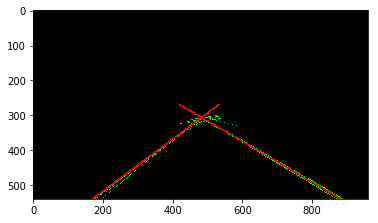

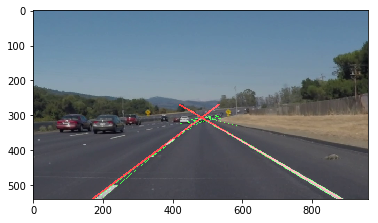

 89%|████████▊ | 197/222 [02:26<00:16,  1.50it/s]

[  -0.64568297  624.48074757]

[  0.58318877  23.92450976]



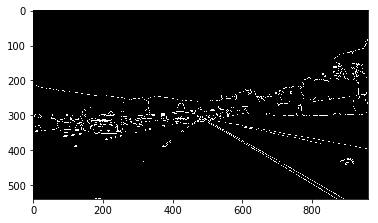

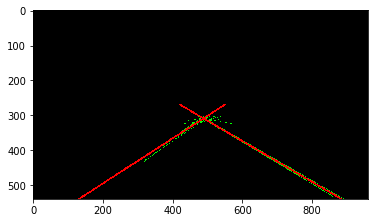

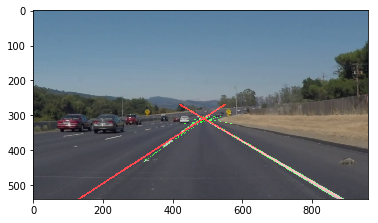

 89%|████████▉ | 198/222 [02:26<00:15,  1.53it/s]

[  -0.7389684   661.59289747]

[  0.56270387  36.70604984]



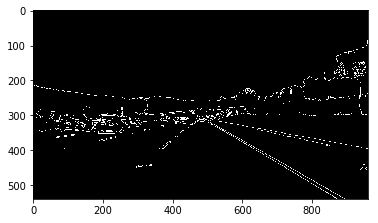

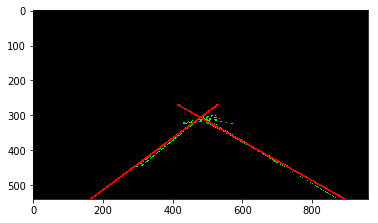

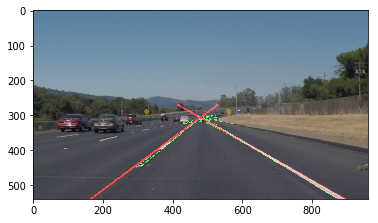

 90%|████████▉ | 199/222 [02:27<00:15,  1.50it/s]

[  -0.70717306  647.59139857]

[  0.58005251  25.49112511]



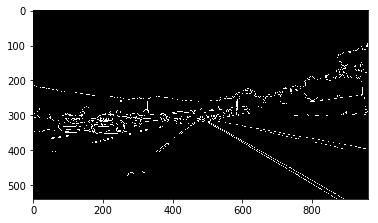

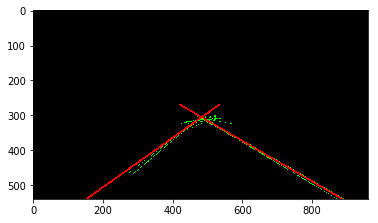

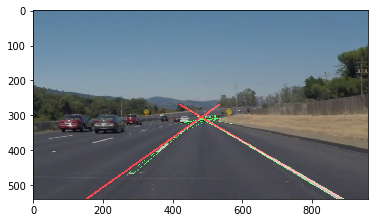

 90%|█████████ | 200/222 [02:28<00:15,  1.45it/s]

[  -0.72333016  658.69506173]

[  0.56622247  33.93096485]



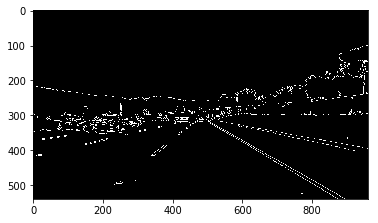

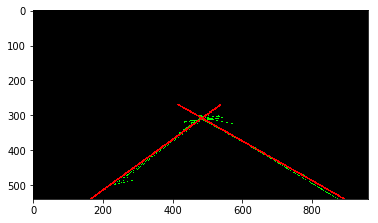

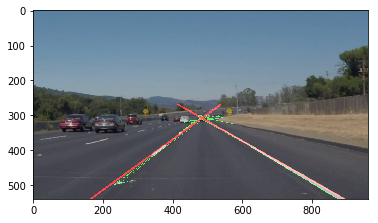

 91%|█████████ | 201/222 [02:28<00:13,  1.50it/s]

[  -0.74423753  664.51378619]

[  0.56835862  33.01378363]



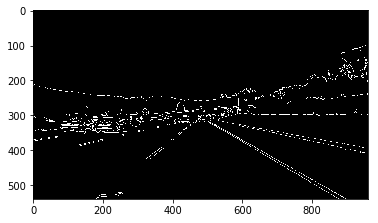

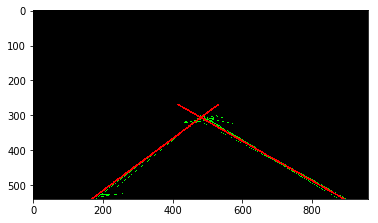

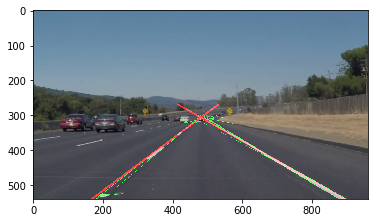

 91%|█████████ | 202/222 [02:29<00:13,  1.53it/s]

[  -0.78384878  682.12186988]

[  0.59242817  15.94495245]



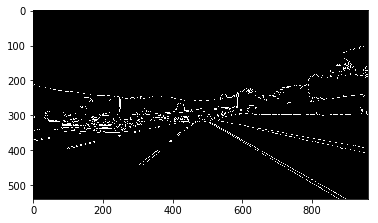

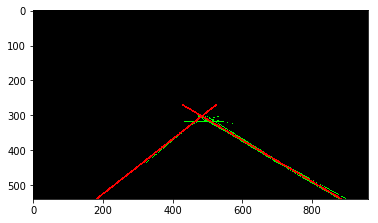

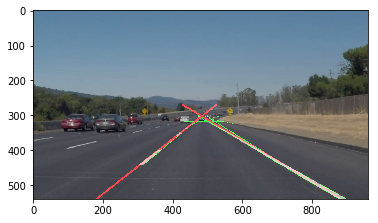

 91%|█████████▏| 203/222 [02:30<00:12,  1.51it/s]

[  -0.74349198  663.74493185]

[  0.57561006  25.70032   ]



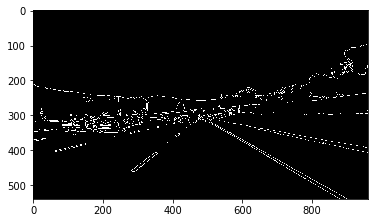

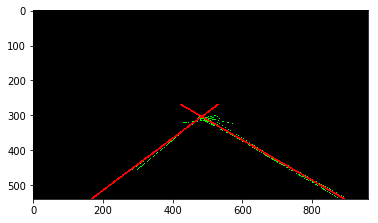

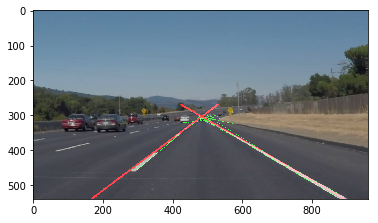

 92%|█████████▏| 204/222 [02:30<00:12,  1.45it/s]

[  -0.79468253  685.46534682]

[  0.5526168  40.0075647]



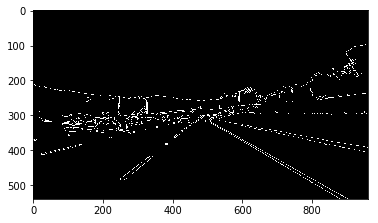

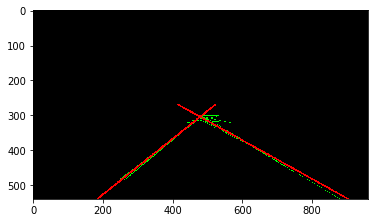

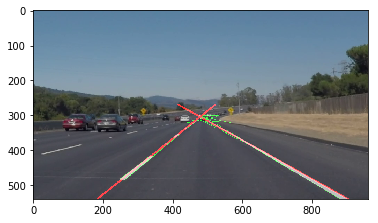

 92%|█████████▏| 205/222 [02:31<00:12,  1.41it/s]

[  -0.77967923  676.57100251]

[  0.56461289  32.67796267]



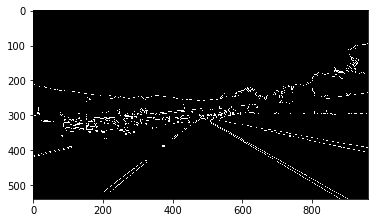

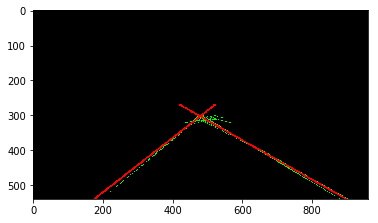

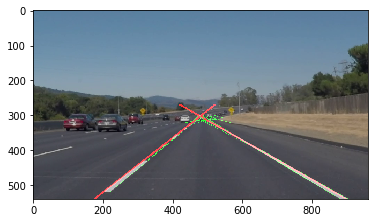

 93%|█████████▎| 206/222 [02:32<00:11,  1.37it/s]

[  -0.77621607  678.6799953 ]

[  0.55742041  36.85253598]



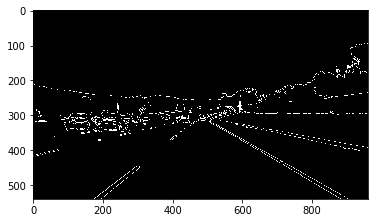

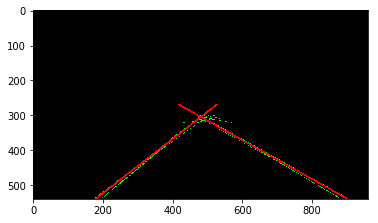

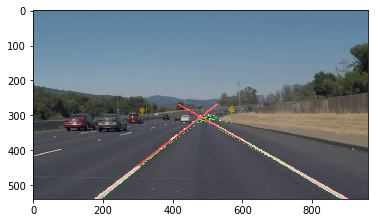

 93%|█████████▎| 207/222 [02:33<00:10,  1.43it/s]

[  -0.76166346  670.47515751]

[  0.56005086  35.12401291]



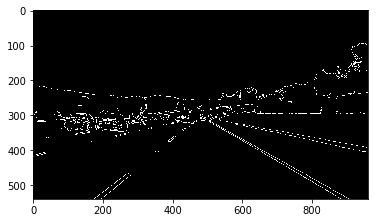

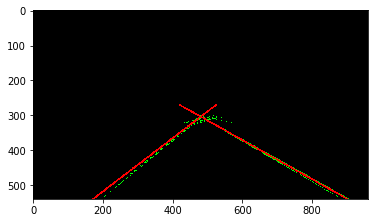

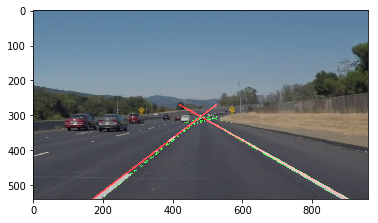

 94%|█████████▎| 208/222 [02:33<00:09,  1.47it/s]

[  -0.76328864  670.05839978]

[  0.56486001  32.46371897]



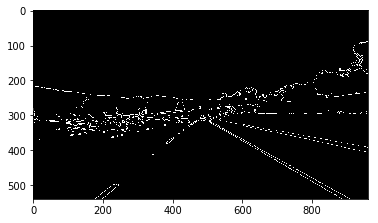

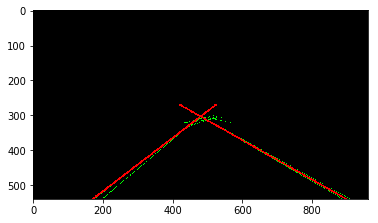

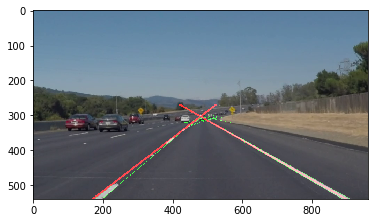

 94%|█████████▍| 209/222 [02:34<00:08,  1.49it/s]

[  -0.71716157  652.0653912 ]

[  0.55958787  35.30551354]



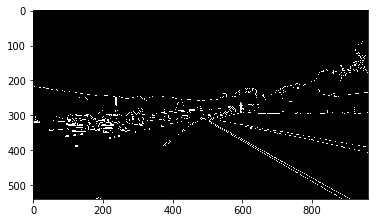

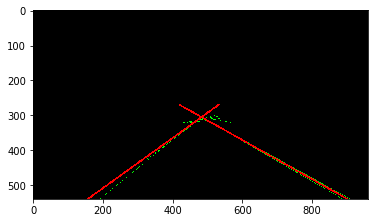

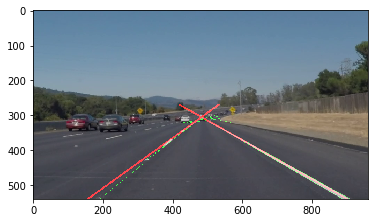

 95%|█████████▍| 210/222 [02:35<00:08,  1.48it/s]

[  -0.73771292  661.41603199]

[  0.55367908  38.16179663]



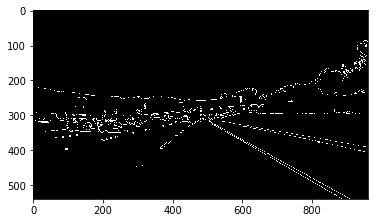

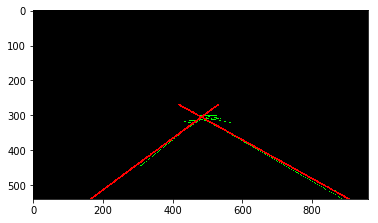

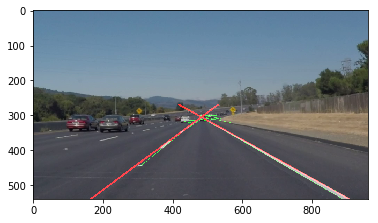

 95%|█████████▌| 211/222 [02:35<00:07,  1.52it/s]

[  -0.73074712  659.33156639]

[  0.56158451  35.55329908]



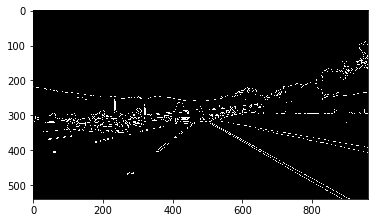

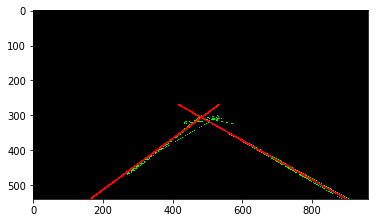

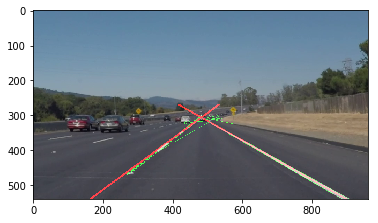

 95%|█████████▌| 212/222 [02:36<00:06,  1.46it/s]

[  -0.72684666  658.91728529]

[  0.55932729  37.55295569]



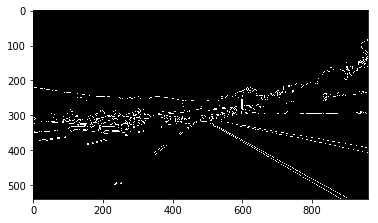

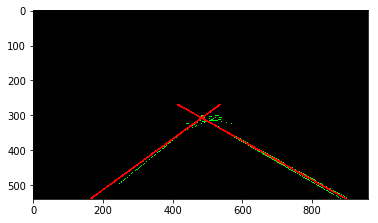

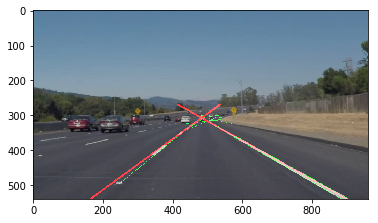

 96%|█████████▌| 213/222 [02:37<00:06,  1.42it/s]

[  -0.76031828  673.8814491 ]

[  0.55788974  38.99629628]



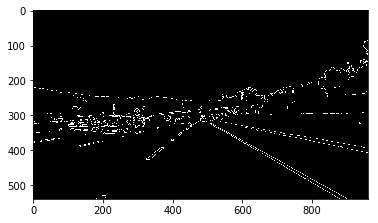

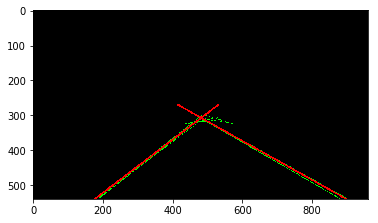

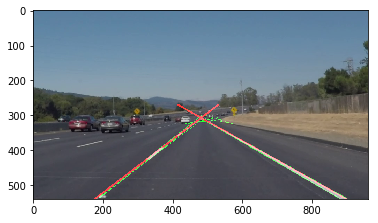

 96%|█████████▋| 214/222 [02:37<00:05,  1.38it/s]

[  -0.73567505  662.96462024]

[  0.55808452  39.36926899]



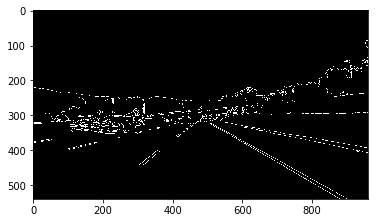

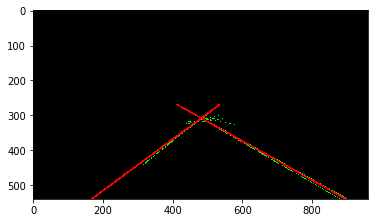

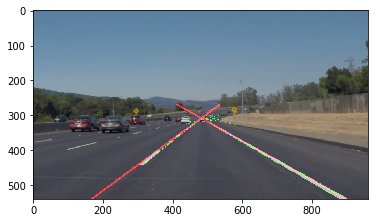

 97%|█████████▋| 215/222 [02:38<00:05,  1.39it/s]

[  -0.74417501  666.1018549 ]

[  0.5579751   40.27715669]



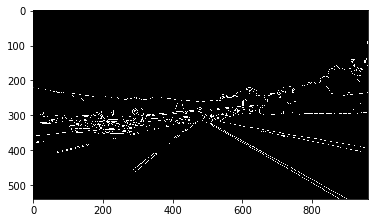

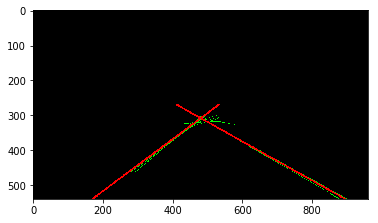

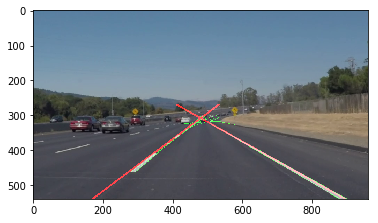

 97%|█████████▋| 216/222 [02:39<00:04,  1.44it/s]

[  -0.75643977  672.80657628]

[  0.5590243   39.76943634]



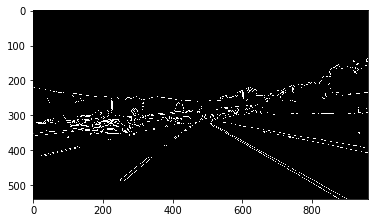

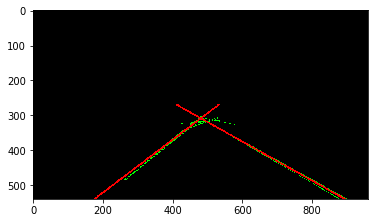

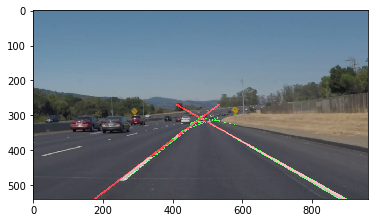

 98%|█████████▊| 217/222 [02:40<00:03,  1.43it/s]

[  -0.76631664  674.65449245]

[  0.55812041  40.66682608]



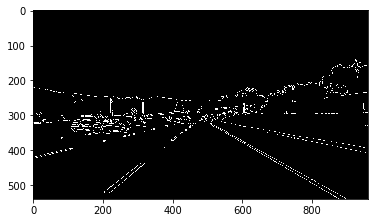

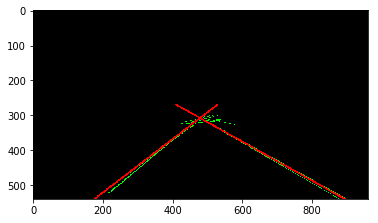

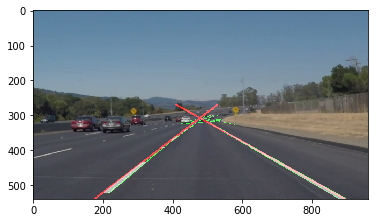

 98%|█████████▊| 218/222 [02:40<00:02,  1.38it/s]

[  -0.78428327  680.10317704]

[  0.55898746  40.28359704]



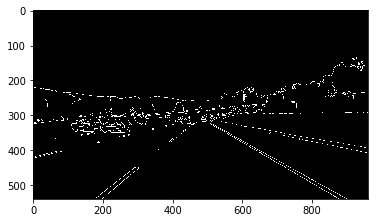

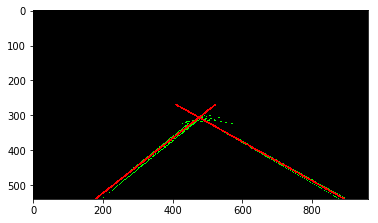

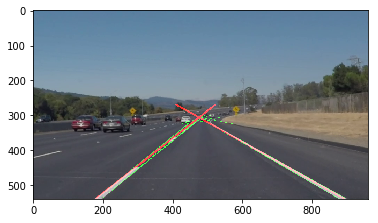

 99%|█████████▊| 219/222 [02:41<00:02,  1.35it/s]

[  -0.74266706  666.00166822]

[  0.55799191  40.28420309]



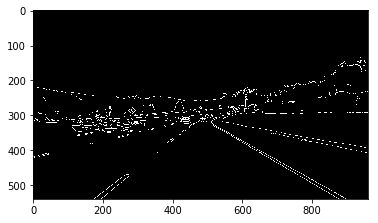

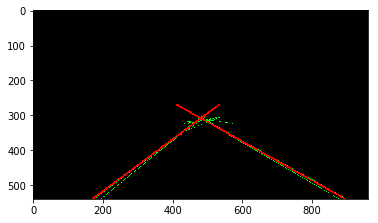

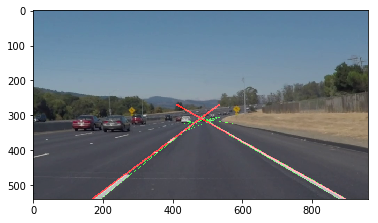

 99%|█████████▉| 220/222 [02:42<00:01,  1.27it/s]

[  -0.73222361  660.46281893]

[  0.56464749  37.13628956]



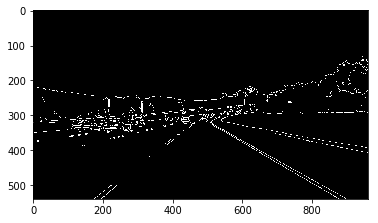

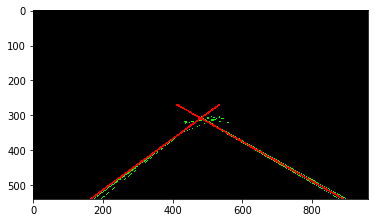

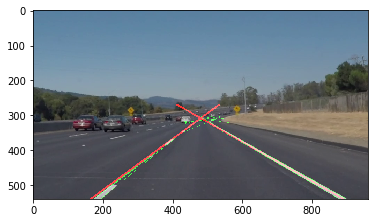

100%|█████████▉| 221/222 [02:43<00:00,  1.23it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: video_out/solidWhiteRight.mp4 

CPU times: user 3min 10s, sys: 3min 13s, total: 6min 23s
Wall time: 2min 44s


In [15]:
white_output = 'video_out/solidWhiteRight.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4")
## clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4")
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(white_output, audio=False)

Play the video inline, or if you prefer find the video in your filesystem (should be in the same directory) and play it in your video player of choice.

In [178]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(white_output))

## Improve the draw_lines() function

**At this point, if you were successful with making the pipeline and tuning parameters, you probably have the Hough line segments drawn onto the road, but what about identifying the full extent of the lane and marking it clearly as in the example video (P1_example.mp4)?  Think about defining a line to run the full length of the visible lane based on the line segments you identified with the Hough Transform. As mentioned previously, try to average and/or extrapolate the line segments you've detected to map out the full extent of the lane lines. You can see an example of the result you're going for in the video "P1_example.mp4".**

**Go back and modify your draw_lines function accordingly and try re-running your pipeline. The new output should draw a single, solid line over the left lane line and a single, solid line over the right lane line. The lines should start from the bottom of the image and extend out to the top of the region of interest.**

Now for the one with the solid yellow lane on the left. This one's more tricky!

In [ ]:
yellow_output = 'test_videos_output/solidYellowLeft.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
##clip2 = VideoFileClip('test_videos/solidYellowLeft.mp4').subclip(0,5)
clip2 = VideoFileClip('test_videos/solidYellowLeft.mp4')
yellow_clip = clip2.fl_image(process_image)
%time yellow_clip.write_videofile(yellow_output, audio=False)

In [ ]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(yellow_output))

## Writeup and Submission

If you're satisfied with your video outputs, it's time to make the report writeup in a pdf or markdown file. Once you have this Ipython notebook ready along with the writeup, it's time to submit for review! Here is a [link](https://github.com/udacity/CarND-LaneLines-P1/blob/master/writeup_template.md) to the writeup template file.


## Optional Challenge

Try your lane finding pipeline on the video below.  Does it still work?  Can you figure out a way to make it more robust?  If you're up for the challenge, modify your pipeline so it works with this video and submit it along with the rest of your project!

In [ ]:
challenge_output = 'test_videos_output/challenge.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
##clip3 = VideoFileClip('test_videos/challenge.mp4').subclip(0,5)
clip3 = VideoFileClip('test_videos/challenge.mp4')
challenge_clip = clip3.fl_image(process_image)
%time challenge_clip.write_videofile(challenge_output, audio=False)

In [ ]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(challenge_output))